<a href="https://colab.research.google.com/github/chebyshevtech/hybridselftalk/blob/main/ToTProtein.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Brute force library search

In [39]:
# ============================================================
# Install dependencies (run once in a notebook cell)
# ============================================================
!pip install py3Dmol requests tqdm

# ============================================================
# Imports
# ============================================================
import os
import re
from typing import Dict, List, Tuple, Optional

import requests
import py3Dmol
from tqdm.auto import tqdm

# ============================================================
# CONFIG
# ============================================================
PDB_SEQRES_PATH = "pdb_seqres.txt"   # your file
RECEPTOR_ID     = "101m_A"           # choose receptor chain (must exist in file)
MAX_LIGANDS     = 6000               # or int to cap number of ligands scanned

# ============================================================
# PARSE pdb_seqres.txt
# ============================================================
def parse_pdb_seqres(path: str) -> Dict[str, dict]:
    """
    Parse pdb_seqres.txt-like file into:
      {chain_id: {"mol": mol_type, "len": length, "desc": desc, "seq": sequence}}
    """
    records: Dict[str, dict] = {}
    header_re = re.compile(r"^(\S+)\s+mol:(\S+)\s+length:(\d+)\s*(.*)$")

    cid: Optional[str] = None
    mol = ""
    ln = 0
    desc = ""
    seq_lines: List[str] = []

    with open(path, "r") as f:
        for line in f:
            line = line.strip()
            if not line:
                continue

            if line.startswith(">"):
                # flush previous record
                if cid is not None and seq_lines:
                    records[cid] = {
                        "mol": mol.lower(),
                        "len": ln,
                        "desc": desc,
                        "seq": "".join(seq_lines),
                    }

                m = header_re.match(line[1:])
                if m:
                    cid, mol, ln_str, desc = m.groups()
                    ln = int(ln_str)
                    seq_lines = []
                else:
                    cid = line[1:].split()[0]
                    mol = "unknown"
                    ln = 0
                    desc = ""
                    seq_lines = []
            else:
                seq_lines.append(line)

    # flush last
    if cid is not None and seq_lines:
        records[cid] = {
            "mol": mol.lower(),
            "len": ln,
            "desc": desc,
            "seq": "".join(seq_lines),
        }

    return records

# ============================================================
# SEQUENCE-BASED BINDING SCORE
# ============================================================
AA20      = set("ACDEFGHIKLMNPQRSTVWY")
HYDRO     = set("AVILMFYW")
POLAR     = set("STNQCH")
POSITIVE  = set("KRH")
NEGATIVE  = set("DE")

def clean_protein(seq: str) -> str:
    """Keep only the 20 standard amino acids."""
    return "".join(c for c in seq.upper() if c in AA20)

def pair_score(a: str, b: str) -> float:
    """
    Simple heuristic:
      +2.0  opposite charges
      +1.0  both hydrophobic
      +0.5  both polar
      -1.0  same charge
      -0.2  otherwise
    """
    a = a.upper()
    b = b.upper()
    if (a in POSITIVE and b in NEGATIVE) or (a in NEGATIVE and b in POSITIVE):
        return 2.0
    if a in HYDRO and b in HYDRO:
        return 1.0
    if a in POLAR and b in POLAR:
        return 0.5
    if (a in POSITIVE and b in POSITIVE) or (a in NEGATIVE and b in NEGATIVE):
        return -1.0
    return -0.2

def binding_score(rec_seq: str, lig_seq: str) -> float:
    """
    Slide the shorter sequence along the longer, evaluate all alignments,
    normalize by overlap and penalize short overlaps.
    """
    R = clean_protein(rec_seq)
    L = clean_protein(lig_seq)
    if not R or not L:
        return -1e9

    if len(L) > len(R):
        R, L = L, R

    Lr, Ll = len(R), len(L)
    best = -1e9

    for shift in range(-Ll + 1, Lr):
        sr = max(0, shift)
        sl = max(0, -shift)
        overlap = min(Lr - sr, Ll - sl)
        if overlap <= 0:
            continue

        s = 0.0
        for k in range(overlap):
            s += pair_score(R[sr + k], L[sl + k])

        # average per position
        s_norm = s / overlap
        # penalize if overlap covers small fraction of either chain
        len_ratio = overlap / max(Lr, Ll)
        s_norm *= (0.5 + 0.5 * len_ratio)
        best = max(best, s_norm)

    return best

# ============================================================
# PICK BEST LIGAND
# ============================================================
def pick_best_ligand(
    receptor_id: str,
    records: Dict[str, dict],
    max_ligands: Optional[int] = None,
):
    if receptor_id not in records:
        raise ValueError(f"Receptor ID {receptor_id} not found in pdb_seqres.txt")

    rec_seq = records[receptor_id]["seq"]
    rec_seq = clean_protein(rec_seq)

    ligands: List[Tuple[str, str]] = [
        (cid, rec["seq"])
        for cid, rec in records.items()
        if cid != receptor_id and rec["mol"] == "protein"
    ]

    if max_ligands is not None:
        ligands = ligands[:max_ligands]

    if not ligands:
        raise RuntimeError("No protein ligands found to search over")

    print(f"Scanning {len(ligands)} protein ligands...")
    best_score = -1e9
    best_id = None
    best_seq = None

    for cid, seq in tqdm(ligands, desc="Ligands", unit="chain"):
        s = binding_score(rec_seq, seq)
        if s > best_score:
            best_score = s
            best_id = cid
            best_seq = seq

    return best_score, best_id, best_seq

# ============================================================
# FETCH PDB TEXT FROM RCSB
# ============================================================
def fetch_pdb_text(pdb_id: str) -> str:
    """
    Download PDB file text from RCSB for a given 4-letter ID.
    """
    pdb_id = pdb_id.upper()
    url = f"https://files.rcsb.org/download/{pdb_id}.pdb"
    resp = requests.get(url, timeout=30)
    if resp.status_code != 200 or not resp.text.strip():
        raise RuntimeError(
            f"Failed to download PDB {pdb_id} from RCSB (status {resp.status_code})"
        )
    return resp.text

# ============================================================
# VISUALIZATION WITH py3Dmol
# ============================================================
def show_receptor_ligand_pdb(rec_pdb: str, lig_pdb: str):
    """
    rec_pdb, lig_pdb are PDB IDs, e.g. '101m', '101d'.
    Use py3Dmol to render both in one scene.
    """
    pdb1_txt = fetch_pdb_text(rec_pdb)
    pdb2_txt = fetch_pdb_text(lig_pdb)

    view = py3Dmol.view(width=800, height=600)

    # receptor
    view.addModel(pdb1_txt, "pdb")
    view.setStyle({"model": 0}, {"cartoon": {"color": "spectrum"}})

    # ligand
    view.addModel(pdb2_txt, "pdb")
    view.setStyle({"model": 1}, {"cartoon": {"color": "cyan"}})

    view.zoomTo()
    view.spin(True)
    view.show()

# ============================================================
# MAIN PIPELINE
# ============================================================
if not os.path.isfile(PDB_SEQRES_PATH):
    raise FileNotFoundError(f"{PDB_SEQRES_PATH} not found in current directory")

print(f"Parsing {PDB_SEQRES_PATH}...")
records = parse_pdb_seqres(PDB_SEQRES_PATH)
print(f"Found {len(records)} chains total.")

if RECEPTOR_ID not in records:
    raise ValueError(f"Receptor chain {RECEPTOR_ID} not found.")

print(f"\nReceptor: {RECEPTOR_ID}")
print("  mol   :", records[RECEPTOR_ID]["mol"])
print("  len   :", records[RECEPTOR_ID]["len"])
print("  desc  :", records[RECEPTOR_ID]["desc"])

best_score, best_id, best_seq = pick_best_ligand(RECEPTOR_ID, records, MAX_LIGANDS)

print("\n=== BEST LIGAND RESULT ===")
print("Receptor chain :", RECEPTOR_ID)
print("Ligand chain   :", best_id)
print("Binding score  :", f"{best_score:.3f}")
print("Ligand length  :", len(clean_protein(best_seq)))
print("Ligand desc    :", records[best_id]["desc"])

# Derive PDB IDs (first part before underscore)
rec_pdb_id = RECEPTOR_ID.split("_")[0]
lig_pdb_id = best_id.split("_")[0]

print(f"\nUsing PDB IDs from chain IDs: receptor={rec_pdb_id}, ligand={lig_pdb_id}")
print("Rendering receptor + ligand in py3Dmol...")

show_receptor_ligand_pdb(rec_pdb_id, lig_pdb_id)


Parsing pdb_seqres.txt...
Found 1060737 chains total.

Receptor: 101m_A
  mol   : protein
  len   : 154
  desc  : MYOGLOBIN
Scanning 6000 protein ligands...


Ligands:   0%|          | 0/6000 [00:00<?, ?chain/s]


=== BEST LIGAND RESULT ===
Receptor chain : 101m_A
Ligand chain   : 1a30_C
Binding score  : 0.850
Ligand length  : 3
Ligand desc    : TRIPEPTIDE GLU-ASP-LEU

Using PDB IDs from chain IDs: receptor=101m, ligand=1a30
Rendering receptor + ligand in py3Dmol...


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

# ToTProtein seach

Loading ESM model: facebook/esm2_t12_35M_UR50D on cpu...


Some weights of EsmModel were not initialized from the model checkpoint at facebook/esm2_t12_35M_UR50D and are newly initialized: ['pooler.dense.bias', 'pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Parsing pdb_seqres.txt...


Asking to truncate to max_length but no maximum length is provided and the model has no predefined maximum length. Default to no truncation.


Found 1060737 chains total.

Receptor: 101m_A
  mol   : protein
  len   : 154
  desc  : MYOGLOBIN

Precomputing ESM embeddings for receptor + 500 ligands...


Ligand embeddings:   0%|          | 0/500 [00:00<?, ?chain/s]

Starting Protein ToT search over 500 ligands (max_nodes=300, branch=10)


Nodes:   0%|          | 0/300 [?node/s]

[d=0] V=0.000 facts=1 
[d=1] V=1.021 facts=3 
[d=2] V=0.703 facts=5 
[d=3] V=0.867 facts=7 
[d=4] V=0.944 facts=9 
[d=5] V=0.924 facts=11 
[d=6] V=0.797 facts=13 
[d=7] V=0.650 facts=15 
[d=8] V=0.697 facts=17 
[d=9] V=0.861 facts=19 
[d=10] V=0.790 facts=21 
[d=11] V=0.318 facts=23 
[d=12] V=0.592 facts=25 
[d=13] V=0.719 facts=27 
[d=14] V=0.570 facts=29 
[d=15] V=0.619 facts=31 
[d=16] V=0.705 facts=33 
[d=17] V=0.400 facts=35 
[d=18] V=0.666 facts=37 
[d=19] V=0.488 facts=39 
[d=20] V=0.574 facts=41 
[d=21] V=0.530 facts=43 
[d=22] V=0.552 facts=45 
[d=23] V=0.565 facts=47 
[d=24] V=0.359 facts=49 
[d=25] V=0.357 facts=50 
[d=26] V=0.467 facts=52 
[d=27] V=0.415 facts=54 
[d=28] V=0.278 facts=56 
[d=29] V=0.349 facts=58 

=== BEST LIGAND (ToT value function) ===
Receptor chain : 101m_A
Ligand chain   : 1a01_B
Score (ESM + heuristic) : 1.041
Ligand length  : 146
Ligand desc    : HEMOGLOBIN (BETA CHAIN)

Nodes evaluated: 300
Tree depth (max): 30

Plotting search tree...


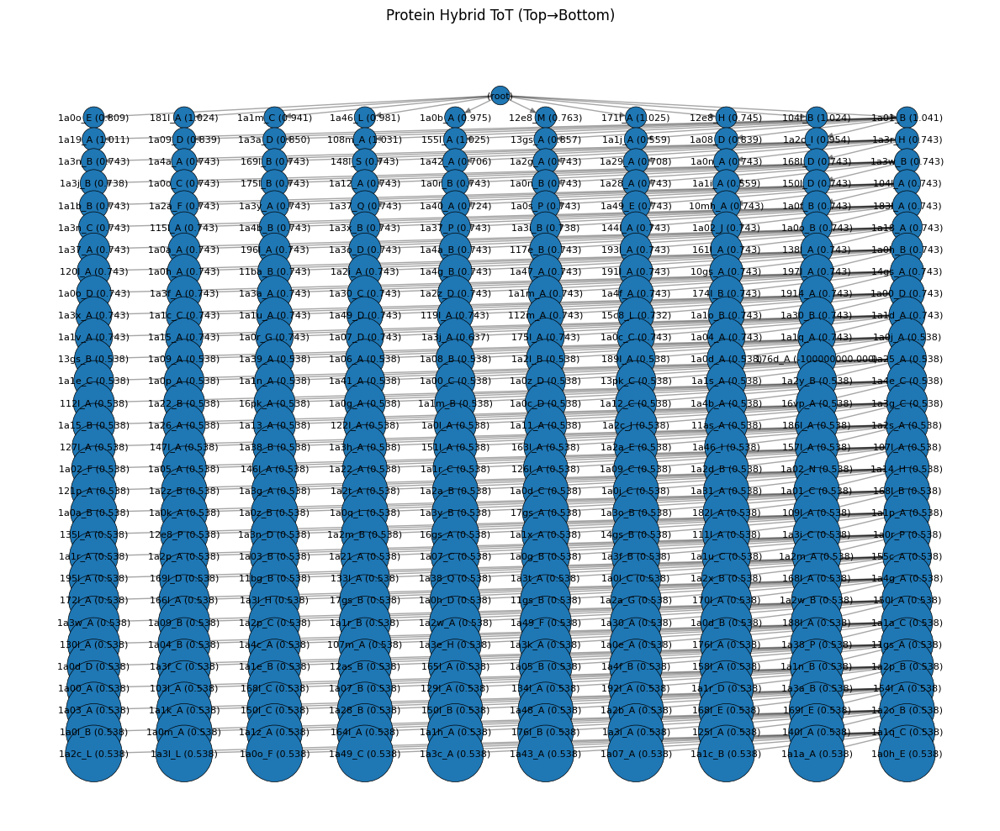


Using PDB IDs from chain IDs: receptor=101m, ligand=1a01
Rendering receptor + ligand in py3Dmol...


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [41]:
# ============================================================
# pip install transformers accelerate torch tqdm networkx matplotlib backoff
# pip install py3Dmol requests
# ============================================================

import os
import re
import math
import random
import gc
from dataclasses import dataclass
from typing import Dict, List, Tuple, Optional

import torch
from transformers import AutoTokenizer, AutoModel
from tqdm.auto import tqdm
import networkx as nx
import matplotlib.pyplot as plt
import requests
import py3Dmol

# ===========================
# CONFIG
# ===========================
PDB_SEQRES_PATH = "pdb_seqres.txt"       # your file
RECEPTOR_ID     = "101m_A"               # receptor chain ID
MAX_LIGANDS_TOT = 500                   # cap number of ligands in pool
ESM_MODEL_NAME  = os.getenv("ESM_MODEL", "facebook/esm2_t12_35M_UR50D")

DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
DEFAULT_SEED = 13

# ===========================
# SEEDING
# ===========================
def set_seed(seed: Optional[int]):
    if seed is None:
        return
    random.seed(seed)
    torch.manual_seed(seed)
    if torch.cuda.is_available():
        torch.cuda.manual_seed_all(seed)

# ===========================
# ESM MODEL
# ===========================
gc.collect()
if torch.cuda.is_available():
    torch.cuda.empty_cache()

print(f"Loading ESM model: {ESM_MODEL_NAME} on {DEVICE}...")
esm_tok = AutoTokenizer.from_pretrained(ESM_MODEL_NAME)
esm_mdl = AutoModel.from_pretrained(ESM_MODEL_NAME)
esm_mdl = esm_mdl.to(DEVICE).eval()

@torch.no_grad()
def esm_embed(seq: str) -> torch.Tensor:
    """
    Return a single embedding vector for an amino-acid sequence
    using ESM: average over residue embeddings.
    """
    seq = seq.strip()
    if len(seq) == 0:
        return torch.zeros(esm_mdl.config.hidden_size, device=DEVICE)

    # ESM models have a max length; respect tokenizer limit if set
    max_len = getattr(esm_tok, "model_max_length", 1022)
    if isinstance(max_len, int) and max_len > 0:
        seq = seq[: max_len - 2]  # room for special tokens

    enc = esm_tok(
        seq,
        return_tensors="pt",
        add_special_tokens=True,
        truncation=True,
    )
    enc = {k: v.to(DEVICE) for k, v in enc.items()}
    out = esm_mdl(**enc)
    reps = out.last_hidden_state  # [1, L, H]

    # Average over residue positions (ignore CLS/SEP if present)
    # For esm2 this is typically 1..L-1, but average all tokens is ok in practice
    emb = reps.mean(dim=1)[0]  # shape [H]
    return emb

def cosine_sim(a: torch.Tensor, b: torch.Tensor) -> float:
    a = a / (a.norm(p=2) + 1e-8)
    b = b / (b.norm(p=2) + 1e-8)
    return float(torch.dot(a, b).item())

# ===========================
# PARSE pdb_seqres.txt
# ===========================
def parse_pdb_seqres(path: str) -> Dict[str, dict]:
    """
    Parse pdb_seqres.txt-like file into:
      {chain_id: {"mol": mol_type, "len": length, "desc": desc, "seq": sequence}}
    """
    records: Dict[str, dict] = {}
    header_re = re.compile(r"^(\S+)\s+mol:(\S+)\s+length:(\d+)\s*(.*)$")

    cid: Optional[str] = None
    mol = ""
    ln = 0
    desc = ""
    seq_lines: List[str] = []

    with open(path, "r") as f:
        for line in f:
            line = line.strip()
            if not line:
                continue

            if line.startswith(">"):
                if cid is not None and seq_lines:
                    records[cid] = {
                        "mol": mol.lower(),
                        "len": ln,
                        "desc": desc,
                        "seq": "".join(seq_lines),
                    }

                m = header_re.match(line[1:])
                if m:
                    cid, mol, ln_str, desc = m.groups()
                    ln = int(ln_str)
                    seq_lines = []
                else:
                    cid = line[1:].split()[0]
                    mol = "unknown"
                    ln = 0
                    desc = ""
                    seq_lines = []
            else:
                seq_lines.append(line)

    if cid is not None and seq_lines:
        records[cid] = {
            "mol": mol.lower(),
            "len": ln,
            "desc": desc,
            "seq": "".join(seq_lines),
        }

    return records

# ===========================
# SIMPLE SEQUENCE BINDING SCORE
# (your heuristic, reused)
# ===========================
AA20      = set("ACDEFGHIKLMNPQRSTVWY")
HYDRO     = set("AVILMFYW")
POLAR     = set("STNQCH")
POSITIVE  = set("KRH")
NEGATIVE  = set("DE")

def clean_protein(seq: str) -> str:
    return "".join(c for c in seq.upper() if c in AA20)

def pair_score(a: str, b: str) -> float:
    a = a.upper()
    b = b.upper()
    if (a in POSITIVE and b in NEGATIVE) or (a in NEGATIVE and b in POSITIVE):
        return 2.0
    if a in HYDRO and b in HYDRO:
        return 1.0
    if a in POLAR and b in POLAR:
        return 0.5
    if (a in POSITIVE and b in POSITIVE) or (a in NEGATIVE and b in NEGATIVE):
        return -1.0
    return -0.2

def binding_score(rec_seq: str, lig_seq: str) -> float:
    R = clean_protein(rec_seq)
    L = clean_protein(lig_seq)
    if not R or not L:
        return -1e9

    if len(L) > len(R):
        R, L = L, R

    Lr, Ll = len(R), len(L)
    best = -1e9

    for shift in range(-Ll + 1, Lr):
        sr = max(0, shift)
        sl = max(0, -shift)
        overlap = min(Lr - sr, Ll - sl)
        if overlap <= 0:
            continue

        s = 0.0
        for k in range(overlap):
            s += pair_score(R[sr + k], L[sl + k])

        s_norm = s / overlap
        len_ratio = overlap / max(Lr, Ll)
        s_norm *= (0.5 + 0.5 * len_ratio)
        best = max(best, s_norm)

    return best

# ===========================
# TREE BOOK FOR VISUALIZATION
# ===========================
class TreeBook:
    def __init__(self):
        self.G = nx.DiGraph()
        self.next_id = 0
        self.attrs: Dict[int, Dict[str, object]] = {}
        self.info: Dict[int, Tuple[str, ...]] = {}

    def add_node(self, depth: int, label: str, info: Tuple[str, ...]) -> int:
        nid = self.next_id
        self.next_id += 1
        self.G.add_node(nid)
        self.attrs[nid] = {"depth": depth, "label": label}
        self.info[nid] = info
        return nid

    def add_edge(self, u: int, v: int):
        self.G.add_edge(u, v)

def _layered_tb(G, attrs):
    levels: Dict[int, List[int]] = {}
    for n in G.nodes():
        d = attrs[n]["depth"]
        levels.setdefault(d, []).append(n)
    pos = {}
    y_gap = 1.8
    x_gap = 1.6
    for d in sorted(levels.keys()):
        row = sorted(levels[d])
        width = (len(row) - 1) * x_gap
        for i, nid in enumerate(row):
            pos[nid] = (-width / 2 + i * x_gap, -d * y_gap)
    return pos

def plot_tree(tb: TreeBook, title="Protein ToT (Top→Bottom)"):
    if tb.G.number_of_nodes() == 0:
        print("[viz] Empty tree.")
        return
    pos = _layered_tb(tb.G, tb.attrs)
    colors, sizes, labels = [], [], {}
    for nid in tb.G.nodes():
        colors.append("#1f77b4")
        d = tb.attrs[nid]["depth"]
        sizes.append(260 + 70 * d)
        lbl = tb.attrs[nid]["label"] or "(root)"
        labels[nid] = (lbl[:42] + "…") if len(lbl) > 43 else lbl
    plt.figure(figsize=(12, 10))
    nx.draw_networkx_edges(
        tb.G, pos, alpha=0.35, arrows=True,
        arrowstyle="-|>", min_target_margin=8
    )
    nx.draw_networkx_nodes(
        tb.G, pos, node_color=colors,
        node_size=sizes, linewidths=0.5, edgecolors="k"
    )
    nx.draw_networkx_labels(tb.G, pos, labels=labels, font_size=8)
    plt.title(title)
    plt.axis("off")
    plt.tight_layout()
    plt.show()

# ===========================
# ToT HYPERPARAMS
# ===========================
@dataclass
class P:
    max_depth: int = 5
    max_nodes: int = 300       # total ligand evaluations
    branch: int = 10           # children per node
    alpha_esm: float = 1.0     # weight for ESM cosine sim
    beta_bind: float = 0.1     # weight for heuristic binding_score
    depth_penalty: float = 0.02

@dataclass
class Node:
    nid: int
    info: Tuple[str, ...]
    depth: int
    value: float
    parent: float

# ===========================
# PROTEIN ToT SEARCH
# ===========================
class ProteinToT:
    def __init__(
        self,
        receptor_id: str,
        records: Dict[str, dict],
        lig_ids: List[str],
        rec_emb: torch.Tensor,
        lig_embs: Dict[str, torch.Tensor],
        p: P,
    ):
        self.receptor_id = receptor_id
        self.records = records
        self.lig_ids = lig_ids
        self.rec_seq = records[receptor_id]["seq"]
        self.rec_emb = rec_emb
        self.lig_embs = lig_embs
        self.p = p

        self.tb = TreeBook()
        self.nodes_evaluated = 0
        self.visited_ligs = set()

    def _score_ligand(self, lig_id: str) -> float:
        seq = self.records[lig_id]["seq"]
        emb = self.lig_embs[lig_id]
        cos = cosine_sim(self.rec_emb, emb)
        bind = binding_score(self.rec_seq, seq)
        return self.p.alpha_esm * cos + self.p.beta_bind * bind

    def _value(self, score: float, depth: int) -> float:
        return score - self.p.depth_penalty * depth

    def _canon(self, infos: List[str]) -> Tuple[str, ...]:
        out, seen = [], set()
        for s in infos:
            t = s.strip()
            k = t.lower()
            if t and k not in seen:
                seen.add(k)
                out.append(t[:240])
        return tuple(sorted(out))

    def _expand(self, node: Node) -> List[Tuple[float, str, Tuple[str, ...]]]:
        remaining = [cid for cid in self.lig_ids if cid not in self.visited_ligs]
        if not remaining:
            return []
        random.shuffle(remaining)
        kids = []
        for lig_id in remaining[: self.p.branch]:
            score = self._score_ligand(lig_id)
            val = self._value(score, node.depth + 1)
            info = self._canon(list(node.info) + [
                f"LIG={lig_id}",
                f"SCORE={score:.4f}",
            ])
            kids.append((val, lig_id, info))
        return kids

    def solve(self, seed: Optional[int] = DEFAULT_SEED):
        set_seed(seed)

        root_info = self._canon([f"RECEPTOR={self.receptor_id}"])
        root_nid = self.tb.add_node(depth=0, label="(root)", info=root_info)
        self.tb.attrs[root_nid]["value"] = 0.0
        root = Node(nid=root_nid, info=root_info, depth=0, value=0.0, parent=-1e9)

        stack = [root]
        best_lig = None
        best_score = -1e9

        print(
            f"Starting Protein ToT search over {len(self.lig_ids)} ligands "
            f"(max_nodes={self.p.max_nodes}, branch={self.p.branch})"
        )

        with tqdm(
            total=self.p.max_nodes,
            desc="Nodes",
            unit="node",
            bar_format="{l_bar}{bar}| {n_fmt}/{total_fmt} [{rate_fmt}]",
        ) as pbar:
            while stack and self.nodes_evaluated < self.p.max_nodes:
                node = stack.pop()

                depth = node.depth
                if self.nodes_evaluated % 10 == 0:
                    print(
                        f"[d={depth}] V={node.value:.3f} "
                        f"facts={len(node.info)} "
                    )

                children = self._expand(node)
                if not children:
                    continue

                for val, lig_id, info in children:
                    if self.nodes_evaluated >= self.p.max_nodes:
                        break

                    self.visited_ligs.add(lig_id)
                    score_line = [s for s in info if s.startswith("SCORE=") or "SCORE=" in s]
                    raw_score = None
                    if score_line:
                        try:
                            raw_score = float(score_line[0].split("=")[1])
                        except Exception:
                            raw_score = None

                    if raw_score is not None and raw_score > best_score:
                        best_score = raw_score
                        best_lig = lig_id

                    label = f"{lig_id} ({raw_score:.3f})" if raw_score is not None else lig_id
                    child_nid = self.tb.add_node(
                        depth=depth + 1,
                        label=label,
                        info=info,
                    )
                    self.tb.attrs[child_nid]["value"] = val
                    self.tb.add_edge(node.nid, child_nid)

                    child = Node(
                        nid=child_nid,
                        info=info,
                        depth=depth + 1,
                        value=val,
                        parent=node.value,
                    )
                    stack.append(child)

                    self.nodes_evaluated += 1
                    pbar.update(1)

        return {
            "best_ligand": best_lig,
            "best_score": best_score,
            "tree": self.tb,
            "nodes": self.nodes_evaluated,
        }

# ===========================
# PDB FETCH + VISUALIZATION
# ===========================
def fetch_pdb_text(pdb_id: str) -> str:
    pdb_id = pdb_id.upper()
    url = f"https://files.rcsb.org/download/{pdb_id}.pdb"
    resp = requests.get(url, timeout=30)
    if resp.status_code != 200 or not resp.text.strip():
        raise RuntimeError(
            f"Failed to download PDB {pdb_id} from RCSB (status {resp.status_code})"
        )
    return resp.text

def show_receptor_ligand_pdb(rec_pdb: str, lig_pdb: str):
    pdb1_txt = fetch_pdb_text(rec_pdb)
    pdb2_txt = fetch_pdb_text(lig_pdb)

    view = py3Dmol.view(width=800, height=600)

    view.addModel(pdb1_txt, "pdb")
    view.setStyle({"model": 0}, {"cartoon": {"color": "spectrum"}})

    view.addModel(pdb2_txt, "pdb")
    view.setStyle({"model": 1}, {"cartoon": {"color": "cyan"}})

    view.zoomTo()
    view.spin(True)
    return view

# ===========================
# MAIN PIPELINE
# ===========================
if __name__ == "__main__":
    if not os.path.isfile(PDB_SEQRES_PATH):
        raise FileNotFoundError(f"{PDB_SEQRES_PATH} not found in current directory")

    print(f"Parsing {PDB_SEQRES_PATH}...")
    records = parse_pdb_seqres(PDB_SEQRES_PATH)
    print(f"Found {len(records)} chains total.")

    if RECEPTOR_ID not in records:
        raise ValueError(f"Receptor chain {RECEPTOR_ID} not found.")

    print(f"\nReceptor: {RECEPTOR_ID}")
    print("  mol   :", records[RECEPTOR_ID]["mol"])
    print("  len   :", records[RECEPTOR_ID]["len"])
    print("  desc  :", records[RECEPTOR_ID]["desc"])

    ligands = [
        cid for cid, rec in records.items()
        if cid != RECEPTOR_ID and rec["mol"] == "protein"
    ]
    if MAX_LIGANDS_TOT is not None:
        ligands = ligands[:MAX_LIGANDS_TOT]

    if not ligands:
        raise RuntimeError("No protein ligands found to search over")

    print(f"\nPrecomputing ESM embeddings for receptor + {len(ligands)} ligands...")
    rec_seq = clean_protein(records[RECEPTOR_ID]["seq"])
    rec_emb = esm_embed(rec_seq)

    lig_embs: Dict[str, torch.Tensor] = {}
    for cid in tqdm(ligands, desc="Ligand embeddings", unit="chain"):
        seq = clean_protein(records[cid]["seq"])
        lig_embs[cid] = esm_embed(seq)

    params = P(
        max_depth=5,
        max_nodes=300,
        branch=10,
        alpha_esm=1.0,
        beta_bind=0.1,
        depth_penalty=0.02,
    )
    solver = ProteinToT(
        receptor_id=RECEPTOR_ID,
        records=records,
        lig_ids=ligands,
        rec_emb=rec_emb,
        lig_embs=lig_embs,
        p=params,
    )
    res = solver.solve(seed=DEFAULT_SEED)

    best_lig = res["best_ligand"]
    best_score = res["best_score"]
    tb = res["tree"]

    print("\n=== BEST LIGAND (ToT value function) ===")
    print("Receptor chain :", RECEPTOR_ID)
    print("Ligand chain   :", best_lig)
    print("Score (ESM + heuristic) :", f"{best_score:.3f}")
    if best_lig is not None:
        print("Ligand length  :", len(clean_protein(records[best_lig]["seq"])))
        print("Ligand desc    :", records[best_lig]["desc"])

    print("\nNodes evaluated:", res["nodes"])
    print("Tree depth (max):", max(tb.attrs[n]["depth"] for n in tb.G.nodes()))

    print("\nPlotting search tree...")
    plot_tree(tb, title="Protein Hybrid ToT (Top→Bottom)")

    if best_lig is not None:
        rec_pdb_id = RECEPTOR_ID.split("_")[0]
        lig_pdb_id = best_lig.split("_")[0]
        print(
            f"\nUsing PDB IDs from chain IDs: receptor={rec_pdb_id}, ligand={lig_pdb_id}"
        )
        print("Rendering receptor + ligand in py3Dmol...")
        view = show_receptor_ligand_pdb(rec_pdb_id, lig_pdb_id)
        view.show()


In [43]:
# ============================================
# Compare ToT ligand under old binding metric
# ============================================
if best_lig is not None:
    rec_seq_old = clean_protein(records[RECEPTOR_ID]["seq"])
    lig_seq_old = clean_protein(records[best_lig]["seq"])
    old_binding = binding_score(rec_seq_old, lig_seq_old)

    print("\n=== BEST LIGAND RESULT (old binding metric) ===")
    print("Receptor chain :", RECEPTOR_ID)
    print("Ligand chain   :", best_lig)
    print("Binding score  :", f"{old_binding:.3f}")
    print("Ligand length  :", len(lig_seq_old))
    print("Ligand desc    :", records[best_lig]["desc"])
else:
    print("No best_lig from ToT to evaluate with old metric.")



=== BEST LIGAND RESULT (old binding metric) ===
Receptor chain : 101m_A
Ligand chain   : 1a01_B
Binding score  : 0.545
Ligand length  : 146
Ligand desc    : HEMOGLOBIN (BETA CHAIN)


In [44]:
# ============================================
# Evaluate old best ligand under new metric
# ============================================
old_lig = "1a30_C"   # the old best-result ligand

if old_lig in records:
    # clean sequences
    rec_seq_new = clean_protein(records[RECEPTOR_ID]["seq"])
    lig_seq_new = clean_protein(records[old_lig]["seq"])

    # fetch embeddings
    lig_emb = lig_embs[old_lig]

    # compute ESM cosine similarity
    cos_score = cosine_sim(rec_emb, lig_emb)

    # compute heuristic binding score
    bind_score = binding_score(rec_seq_new, lig_seq_new)

    # combine using current ToT scoring weights
    new_score = params.alpha_esm * cos_score + params.beta_bind * bind_score

    print("\n=== OLD LIGAND EVALUATED UNDER NEW METRIC ===")
    print("Receptor chain :", RECEPTOR_ID)
    print("Ligand chain   :", old_lig)
    print("ESM cosine sim :", f"{cos_score:.3f}")
    print("Heuristic bind :", f"{bind_score:.3f}")
    print("Combined score :", f"{new_score:.3f}")
    print("Ligand length  :", len(lig_seq_new))
    print("Ligand desc    :", records[old_lig]["desc"])
else:
    print(f"Ligand {old_lig} not found in records.")



=== OLD LIGAND EVALUATED UNDER NEW METRIC ===
Receptor chain : 101m_A
Ligand chain   : 1a30_C
ESM cosine sim : 0.815
Heuristic bind : 0.850
Combined score : 0.900
Ligand length  : 3
Ligand desc    : TRIPEPTIDE GLU-ASP-LEU


#Consistent lhs=rhs Value function

Loading ESM model: facebook/esm2_t12_35M_UR50D on cpu...


Some weights of EsmModel were not initialized from the model checkpoint at facebook/esm2_t12_35M_UR50D and are newly initialized: ['pooler.dense.bias', 'pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
Asking to truncate to max_length but no maximum length is provided and the model has no predefined maximum length. Default to no truncation.


Parsing pdb_seqres.txt...
Found 29844 chains total.

Receptor: 101m_A
  mol   : protein
  len   : 154
  desc  : MYOGLOBIN

Precomputing ESM embeddings for receptor + 3000 ligands...


Ligand embeddings:   0%|          | 0/3000 [00:00<?, ?chain/s]

Starting Protein ToT search over 3000 ligands (max_nodes=300, branch=10)


Nodes:   0%|          | 0/300 [?node/s]

Streaming output truncated to the last 5000 lines.
    EQ_BIND = 0.506494
    EQ_CONSIST = 0.585783
    EQ_CONSIST = 0.636045
    EQ_CONSIST = 0.655753
    EQ_CONSIST = 0.694186
    EQ_CONSIST = 0.698646
    EQ_ESM = 0.848481
    EQ_ESM = 0.859596
    EQ_ESM = 0.916687
    EQ_ESM = 0.955883
    EQ_ESM = 0.974261
    EQ_TOTAL = 1.247986
    EQ_TOTAL = 1.257339
    EQ_TOTAL = 1.274404
    EQ_TOTAL = 1.291021
    EQ_TOTAL = 1.342588
[Node nid=53 d=5] V=1.148 LIG=1b5t_A | facts=26
    EQ_BIND = 0.243771
    EQ_BIND = 0.256292
    EQ_BIND = 0.464567
    EQ_BIND = 0.501818
    EQ_BIND = 0.506494
    EQ_CONSIST = 0.585783
    EQ_CONSIST = 0.598597
    EQ_CONSIST = 0.655753
    EQ_CONSIST = 0.694186
    EQ_CONSIST = 0.698646
    EQ_ESM = 0.848481
    EQ_ESM = 0.859596
    EQ_ESM = 0.916687
    EQ_ESM = 0.924092
    EQ_ESM = 0.955883
    EQ_TOTAL = 1.247767
    EQ_TOTAL = 1.247986
    EQ_TOTAL = 1.257339
    EQ_TOTAL = 1.274404
    EQ_TOTAL = 1.291021
[Node nid=52 d=5] V=1.091 LIG=1b5t_A | fact

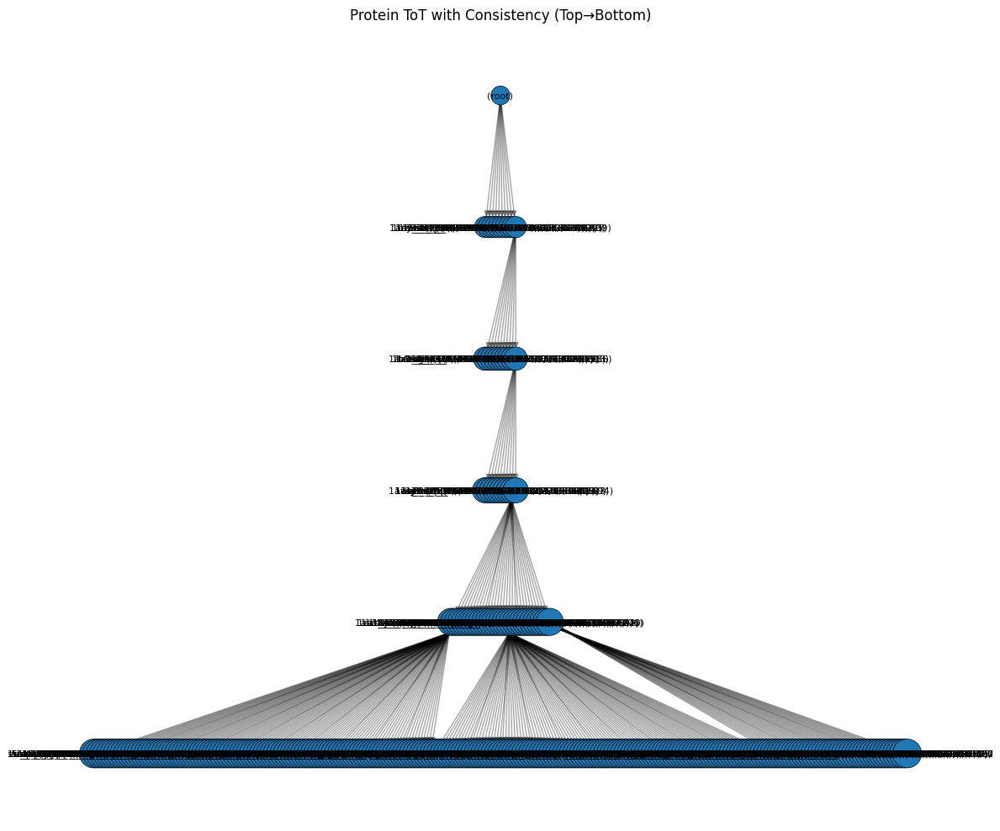


Using PDB IDs from chain IDs: receptor=101m, ligand=1a00
Rendering receptor + ligand in py3Dmol...


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [4]:
# ============================================================
# Protein–Protein ToT Search with ESM + Consistency Value Function
# - Given receptor chain ID, search ligands using Tree-of-Thought-style search.
# - Value function combines ESM similarity, heuristic binding score, and
#   a consistency term between them, with EQ-style facts logged per node.
# - Prints:
#     * Per-node "thinking" summaries
#     * Top supporting nodes ("vote source lines") for best ligand
#     * Facts containing 'EQ' on the best path
#     * 3D visualization of receptor + best ligand
# ============================================================

# pip install transformers accelerate torch tqdm networkx matplotlib backoff
# pip install py3Dmol requests

import os
import re
import math
import random
import gc
from dataclasses import dataclass
from typing import Dict, List, Tuple, Optional

import torch
from transformers import AutoTokenizer, AutoModel
from tqdm.auto import tqdm
import networkx as nx
import matplotlib.pyplot as plt
import requests
import py3Dmol

# ===========================
# CONFIG
# ===========================
PDB_SEQRES_PATH = "pdb_seqres.txt"       # your SEQRES file
RECEPTOR_ID     = "101m_A"               # receptor chain ID
MAX_LIGANDS_TOT = 3000                   # cap number of ligands in pool
ESM_MODEL_NAME  = os.getenv("ESM_MODEL", "facebook/esm2_t12_35M_UR50D")

DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
DEFAULT_SEED = 13

# ===========================
# SEEDING
# ===========================
def set_seed(seed: Optional[int]):
    if seed is None:
        return
    random.seed(seed)
    torch.manual_seed(seed)
    if torch.cuda.is_available():
        torch.cuda.manual_seed_all(seed)

# ===========================
# ESM MODEL
# ===========================
gc.collect()
if torch.cuda.is_available():
    torch.cuda.empty_cache()

print(f"Loading ESM model: {ESM_MODEL_NAME} on {DEVICE}...")
esm_tok = AutoTokenizer.from_pretrained(ESM_MODEL_NAME)
esm_mdl = AutoModel.from_pretrained(ESM_MODEL_NAME)
esm_mdl = esm_mdl.to(DEVICE).eval()

@torch.no_grad()
def esm_embed(seq: str) -> torch.Tensor:
    """
    Return a single embedding vector for an amino-acid sequence
    using ESM: average over residue embeddings.
    """
    seq = seq.strip()
    if len(seq) == 0:
        return torch.zeros(esm_mdl.config.hidden_size, device=DEVICE)

    max_len = getattr(esm_tok, "model_max_length", 1022)
    if isinstance(max_len, int) and max_len > 0:
        seq = seq[: max_len - 2]  # keep margin for special tokens

    enc = esm_tok(
        seq,
        return_tensors="pt",
        add_special_tokens=True,
        truncation=True,
    )
    enc = {k: v.to(DEVICE) for k, v in enc.items()}
    out = esm_mdl(**enc)
    reps = out.last_hidden_state  # [1, L, H]
    emb = reps.mean(dim=1)[0]     # [H]
    return emb

def cosine_sim(a: torch.Tensor, b: torch.Tensor) -> float:
    a = a / (a.norm(p=2) + 1e-8)
    b = b / (b.norm(p=2) + 1e-8)
    return float(torch.dot(a, b).item())

# ===========================
# PARSE pdb_seqres.txt
# ===========================
def parse_pdb_seqres(path: str) -> Dict[str, dict]:
    """
    Parse pdb_seqres.txt-like file into:
      {chain_id: {"mol": mol_type, "len": length, "desc": desc, "seq": sequence}}
    """
    records: Dict[str, dict] = {}
    header_re = re.compile(r"^(\S+)\s+mol:(\S+)\s+length:(\d+)\s*(.*)$")

    cid: Optional[str] = None
    mol = ""
    ln = 0
    desc = ""
    seq_lines: List[str] = []

    with open(path, "r") as f:
        for line in f:
            line = line.strip()
            if not line:
                continue

            if line.startswith(">"):
                if cid is not None and seq_lines:
                    records[cid] = {
                        "mol": mol.lower(),
                        "len": ln,
                        "desc": desc,
                        "seq": "".join(seq_lines),
                    }

                m = header_re.match(line[1:])
                if m:
                    cid, mol, ln_str, desc = m.groups()
                    ln = int(ln_str)
                    seq_lines = []
                else:
                    cid = line[1:].split()[0]
                    mol = "unknown"
                    ln = 0
                    desc = ""
                    seq_lines = []
            else:
                seq_lines.append(line)

    if cid is not None and seq_lines:
        records[cid] = {
            "mol": mol.lower(),
            "len": ln,
            "desc": desc,
            "seq": "".join(seq_lines),
        }

    return records

# ===========================
# SIMPLE SEQUENCE BINDING SCORE
# ===========================
AA20      = set("ACDEFGHIKLMNPQRSTVWY")
HYDRO     = set("AVILMFYW")
POLAR     = set("STNQCH")
POSITIVE  = set("KRH")
NEGATIVE  = set("DE")

def clean_protein(seq: str) -> str:
    return "".join(c for c in seq.upper() if c in AA20)

def pair_score(a: str, b: str) -> float:
    a = a.upper()
    b = b.upper()
    if (a in POSITIVE and b in NEGATIVE) or (a in NEGATIVE and b in POSITIVE):
        return 2.0
    if a in HYDRO and b in HYDRO:
        return 1.0
    if a in POLAR and b in POLAR:
        return 0.5
    if (a in POSITIVE and b in POSITIVE) or (a in NEGATIVE and b in NEGATIVE):
        return -1.0
    return -0.2

def binding_score(rec_seq: str, lig_seq: str) -> float:
    """
    Slide the shorter sequence along the longer, evaluate alignments,
    normalize by overlap and penalize short overlaps.
    """
    R = clean_protein(rec_seq)
    L = clean_protein(lig_seq)
    if not R or not L:
        return -1e9

    if len(L) > len(R):
        R, L = L, R

    Lr, Ll = len(R), len(L)
    best = -1e9

    for shift in range(-Ll + 1, Lr):
        sr = max(0, shift)
        sl = max(0, -shift)
        overlap = min(Lr - sr, Ll - sl)
        if overlap <= 0:
            continue

        s = 0.0
        for k in range(overlap):
            s += pair_score(R[sr + k], L[sl + k])

        s_norm = s / overlap
        len_ratio = overlap / max(Lr, Ll)
        s_norm *= (0.5 + 0.5 * len_ratio)
        best = max(best, s_norm)

    return best

# ===========================
# TREE BOOK FOR VISUALIZATION
# ===========================
class TreeBook:
    def __init__(self):
        self.G = nx.DiGraph()
        self.next_id = 0
        self.attrs: Dict[int, Dict[str, object]] = {}
        self.info: Dict[int, Tuple[str, ...]] = {}

    def add_node(self, depth: int, label: str, info: Tuple[str, ...]) -> int:
        nid = self.next_id
        self.next_id += 1
        self.G.add_node(nid)
        self.attrs[nid] = {"depth": depth, "label": label}
        self.info[nid] = info
        return nid

    def add_edge(self, u: int, v: int):
        self.G.add_edge(u, v)

def _layered_tb(G, attrs):
    levels: Dict[int, List[int]] = {}
    for n in G.nodes():
        d = attrs[n]["depth"]
        levels.setdefault(d, []).append(n)
    pos = {}
    y_gap = 1.8
    x_gap = 1.6
    for d in sorted(levels.keys()):
        row = sorted(levels[d])
        width = (len(row) - 1) * x_gap
        for i, nid in enumerate(row):
            pos[nid] = (-width / 2 + i * x_gap, -d * y_gap)
    return pos

def plot_tree(tb: TreeBook, title="Protein ToT (Top→Bottom)"):
    if tb.G.number_of_nodes() == 0:
        print("[viz] Empty tree.")
        return
    pos = _layered_tb(tb.G, tb.attrs)
    colors, sizes, labels = [], [], {}
    for nid in tb.G.nodes():
        colors.append("#1f77b4")
        d = tb.attrs[nid]["depth"]
        sizes.append(260 + 70 * d)
        lbl = tb.attrs[nid]["label"] or "(root)"
        labels[nid] = (lbl[:42] + "…") if len(lbl) > 43 else lbl
    plt.figure(figsize=(12, 10))
    nx.draw_networkx_edges(
        tb.G, pos, alpha=0.35, arrows=True,
        arrowstyle="-|>", min_target_margin=8
    )
    nx.draw_networkx_nodes(
        tb.G, pos, node_color=colors,
        node_size=sizes, linewidths=0.5, edgecolors="k"
    )
    nx.draw_networkx_labels(tb.G, pos, labels=labels, font_size=8)
    plt.title(title)
    plt.axis("off")
    plt.tight_layout()
    plt.show()

# ===========================
# ToT HYPERPARAMS
# ===========================
@dataclass
class P:
    max_depth: int = 5
    max_nodes: int = 300       # total ligand evaluations
    branch: int = 10           # ligands sampled per node

    # value function weights
    alpha_esm: float = 1.0     # ESM similarity
    beta_bind: float = 0.1     # binding score
    gamma_cons: float = 0.5    # consistency term
    depth_penalty: float = 0.02

@dataclass
class Node:
    nid: int
    info: Tuple[str, ...]
    depth: int
    value: float
    parent: float

# ===========================
# PROTEIN ToT SEARCH
# ===========================
class ProteinToT:
    def __init__(
        self,
        receptor_id: str,
        records: Dict[str, dict],
        lig_ids: List[str],
        rec_emb: torch.Tensor,
        lig_embs: Dict[str, torch.Tensor],
        p: P,
    ):
        self.receptor_id = receptor_id
        self.records = records
        self.lig_ids = lig_ids
        self.rec_seq = records[receptor_id]["seq"]
        self.rec_emb = rec_emb
        self.lig_embs = lig_embs
        self.p = p

        self.tb = TreeBook()
        self.nodes_evaluated = 0
        self.visited_ligs = set()

        self.best_lig = None
        self.best_score = -1e9
        self.best_node_nid = None

    def _canon(self, infos: List[str]) -> Tuple[str, ...]:
        out, seen = [], set()
        for s in infos:
            t = s.strip()
            k = t.lower()
            if t and k not in seen:
                seen.add(k)
                out.append(t[:240])
        return tuple(sorted(out))

    def _score_components(self, lig_id: str) -> Tuple[float, float, float, float]:
        """
        Return (esm_cos, bind_raw, consistency, combined_score)
        Consistency ~ 1 - |esm_norm - bind_norm|.
        """
        seq = self.records[lig_id]["seq"]
        lig_seq = clean_protein(seq)
        rec_seq = clean_protein(self.rec_seq)

        emb = self.lig_embs[lig_id]
        esm_cos = cosine_sim(self.rec_emb, emb)
        bind = binding_score(rec_seq, lig_seq)

        # Normalize to [0,1]
        esm_n = (esm_cos + 1.0) / 2.0  # [-1,1] -> [0,1]

        # logistic squash for binding score
        bind_n = 1.0 / (1.0 + math.exp(-bind))

        consistency = 1.0 - abs(esm_n - bind_n)  # in [0,1], high if they agree

        combined = (
            self.p.alpha_esm * esm_cos
            + self.p.beta_bind * bind
            + self.p.gamma_cons * consistency
        )
        return esm_cos, bind, consistency, combined

    def _value(self, combined: float, depth: int) -> float:
        return combined - self.p.depth_penalty * depth

    def _expand(self, node: Node) -> List[Tuple[float, str, Tuple[str, ...], dict]]:
        """
        Return children as list of:
            (value, lig_id, info, metrics_dict)
        metrics_dict has esm_cos, bind, consistency, combined.
        """
        remaining = [cid for cid in self.lig_ids if cid not in self.visited_ligs]
        if not remaining:
            return []
        random.shuffle(remaining)
        kids = []
        for lig_id in remaining[: self.p.branch]:
            esm_cos, bind, cons, combined = self._score_components(lig_id)
            val = self._value(combined, node.depth + 1)

            info = [
                f"RECEPTOR={self.receptor_id}",
                f"LIG={lig_id}",
                f"EQ_ESM = {esm_cos:.6f}",
                f"EQ_BIND = {bind:.6f}",
                f"EQ_CONSIST = {cons:.6f}",
                f"EQ_TOTAL = {combined:.6f}",
            ]
            info = self._canon(list(node.info) + info)
            metrics = {
                "esm_cos": esm_cos,
                "bind": bind,
                "cons": cons,
                "combined": combined,
            }
            kids.append((val, lig_id, info, metrics))
        return kids

    def solve(self, seed: Optional[int] = DEFAULT_SEED):
        set_seed(seed)

        root_info = self._canon([f"RECEPTOR={self.receptor_id}"])
        root_nid = self.tb.add_node(depth=0, label="(root)", info=root_info)
        self.tb.attrs[root_nid]["value"] = 0.0
        root = Node(nid=root_nid, info=root_info, depth=0, value=0.0, parent=-1e9)

        stack = [root]

        print(
            f"Starting Protein ToT search over {len(self.lig_ids)} ligands "
            f"(max_nodes={self.p.max_nodes}, branch={self.p.branch})"
        )

        with tqdm(
            total=self.p.max_nodes,
            desc="Nodes",
            unit="node",
            bar_format="{l_bar}{bar}| {n_fmt}/{total_fmt} [{rate_fmt}]",
        ) as pbar:
            while stack and self.nodes_evaluated < self.p.max_nodes:
                node = stack.pop()

                # "LLM thinking" print: node context summary
                node_ligs = [s for s in node.info if s.startswith("LIG=")]
                node_lig = node_ligs[-1] if node_ligs else "LIG=None"
                if self.nodes_evaluated % 10 == 0:
                    print(
                        f"[Node nid={node.nid} d={node.depth}] V={node.value:.3f} "
                        f"{node_lig} | facts={len(node.info)}"
                    )
                    # Print any EQ facts at this node (like internal reasoning)
                    for f in node.info:
                        if "EQ_" in f:
                            print("   ", f)

                if node.depth >= self.p.max_depth:
                    continue

                children = self._expand(node)
                if not children:
                    continue

                for val, lig_id, info, metrics in children:
                    if self.nodes_evaluated >= self.p.max_nodes:
                        break

                    self.visited_ligs.add(lig_id)

                    esm_cos = metrics["esm_cos"]
                    bind = metrics["bind"]
                    cons = metrics["cons"]
                    combined = metrics["combined"]

                    # Update global best under combined score (pre-depth penalty)
                    if combined > self.best_score:
                        self.best_score = combined
                        self.best_lig = lig_id
                        self.best_node_nid = self.tb.next_id  # node we will create

                    label = f"{lig_id} (ESM={esm_cos:.3f}, B={bind:.3f}, C={cons:.3f})"
                    child_nid = self.tb.add_node(
                        depth=node.depth + 1,
                        label=label,
                        info=info,
                    )
                    self.tb.attrs[child_nid]["value"] = val
                    self.tb.add_edge(node.nid, child_nid)

                    child = Node(
                        nid=child_nid,
                        info=info,
                        depth=node.depth + 1,
                        value=val,
                        parent=node.value,
                    )
                    stack.append(child)

                    self.nodes_evaluated += 1
                    pbar.update(1)

        return {
            "best_ligand": self.best_lig,
            "best_score": self.best_score,
            "best_node_nid": self.best_node_nid,
            "tree": self.tb,
            "nodes": self.nodes_evaluated,
        }

# ===========================
# PDB FETCH + VISUALIZATION
# ===========================
def fetch_pdb_text(pdb_id: str) -> str:
    pdb_id = pdb_id.upper()
    url = f"https://files.rcsb.org/download/{pdb_id}.pdb"
    resp = requests.get(url, timeout=30)
    if resp.status_code != 200 or not resp.text.strip():
        raise RuntimeError(
            f"Failed to download PDB {pdb_id} from RCSB (status {resp.status_code})"
        )
    return resp.text

def show_receptor_ligand_pdb(rec_pdb: str, lig_pdb: str):
    pdb1_txt = fetch_pdb_text(rec_pdb)
    pdb2_txt = fetch_pdb_text(lig_pdb)

    view = py3Dmol.view(width=800, height=600)

    view.addModel(pdb1_txt, "pdb")
    view.setStyle({"model": 0}, {"cartoon": {"color": "spectrum"}})

    view.addModel(pdb2_txt, "pdb")
    view.setStyle({"model": 1}, {"cartoon": {"color": "cyan"}})

    view.zoomTo()
    view.spin(True)
    return view

# ===========================
# HELPER: top vote source lines & EQ facts on best path
# ===========================
def print_top_supporting_nodes(tb: TreeBook, best_lig: str, top_k: int = 5):
    """
    Mimic "Top vote source lines":
      - Gather all nodes whose info contains LIG=best_lig.
      - Sort by node value, print top_k with their EQ facts.
    """
    print("\nTop supporting nodes for best ligand:")
    candidates = []
    for nid in tb.G.nodes():
        info = tb.info[nid]
        if any(f"LIG={best_lig}" in s for s in info):
            val = float(tb.attrs[nid].get("value", 0.0))
            depth = int(tb.attrs[nid]["depth"])
            candidates.append((val, nid, depth, info))

    candidates.sort(key=lambda x: -x[0])
    for val, nid, depth, info in candidates[:top_k]:
        print(f"  • node {nid} @ depth {depth}  value={val:.3f}")
        for s in info:
            if "EQ_" in s:
                print("     ", s)

def print_eq_facts_on_best_path(tb: TreeBook, best_node_nid: Optional[int]):
    """
    Like "Facts containing 'EQ' on best path":
      - Find path from root (0) to best_node_nid.
      - Aggregate all EQ_* facts and print them.
    """
    if best_node_nid is None or best_node_nid not in tb.G.nodes():
        print("\nNo valid best node for path EQ facts.")
        return

    try:
        path_nodes = nx.shortest_path(tb.G, 0, best_node_nid)
    except nx.NetworkXNoPath:
        print("\nNo path found from root to best node.")
        return

    seen = set()
    eq_facts = []

    for nid in path_nodes:
        info = tb.info.get(nid, ())
        for s in info:
            if "EQ_" in s and s not in seen:
                seen.add(s)
                eq_facts.append(s)

    print("\nFacts containing 'EQ' on best path:")
    for s in eq_facts:
        print(" -", s)

# ===========================
# MAIN PIPELINE
# ===========================
if __name__ == "__main__":
    if not os.path.isfile(PDB_SEQRES_PATH):
        raise FileNotFoundError(f"{PDB_SEQRES_PATH} not found in current directory")

    print(f"Parsing {PDB_SEQRES_PATH}...")
    records = parse_pdb_seqres(PDB_SEQRES_PATH)
    print(f"Found {len(records)} chains total.")

    if RECEPTOR_ID not in records:
        raise ValueError(f"Receptor chain {RECEPTOR_ID} not found.")

    print(f"\nReceptor: {RECEPTOR_ID}")
    print("  mol   :", records[RECEPTOR_ID]["mol"])
    print("  len   :", records[RECEPTOR_ID]["len"])
    print("  desc  :", records[RECEPTOR_ID]["desc"])

    ligands = [
        cid for cid, rec in records.items()
        if cid != RECEPTOR_ID and rec["mol"] == "protein"
    ]
    if MAX_LIGANDS_TOT is not None:
        ligands = ligands[:MAX_LIGANDS_TOT]

    if not ligands:
        raise RuntimeError("No protein ligands found to search over")

    print(f"\nPrecomputing ESM embeddings for receptor + {len(ligands)} ligands...")
    rec_seq = clean_protein(records[RECEPTOR_ID]["seq"])
    rec_emb = esm_embed(rec_seq)

    lig_embs: Dict[str, torch.Tensor] = {}
    for cid in tqdm(ligands, desc="Ligand embeddings", unit="chain"):
        seq = clean_protein(records[cid]["seq"])
        lig_embs[cid] = esm_embed(seq)

    params = P(
        max_depth=5,
        max_nodes=300,
        branch=10,
        alpha_esm=1.0,
        beta_bind=0.1,
        gamma_cons=0.5,
        depth_penalty=0.02,
    )
    solver = ProteinToT(
        receptor_id=RECEPTOR_ID,
        records=records,
        lig_ids=ligands,
        rec_emb=rec_emb,
        lig_embs=lig_embs,
        p=params,
    )
    res = solver.solve(seed=DEFAULT_SEED)

    best_lig = res["best_ligand"]
    best_score = res["best_score"]
    tb = res["tree"]
    best_node_nid = res["best_node_nid"]

    print("\n=== BEST LIGAND (ToT value function with consistency) ===")
    print("Receptor chain :", RECEPTOR_ID)
    print("Ligand chain   :", best_lig)
    print("Score (combined):", f"{best_score:.3f}")
    if best_lig is not None:
        lig_seq_clean = clean_protein(records[best_lig]["seq"])
        print("Ligand length  :", len(lig_seq_clean))
        print("Ligand desc    :", records[best_lig]["desc"])

        # Also print the raw components for this ligand
        esm_cos, bind_raw, cons_raw, comb_raw = solver._score_components(best_lig)
        print("ESM cosine sim :", f"{esm_cos:.3f}")
        print("Binding score  :", f"{bind_raw:.3f}")
        print("Consistency    :", f"{cons_raw:.3f}")
        print("Combined score :", f"{comb_raw:.3f}")

    print("\nNodes evaluated:", res["nodes"])
    print("Tree depth (max):", max(tb.attrs[n]["depth"] for n in tb.G.nodes()))

    # Top vote source lines (analogue of ToTMath)
    if best_lig is not None:
        print_top_supporting_nodes(tb, best_lig, top_k=5)

    # Facts containing 'EQ' on best path
    print_eq_facts_on_best_path(tb, best_node_nid)

    print("\nPlotting search tree...")
    plot_tree(tb, title="Protein ToT with Consistency (Top→Bottom)")

    if best_lig is not None:
        rec_pdb_id = RECEPTOR_ID.split("_")[0]
        lig_pdb_id = best_lig.split("_")[0]
        print(
            f"\nUsing PDB IDs from chain IDs: receptor={rec_pdb_id}, ligand={lig_pdb_id}"
        )
        print("Rendering receptor + ligand in py3Dmol...")
        view = show_receptor_ligand_pdb(rec_pdb_id, lig_pdb_id)
        view.show()


# Embeddings script using ESM2

In [7]:
# ============================================================
# precompute_esm2_embeddings_capped.py
#   - Computes ESM2 embeddings only for up to MAX_PROTEIN_EMBEDS
#     protein chains from pdb_seqres.txt
#   - Saves to esm2_chain_embeddings.pt
# ============================================================

# pip install transformers accelerate torch tqdm

import os
import re
import gc
from typing import Dict, List, Optional

import torch
from transformers import AutoTokenizer, AutoModel
from tqdm.auto import tqdm

# ---------------- Config ----------------
PDB_SEQRES_PATH      = "pdb_seqres.txt"
ESM_MODEL_NAME       = os.getenv("ESM_MODEL", "facebook/esm2_t12_35M_UR50D")
EMB_SAVE_PATH        = "esm2_chain_embeddings.pt"
MAX_PROTEIN_EMBEDS   = 3000   # cap number of protein chains to embed

DEVICE = "cuda" if torch.cuda.is_available() else "cpu"

# ---------------- Parse pdb_seqres.txt ----------------
def parse_pdb_seqres(path: str) -> Dict[str, dict]:
    records: Dict[str, dict] = {}
    header_re = re.compile(r"^(\S+)\s+mol:(\S+)\s+length:(\d+)\s*(.*)$")

    cid: Optional[str] = None
    mol = ""
    ln = 0
    desc = ""
    seq_lines: List[str] = []

    with open(path, "r") as f:
        for line in f:
            line = line.strip()
            if not line:
                continue

            if line.startswith(">"):
                if cid is not None and seq_lines:
                    records[cid] = {
                        "mol": mol.lower(),
                        "len": ln,
                        "desc": desc,
                        "seq": "".join(seq_lines),
                    }

                m = header_re.match(line[1:])
                if m:
                    cid, mol, ln_str, desc = m.groups()
                    ln = int(ln_str)
                    seq_lines = []
                else:
                    cid = line[1:].split()[0]
                    mol = "unknown"
                    ln = 0
                    desc = ""
                    seq_lines = []
            else:
                seq_lines.append(line)

    if cid is not None and seq_lines:
        records[cid] = {
            "mol": mol.lower(),
            "len": ln,
            "desc": desc,
            "seq": "".join(seq_lines),
        }

    return records

# ---------------- Clean + embed ----------------
AA20 = set("ACDEFGHIKLMNPQRSTVWY")

def clean_protein(seq: str) -> str:
    return "".join(c for c in seq.upper() if c in AA20)

gc.collect()
if torch.cuda.is_available():
    torch.cuda.empty_cache()

print(f"Loading ESM encoder model: {ESM_MODEL_NAME} on {DEVICE}...")
esm_tok = AutoTokenizer.from_pretrained(ESM_MODEL_NAME)
esm_mdl = AutoModel.from_pretrained(ESM_MODEL_NAME).to(DEVICE).eval()

@torch.no_grad()
def esm_embed(seq: str, max_len: int = 1022) -> torch.Tensor:
    """
    Compute an ESM2 embedding by averaging residue representations.

    We set max_len manually (1022) to avoid the warning:
      "Asking to truncate to max_length but no maximum length is provided..."
    """
    seq = seq.strip()
    if len(seq) == 0:
        return torch.zeros(esm_mdl.config.hidden_size, device=DEVICE)

    # Truncate to max_len residues (ESM2-style) and leave room for special tokens
    seq = seq[:max_len]

    enc = esm_tok(
        seq,
        return_tensors="pt",
        add_special_tokens=True,
        truncation=True,
        max_length=max_len + 2,  # +2 for [CLS]/[EOS]-like tokens
    )
    enc = {k: v.to(DEVICE) for k, v in enc.items()}
    out = esm_mdl(**enc)
    reps = out.last_hidden_state  # [1, L, H]
    emb = reps.mean(dim=1)[0]     # [H]
    return emb

if __name__ == "__main__":
    if not os.path.isfile(PDB_SEQRES_PATH):
        raise FileNotFoundError(f"{PDB_SEQRES_PATH} not found in current directory")

    print(f"Parsing {PDB_SEQRES_PATH}...")
    records = parse_pdb_seqres(PDB_SEQRES_PATH)
    print(f"Found {len(records)} chains total.")

    # All protein chains
    protein_ids = [cid for cid, rec in records.items() if rec["mol"] == "protein"]
    total_proteins = len(protein_ids)
    print(f"Found {total_proteins} protein chains in file.")

    # Cap the number of proteins we actually embed
    if MAX_PROTEIN_EMBEDS is not None and total_proteins > MAX_PROTEIN_EMBEDS:
        print(f"Capping to first {MAX_PROTEIN_EMBEDS} protein chains for embedding.")
        protein_ids = protein_ids[:MAX_PROTEIN_EMBEDS]

    print(f"Computing ESM2 embeddings for {len(protein_ids)} protein chains...")
    embeddings: Dict[str, torch.Tensor] = {}

    for cid in tqdm(protein_ids, desc="Embedding chains", unit="chain"):
        seq = clean_protein(records[cid]["seq"])
        emb = esm_embed(seq)       # returns tensor on DEVICE
        embeddings[cid] = emb.cpu()  # store on CPU

    save_obj = {
        "model_name": ESM_MODEL_NAME,
        "embeddings": embeddings,
    }
    torch.save(save_obj, EMB_SAVE_PATH)
    print(f"\nSaved {len(embeddings)} embeddings to {EMB_SAVE_PATH}")
    print("Done. You can now run the ToT script that loads this file.")


Loading ESM encoder model: facebook/esm2_t12_35M_UR50D on cpu...


Some weights of EsmModel were not initialized from the model checkpoint at facebook/esm2_t12_35M_UR50D and are newly initialized: ['pooler.dense.bias', 'pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Parsing pdb_seqres.txt...
Found 1060737 chains total.
Found 1000724 protein chains in file.
Capping to first 3000 protein chains for embedding.
Computing ESM2 embeddings for 3000 protein chains...


Embedding chains:   0%|          | 0/3000 [00:00<?, ?chain/s]


Saved 3000 embeddings to esm2_chain_embeddings.pt
Done. You can now run the ToT script that loads this file.


In [8]:
# ============================================================
# precompute_esm2_embeddings_random.py
#   - Uniformly samples up to MAX_PROTEIN_EMBEDS protein chains
#     from pdb_seqres.txt
#   - Computes ESM2 embeddings for those chains
#   - Saves to esm2_chain_embeddings_random3000.pt
# ============================================================

# pip install transformers accelerate torch tqdm

import os
import re
import gc
import random
from typing import Dict, List, Optional

import torch
from transformers import AutoTokenizer, AutoModel
from tqdm.auto import tqdm

# ---------------- Config ----------------
PDB_SEQRES_PATH      = "pdb_seqres.txt"
ESM_MODEL_NAME       = os.getenv("ESM_MODEL", "facebook/esm2_t12_35M_UR50D")
MAX_PROTEIN_EMBEDS   = 3000   # number of protein chains to embed
EMB_SAVE_PATH        = f"esm2_chain_embeddings_random{MAX_PROTEIN_EMBEDS}.pt"

DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
RANDOM_SEED = 13   # set None if you want different samples each run

# ---------------- Parse pdb_seqres.txt ----------------
def parse_pdb_seqres(path: str) -> Dict[str, dict]:
    records: Dict[str, dict] = {}
    header_re = re.compile(r"^(\S+)\s+mol:(\S+)\s+length:(\d+)\s*(.*)$")

    cid: Optional[str] = None
    mol = ""
    ln = 0
    desc = ""
    seq_lines: List[str] = []

    with open(path, "r") as f:
        for line in f:
            line = line.strip()
            if not line:
                continue

            if line.startswith(">"):
                if cid is not None and seq_lines:
                    records[cid] = {
                        "mol": mol.lower(),
                        "len": ln,
                        "desc": desc,
                        "seq": "".join(seq_lines),
                    }

                m = header_re.match(line[1:])
                if m:
                    cid, mol, ln_str, desc = m.groups()
                    ln = int(ln_str)
                    seq_lines = []
                else:
                    cid = line[1:].split()[0]
                    mol = "unknown"
                    ln = 0
                    desc = ""
                    seq_lines = []
            else:
                seq_lines.append(line)

    if cid is not None and seq_lines:
        records[cid] = {
            "mol": mol.lower(),
            "len": ln,
            "desc": desc,
            "seq": "".join(seq_lines),
        }

    return records

# ---------------- Clean + embed ----------------
AA20 = set("ACDEFGHIKLMNPQRSTVWY")

def clean_protein(seq: str) -> str:
    return "".join(c for c in seq.upper() if c in AA20)

gc.collect()
if torch.cuda.is_available():
    torch.cuda.empty_cache()

print(f"Loading ESM encoder model: {ESM_MODEL_NAME} on {DEVICE}...")
esm_tok = AutoTokenizer.from_pretrained(ESM_MODEL_NAME)
esm_mdl = AutoModel.from_pretrained(ESM_MODEL_NAME).to(DEVICE).eval()

@torch.no_grad()
def esm_embed(seq: str, max_len: int = 1022) -> torch.Tensor:
    """
    Compute an ESM2 embedding by averaging residue representations.

    We set max_len manually (1022) to avoid the warning:
      "Asking to truncate to max_length but no maximum length is provided..."
    """
    seq = seq.strip()
    if len(seq) == 0:
        return torch.zeros(esm_mdl.config.hidden_size, device=DEVICE)

    # Truncate to max_len residues and leave room for special tokens
    seq = seq[:max_len]

    enc = esm_tok(
        seq,
        return_tensors="pt",
        add_special_tokens=True,
        truncation=True,
        max_length=max_len + 2,  # +2 for [CLS]/[EOS]-like tokens
    )
    enc = {k: v.to(DEVICE) for k, v in enc.items()}
    out = esm_mdl(**enc)
    reps = out.last_hidden_state  # [1, L, H]
    emb = reps.mean(dim=1)[0]     # [H]
    return emb

if __name__ == "__main__":
    if RANDOM_SEED is not None:
        random.seed(RANDOM_SEED)
        torch.manual_seed(RANDOM_SEED)
        if torch.cuda.is_available():
            torch.cuda.manual_seed_all(RANDOM_SEED)

    if not os.path.isfile(PDB_SEQRES_PATH):
        raise FileNotFoundError(f"{PDB_SEQRES_PATH} not found in current directory")

    print(f"Parsing {PDB_SEQRES_PATH}...")
    records = parse_pdb_seqres(PDB_SEQRES_PATH)
    print(f"Found {len(records)} chains total.")

    # All protein chains
    protein_ids = [cid for cid, rec in records.items() if rec["mol"] == "protein"]
    total_proteins = len(protein_ids)
    print(f"Found {total_proteins} protein chains in file.")

    # Randomly sample up to MAX_PROTEIN_EMBEDS
    if MAX_PROTEIN_EMBEDS is not None and total_proteins > MAX_PROTEIN_EMBEDS:
        print(f"Randomly sampling {MAX_PROTEIN_EMBEDS} protein chains for embedding...")
        protein_ids = random.sample(protein_ids, MAX_PROTEIN_EMBEDS)
    else:
        print(f"Embedding all {len(protein_ids)} protein chains (no cap exceeded).")

    print(f"Computing ESM2 embeddings for {len(protein_ids)} protein chains...")
    embeddings: Dict[str, torch.Tensor] = {}

    for cid in tqdm(protein_ids, desc="Embedding chains", unit="chain"):
        seq = clean_protein(records[cid]["seq"])
        emb = esm_embed(seq)       # returns tensor on DEVICE
        embeddings[cid] = emb.cpu()  # store on CPU

    save_obj = {
        "model_name": ESM_MODEL_NAME,
        "embeddings": embeddings,
    }
    torch.save(save_obj, EMB_SAVE_PATH)
    print(f"\nSaved {len(embeddings)} embeddings to {EMB_SAVE_PATH}")
    print("Done. You can now run the ToT script that loads this file.")


Loading ESM encoder model: facebook/esm2_t12_35M_UR50D on cpu...


Some weights of EsmModel were not initialized from the model checkpoint at facebook/esm2_t12_35M_UR50D and are newly initialized: ['pooler.dense.bias', 'pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Parsing pdb_seqres.txt...
Found 1060737 chains total.
Found 1000724 protein chains in file.
Randomly sampling 3000 protein chains for embedding...
Computing ESM2 embeddings for 3000 protein chains...


Embedding chains:   0%|          | 0/3000 [00:00<?, ?chain/s]


Saved 3000 embeddings to esm2_chain_embeddings_random3000.pt
Done. You can now run the ToT script that loads this file.


# Using embeddings

Loading cached embeddings from esm2_chain_embeddings_random3000.pt...
Loaded 3000 chain embeddings from model facebook/esm2_t12_35M_UR50D
Parsing pdb_seqres.txt...
Found 1060737 chains total.
Loading ESM models (facebook/esm2_t12_35M_UR50D) on cpu...


Some weights of EsmModel were not initialized from the model checkpoint at facebook/esm2_t12_35M_UR50D and are newly initialized: ['pooler.dense.bias', 'pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.



Receptor: 101m_A
  mol   : protein
  len   : 154
  desc  : MYOGLOBIN

Ligand pool size (with embeddings): 500
Receptor embedding not cached. Computing once via ESM...
Starting Protein ToT search over 500 ligands (max_nodes=300, branch=10)


Nodes:   0%|          | 0/300 [?node/s]

[d=0] V=0.000 facts=1 
[d=1] V=0.917 facts=3 
[d=2] V=0.744 facts=5 
[d=3] V=0.868 facts=7 
[d=4] V=0.645 facts=9 
[d=5] V=0.491 facts=11 
[d=6] V=0.803 facts=13 
[d=7] V=0.823 facts=15 
[d=8] V=0.803 facts=17 
[d=9] V=0.805 facts=19 
[d=10] V=0.734 facts=21 
[d=11] V=0.584 facts=23 
[d=12] V=0.724 facts=25 
[d=13] V=0.727 facts=27 
[d=14] V=0.654 facts=29 
[d=15] V=0.645 facts=31 
[d=16] V=0.605 facts=33 
[d=17] V=0.514 facts=35 
[d=18] V=0.267 facts=37 
[d=19] V=0.547 facts=39 
[d=20] V=0.562 facts=41 
[d=21] V=0.441 facts=43 
[d=22] V=0.566 facts=45 
[d=23] V=0.556 facts=47 
[d=24] V=0.039 facts=49 
[d=25] V=0.363 facts=51 
[d=26] V=0.333 facts=53 
[d=27] V=0.321 facts=54 
[d=28] V=0.422 facts=56 
[d=29] V=0.233 facts=58 

=== BEST LIGAND (ToT value function: ESM + heuristic) ===
Receptor chain : 101m_A
Ligand chain   : 1swm_A
Score (ESM + heuristic) : 1.032
Ligand length  : 153
Ligand desc    : MYOGLOBIN
ESM MLM plausibility (log-prob avg): -0.0089

Nodes evaluated: 300
Tree depth 

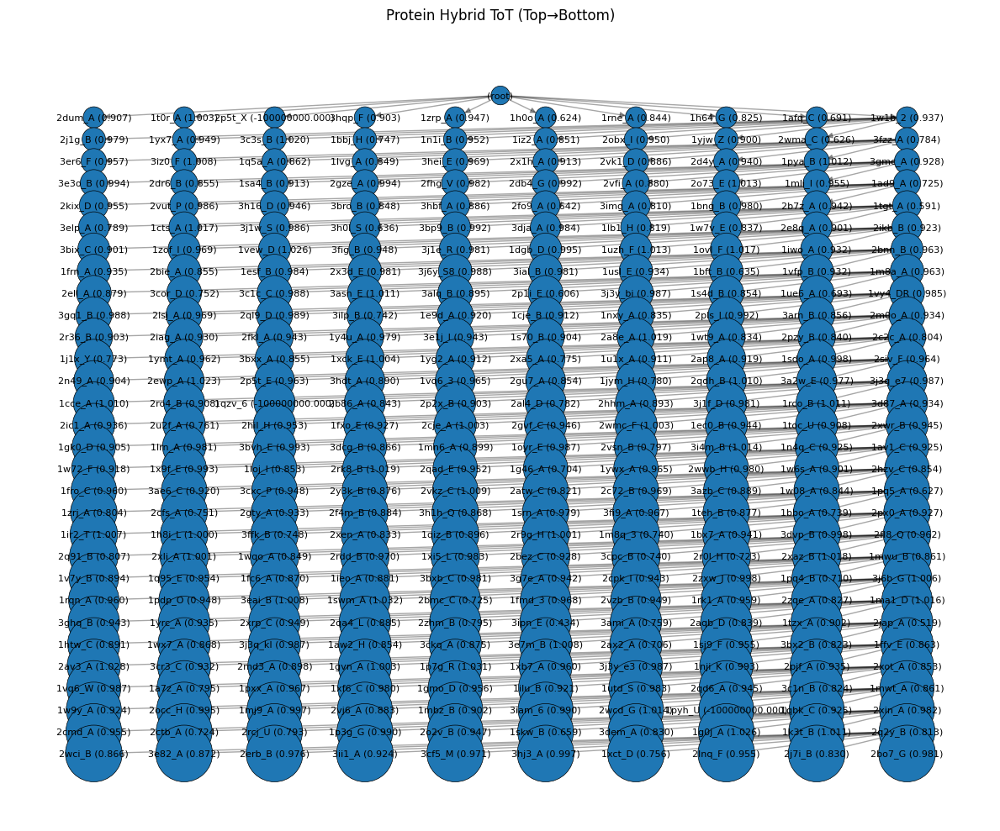


Using PDB IDs from chain IDs: receptor=101m, ligand=1swm
Rendering receptor + ligand in py3Dmol...


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [12]:
# ============================================================
# Protein ToT search using cached ESM2 embeddings
#   - Loads ligand embeddings from a .pt file
#   - Computes ONE embedding for receptor if needed
#   - Search value = ESM cosine + heuristic binding only
#   - At the end, prints ESM MLM plausibility for best ligand
# ============================================================

# pip install transformers accelerate torch tqdm networkx matplotlib py3Dmol requests

import os
import re
import math
import random
import gc
from dataclasses import dataclass
from typing import Dict, List, Tuple, Optional

import torch
from transformers import AutoTokenizer, AutoModel, AutoModelForMaskedLM
from tqdm.auto import tqdm
import networkx as nx
import matplotlib.pyplot as plt
import requests
import py3Dmol

# ===========================
# CONFIG
# ===========================
PDB_SEQRES_PATH   = "pdb_seqres.txt"                  # your file
ESM_EMB_PATH      = "esm2_chain_embeddings_random3000.pt"  # precomputed file
RECEPTOR_ID       = "101m_A"                          # receptor chain ID
MAX_LIGANDS_TOT   = 500                               # cap number of ligands in pool

DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
DEFAULT_SEED = 13

# ===========================
# SEEDING
# ===========================
def set_seed(seed: Optional[int]):
    if seed is None:
        return
    random.seed(seed)
    torch.manual_seed(seed)
    if torch.cuda.is_available():
        torch.cuda.manual_seed_all(seed)

# ===========================
# LOAD CACHED EMBEDDINGS
# ===========================
if not os.path.isfile(ESM_EMB_PATH):
    raise FileNotFoundError(f"{ESM_EMB_PATH} not found. Run the precompute script first.")

print(f"Loading cached embeddings from {ESM_EMB_PATH}...")
embfile = torch.load(ESM_EMB_PATH, map_location="cpu")
CHAIN_EMB: Dict[str, torch.Tensor] = embfile["embeddings"]
ESM_MODEL_NAME: str = embfile.get("model_name", "facebook/esm2_t12_35M_UR50D")
print(f"Loaded {len(CHAIN_EMB)} chain embeddings from model {ESM_MODEL_NAME}")

# ===========================
# PARSE pdb_seqres.txt
# ===========================
def parse_pdb_seqres(path: str) -> Dict[str, dict]:
    """
    Parse pdb_seqres.txt-like file into:
      {chain_id: {"mol": mol_type, "len": length, "desc": desc, "seq": sequence}}
    """
    records: Dict[str, dict] = {}
    header_re = re.compile(r"^(\S+)\s+mol:(\S+)\s+length:(\d+)\s*(.*)$")

    cid: Optional[str] = None
    mol = ""
    ln = 0
    desc = ""
    seq_lines: List[str] = []

    with open(path, "r") as f:
        for line in f:
            line = line.strip()
            if not line:
                continue

            if line.startswith(">"):
                # flush previous
                if cid is not None and seq_lines:
                    records[cid] = {
                        "mol": mol.lower(),
                        "len": ln,
                        "desc": desc,
                        "seq": "".join(seq_lines),
                    }

                m = header_re.match(line[1:])
                if m:
                    cid, mol, ln_str, desc = m.groups()
                    ln = int(ln_str)
                    seq_lines = []
                else:
                    cid = line[1:].split()[0]
                    mol = "unknown"
                    ln = 0
                    desc = ""
                    seq_lines = []
            else:
                seq_lines.append(line)

    # flush last
    if cid is not None and seq_lines:
        records[cid] = {
            "mol": mol.lower(),
            "len": ln,
            "desc": desc,
            "seq": "".join(seq_lines),
        }

    return records

if not os.path.isfile(PDB_SEQRES_PATH):
    raise FileNotFoundError(f"{PDB_SEQRES_PATH} not found in current directory")

print(f"Parsing {PDB_SEQRES_PATH}...")
records = parse_pdb_seqres(PDB_SEQRES_PATH)
print(f"Found {len(records)} chains total.")

if RECEPTOR_ID not in records:
    raise ValueError(f"Receptor chain {RECEPTOR_ID} not found in pdb_seqres.txt")

# ===========================
# BASIC SEQUENCE UTILS
# ===========================
AA20      = set("ACDEFGHIKLMNPQRSTVWY")
HYDRO     = set("AVILMFYW")
POLAR     = set("STNQCH")
POSITIVE  = set("KRH")
NEGATIVE  = set("DE")

def clean_protein(seq: str) -> str:
    return "".join(c for c in seq.upper() if c in AA20)

def pair_score(a: str, b: str) -> float:
    a = a.upper()
    b = b.upper()
    if (a in POSITIVE and b in NEGATIVE) or (a in NEGATIVE and b in POSITIVE):
        return 2.0
    if a in HYDRO and b in HYDRO:
        return 1.0
    if a in POLAR and b in POLAR:
        return 0.5
    if (a in POSITIVE and b in POSITIVE) or (a in NEGATIVE and b in NEGATIVE):
        return -1.0
    return -0.2

def binding_score(rec_seq: str, lig_seq: str) -> float:
    """
    Your sliding-window heuristic binding score.
    """
    R = clean_protein(rec_seq)
    L = clean_protein(lig_seq)
    if not R or not L:
        return -1e9

    if len(L) > len(R):
        R, L = L, R

    Lr, Ll = len(R), len(L)
    best = -1e9

    for shift in range(-Ll + 1, Lr):
        sr = max(0, shift)
        sl = max(0, -shift)
        overlap = min(Lr - sr, Ll - sl)
        if overlap <= 0:
            continue

        s = 0.0
        for k in range(overlap):
            s += pair_score(R[sr + k], L[sl + k])

        s_norm = s / overlap
        len_ratio = overlap / max(Lr, Ll)
        s_norm *= (0.5 + 0.5 * len_ratio)
        best = max(best, s_norm)

    return best

def cosine_sim(a: torch.Tensor, b: torch.Tensor) -> float:
    a = a / (a.norm(p=2) + 1e-8)
    b = b / (b.norm(p=2) + 1e-8)
    return float(torch.dot(a, b).item())

# ===========================
# LOAD ESM MODELS (for receptor embed + MLM at end)
# ===========================
gc.collect()
if torch.cuda.is_available():
    torch.cuda.empty_cache()

print(f"Loading ESM models ({ESM_MODEL_NAME}) on {DEVICE}...")
esm_tok = AutoTokenizer.from_pretrained(ESM_MODEL_NAME)
esm_mdl_enc = AutoModel.from_pretrained(ESM_MODEL_NAME).to(DEVICE).eval()
esm_mdl_mlm = AutoModelForMaskedLM.from_pretrained(ESM_MODEL_NAME).to(DEVICE).eval()

@torch.no_grad()
def esm_embed(seq: str, max_len: int = 1022) -> torch.Tensor:
    """
    Return a single embedding vector for an amino-acid sequence
    using ESM: average over residue embeddings.
    Used here ONLY if receptor is missing from cached embeddings.
    """
    seq = clean_protein(seq)
    seq = seq.strip()
    if len(seq) == 0:
        return torch.zeros(esm_mdl_enc.config.hidden_size, device=DEVICE)

    seq = seq[:max_len]
    enc = esm_tok(
        seq,
        return_tensors="pt",
        add_special_tokens=True,
        truncation=True,
        max_length=max_len + 2,
    )
    enc = {k: v.to(DEVICE) for k, v in enc.items()}
    out = esm_mdl_enc(**enc)
    reps = out.last_hidden_state  # [1, L, H]
    emb = reps.mean(dim=1)[0]     # [H]
    return emb

@torch.no_grad()
def mlm_plausibility(rec_seq: str, lig_seq: str, num_positions: int = 32) -> float:
    """
    Mask random ligand residues in rec+lig concat and compute
    average log-prob of true amino acid under ESM MLM.
    This is *only printed* for the best ligand, not used in the search.
    """
    rec = clean_protein(rec_seq)
    lig = clean_protein(lig_seq)
    if not rec or not lig:
        return -10.0

    combined = rec + lig
    Lr = len(rec)
    Ll = len(lig)

    lig_positions = list(range(Lr, Lr + Ll))
    random.shuffle(lig_positions)
    positions = lig_positions[: min(num_positions, len(lig_positions))]

    enc = esm_tok(combined, return_tensors="pt", add_special_tokens=True)
    ids = enc["input_ids"].to(DEVICE)
    attn = enc["attention_mask"].to(DEVICE)
    mask_id = esm_tok.mask_token_id

    logps = []
    for pos in positions:
        tid = 1 + pos
        if tid >= ids.shape[1] - 1:
            continue
        masked = ids.clone()
        true_id = masked[0, tid].item()
        masked[0, tid] = mask_id

        out = esm_mdl_mlm(input_ids=masked, attention_mask=attn)
        logits = out.logits[0, tid]
        probs = torch.softmax(logits, dim=-1)
        p_true = probs[true_id].clamp_min(1e-12)
        logps.append(float(torch.log(p_true).item()))

    if not logps:
        return -10.0
    return sum(logps) / len(logps)

# ===========================
# TREE BOOK FOR VISUALIZATION
# ===========================
class TreeBook:
    def __init__(self):
        self.G = nx.DiGraph()
        self.next_id = 0
        self.attrs: Dict[int, Dict[str, object]] = {}
        self.info: Dict[int, Tuple[str, ...]] = {}

    def add_node(self, depth: int, label: str, info: Tuple[str, ...]) -> int:
        nid = self.next_id
        self.next_id += 1
        self.G.add_node(nid)
        self.attrs[nid] = {"depth": depth, "label": label}
        self.info[nid] = info
        return nid

    def add_edge(self, u: int, v: int):
        self.G.add_edge(u, v)

def _layered_tb(G, attrs):
    levels: Dict[int, List[int]] = {}
    for n in G.nodes():
        d = attrs[n]["depth"]
        levels.setdefault(d, []).append(n)
    pos = {}
    y_gap = 1.8
    x_gap = 1.6
    for d in sorted(levels.keys()):
        row = sorted(levels[d])
        width = (len(row) - 1) * x_gap
        for i, nid in enumerate(row):
            pos[nid] = (-width / 2 + i * x_gap, -d * y_gap)
    return pos

def plot_tree(tb: TreeBook, title="Protein ToT (Top→Bottom)"):
    if tb.G.number_of_nodes() == 0:
        print("[viz] Empty tree.")
        return
    pos = _layered_tb(tb.G, tb.attrs)
    colors, sizes, labels = [], [], {}
    for nid in tb.G.nodes():
        colors.append("#1f77b4")
        d = tb.attrs[nid]["depth"]
        sizes.append(260 + 70 * d)
        lbl = tb.attrs[nid]["label"] or "(root)"
        labels[nid] = (lbl[:42] + "…") if len(lbl) > 43 else lbl
    plt.figure(figsize=(12, 10))
    nx.draw_networkx_edges(
        tb.G, pos, alpha=0.35, arrows=True,
        arrowstyle="-|>", min_target_margin=8
    )
    nx.draw_networkx_nodes(
        tb.G, pos, node_color=colors,
        node_size=sizes, linewidths=0.5, edgecolors="k"
    )
    nx.draw_networkx_labels(tb.G, pos, labels=labels, font_size=8)
    plt.title(title)
    plt.axis("off")
    plt.tight_layout()
    plt.show()

# ===========================
# ToT HYPERPARAMS
# ===========================
@dataclass
class P:
    max_depth: int = 5
    max_nodes: int = 300       # total ligand evaluations
    branch: int = 10           # children per node
    alpha_esm: float = 1.0     # weight for ESM cosine sim
    beta_bind: float = 0.1     # weight for heuristic binding_score
    depth_penalty: float = 0.02

@dataclass
class Node:
    nid: int
    info: Tuple[str, ...]
    depth: int
    value: float
    parent: float

# ===========================
# PROTEIN ToT SEARCH
# ===========================
class ProteinToT:
    def __init__(
        self,
        receptor_id: str,
        records: Dict[str, dict],
        lig_ids: List[str],
        rec_emb: torch.Tensor,
        lig_embs: Dict[str, torch.Tensor],
        p: P,
    ):
        self.receptor_id = receptor_id
        self.records = records
        self.lig_ids = lig_ids
        self.rec_seq = records[receptor_id]["seq"]
        self.rec_emb = rec_emb
        self.lig_embs = lig_embs
        self.p = p

        self.tb = TreeBook()
        self.nodes_evaluated = 0
        self.visited_ligs = set()
        self.best_lig = None
        self.best_score = -1e9

    def _score_ligand(self, lig_id: str) -> float:
        seq = self.records[lig_id]["seq"]
        emb = self.lig_embs[lig_id]
        cos = cosine_sim(self.rec_emb, emb)
        bind = binding_score(self.rec_seq, seq)
        return self.p.alpha_esm * cos + self.p.beta_bind * bind

    def _value(self, score: float, depth: int) -> float:
        return score - self.p.depth_penalty * depth

    def _canon(self, infos: List[str]) -> Tuple[str, ...]:
        out, seen = [], set()
        for s in infos:
            t = s.strip()
            k = t.lower()
            if t and k not in seen:
                seen.add(k)
                out.append(t[:240])
        return tuple(sorted(out))

    def _expand(self, node: Node) -> List[Tuple[float, str, Tuple[str, ...], float]]:
        remaining = [cid for cid in self.lig_ids if cid not in self.visited_ligs]
        if not remaining:
            return []
        random.shuffle(remaining)
        kids = []
        for lig_id in remaining[: self.p.branch]:
            score = self._score_ligand(lig_id)
            val = self._value(score, node.depth + 1)
            info = self._canon(list(node.info) + [
                f"LIG={lig_id}",
                f"SCORE={score:.4f}",
            ])
            kids.append((val, lig_id, info, score))
        return kids

    def solve(self, seed: Optional[int] = DEFAULT_SEED):
        set_seed(seed)

        root_info = self._canon([f"RECEPTOR={self.receptor_id}"])
        root_nid = self.tb.add_node(depth=0, label="(root)", info=root_info)
        self.tb.attrs[root_nid]["value"] = 0.0
        root = Node(nid=root_nid, info=root_info, depth=0, value=0.0, parent=-1e9)

        stack = [root]

        print(
            f"Starting Protein ToT search over {len(self.lig_ids)} ligands "
            f"(max_nodes={self.p.max_nodes}, branch={self.p.branch})"
        )

        with tqdm(
            total=self.p.max_nodes,
            desc="Nodes",
            unit="node",
            bar_format="{l_bar}{bar}| {n_fmt}/{total_fmt} [{rate_fmt}]",
        ) as pbar:
            while stack and self.nodes_evaluated < self.p.max_nodes:
                node = stack.pop()

                if self.nodes_evaluated % 10 == 0:
                    print(
                        f"[d={node.depth}] V={node.value:.3f} "
                        f"facts={len(node.info)} "
                    )

                children = self._expand(node)
                if not children:
                    continue

                for val, lig_id, info, score in children:
                    if self.nodes_evaluated >= self.p.max_nodes:
                        break

                    self.visited_ligs.add(lig_id)
                    if score > self.best_score:
                        self.best_score = score
                        self.best_lig = lig_id

                    label = f"{lig_id} ({score:.3f})"
                    child_nid = self.tb.add_node(
                        depth=node.depth + 1,
                        label=label,
                        info=info,
                    )
                    self.tb.attrs[child_nid]["value"] = val
                    self.tb.add_edge(node.nid, child_nid)

                    child = Node(
                        nid=child_nid,
                        info=info,
                        depth=node.depth + 1,
                        value=val,
                        parent=node.value,
                    )
                    stack.append(child)

                    self.nodes_evaluated += 1
                    pbar.update(1)

        return {
            "best_ligand": self.best_lig,
            "best_score": self.best_score,
            "tree": self.tb,
            "nodes": self.nodes_evaluated,
        }

# ===========================
# PDB FETCH + VISUALIZATION
# ===========================
def fetch_pdb_text(pdb_id: str) -> str:
    pdb_id = pdb_id.upper()
    url = f"https://files.rcsb.org/download/{pdb_id}.pdb"
    resp = requests.get(url, timeout=30)
    if resp.status_code != 200 or not resp.text.strip():
        raise RuntimeError(
            f"Failed to download PDB {pdb_id} from RCSB (status {resp.status_code})"
        )
    return resp.text

def show_receptor_ligand_pdb(rec_pdb: str, lig_pdb: str):
    pdb1_txt = fetch_pdb_text(rec_pdb)
    pdb2_txt = fetch_pdb_text(lig_pdb)

    view = py3Dmol.view(width=800, height=600)
    view.addModel(pdb1_txt, "pdb")
    view.setStyle({"model": 0}, {"cartoon": {"color": "spectrum"}})
    view.addModel(pdb2_txt, "pdb")
    view.setStyle({"model": 1}, {"cartoon": {"color": "cyan"}})
    view.zoomTo()
    view.spin(True)
    return view

# ===========================
# MAIN PIPELINE
# ===========================
if __name__ == "__main__":
    print(f"\nReceptor: {RECEPTOR_ID}")
    print("  mol   :", records[RECEPTOR_ID]["mol"])
    print("  len   :", records[RECEPTOR_ID]["len"])
    print("  desc  :", records[RECEPTOR_ID]["desc"])

    # Ligands = proteins that ALSO have cached embeddings
    ligands = [
        cid for cid, rec in records.items()
        if cid != RECEPTOR_ID and rec["mol"] == "protein" and cid in CHAIN_EMB
    ]
    if MAX_LIGANDS_TOT is not None:
        ligands = ligands[:MAX_LIGANDS_TOT]

    if not ligands:
        raise RuntimeError("No protein ligands with cached embeddings found to search over")

    print(f"\nLigand pool size (with embeddings): {len(ligands)}")

    # Receptor embedding: use cached if present, otherwise compute once
    if RECEPTOR_ID in CHAIN_EMB:
        print("Using cached embedding for receptor.")
        rec_emb = CHAIN_EMB[RECEPTOR_ID].to(DEVICE)
    else:
        print("Receptor embedding not cached. Computing once via ESM...")
        rec_seq_full = records[RECEPTOR_ID]["seq"]
        rec_emb = esm_embed(rec_seq_full).cpu().to(DEVICE)

    # Ligand embeddings from cache
    lig_embs: Dict[str, torch.Tensor] = {
        cid: CHAIN_EMB[cid].to(DEVICE) for cid in ligands
    }

    params = P(
        max_depth=5,
        max_nodes=300,
        branch=10,
        alpha_esm=1.0,
        beta_bind=0.1,
        depth_penalty=0.02,
    )
    solver = ProteinToT(
        receptor_id=RECEPTOR_ID,
        records=records,
        lig_ids=ligands,
        rec_emb=rec_emb,
        lig_embs=lig_embs,
        p=params,
    )
    res = solver.solve(seed=DEFAULT_SEED)

    best_lig = res["best_ligand"]
    best_score = res["best_score"]
    tb = res["tree"]

    print("\n=== BEST LIGAND (ToT value function: ESM + heuristic) ===")
    print("Receptor chain :", RECEPTOR_ID)
    print("Ligand chain   :", best_lig)
    print("Score (ESM + heuristic) :", f"{best_score:.3f}")
    if best_lig is not None:
        lig_seq_clean = clean_protein(records[best_lig]["seq"])
        print("Ligand length  :", len(lig_seq_clean))
        print("Ligand desc    :", records[best_lig]["desc"])

        # ---- ESM MLM plausibility *only printed*, not used in search ----
        rec_seq_full = records[RECEPTOR_ID]["seq"]
        lig_seq_full = records[best_lig]["seq"]
        mlm_score = mlm_plausibility(rec_seq_full, lig_seq_full)
        print("ESM MLM plausibility (log-prob avg):", f"{mlm_score:.4f}")

    print("\nNodes evaluated:", res["nodes"])
    print("Tree depth (max):", max(tb.attrs[n]["depth"] for n in tb.G.nodes()))

    print("\nPlotting search tree...")
    plot_tree(tb, title="Protein Hybrid ToT (Top→Bottom)")

    if best_lig is not None:
        rec_pdb_id = RECEPTOR_ID.split("_")[0]
        lig_pdb_id = best_lig.split("_")[0]
        print(
            f"\nUsing PDB IDs from chain IDs: receptor={rec_pdb_id}, ligand={lig_pdb_id}"
        )
        print("Rendering receptor + ligand in py3Dmol...")
        view = show_receptor_ligand_pdb(rec_pdb_id, lig_pdb_id)
        view.show()


In [14]:
# ============================================================
# Demo: align ligand 1swm onto receptor 101m and visualize
#   - Fetch PDB 101m and 1swm
#   - Kabsch alignment on Cα atoms
#   - Apply transform to all ligand atoms
#   - Show both in py3Dmol in a shared coordinate frame
# ============================================================

import requests
import numpy as np
import py3Dmol

# ----------------- Fetch PDB text -----------------
def fetch_pdb_text(pdb_id: str) -> str:
    pdb_id = pdb_id.upper()
    url = f"https://files.rcsb.org/download/{pdb_id}.pdb"
    resp = requests.get(url, timeout=30)
    if resp.status_code != 200 or not resp.text.strip():
        raise RuntimeError(
            f"Failed to download PDB {pdb_id} from RCSB (status {resp.status_code})"
        )
    return resp.text

# ----------------- PDB parsing helpers -----------------
def parse_pdb_atoms(pdb_txt: str):
    """
    Parse ATOM/HETATM lines.
    Returns a list of dicts with original line and coords.
    """
    atoms = []
    for line in pdb_txt.splitlines():
        if not (line.startswith("ATOM") or line.startswith("HETATM")):
            continue
        try:
            x = float(line[30:38])
            y = float(line[38:46])
            z = float(line[46:54])
        except ValueError:
            continue
        atoms.append({
            "line": line,
            "x": x,
            "y": y,
            "z": z,
        })
    return atoms

def get_ca_coords(atoms):
    """
    Extract Cα coordinates (as Nx3 array) from parsed atoms.
    """
    coords = []
    for a in atoms:
        line = a["line"]
        atom_name = line[12:16]
        if atom_name.strip() == "CA":
            coords.append([a["x"], a["y"], a["z"]])
    if not coords:
        return np.zeros((0, 3))
    return np.array(coords, dtype=np.float64)

def format_pdb_with_new_coords(atoms, R, t):
    """
    Apply rigid transform x -> R x + t to all atoms, return new PDB text.
    Only modifies ATOM/HETATM coordinates.
    """
    out_lines = []
    for a in atoms:
        # original position
        v = np.array([a["x"], a["y"], a["z"]], dtype=np.float64)
        # transformed
        v_new = R @ v + t  # (3,) = (3x3) @ (3,) + (3,)

        line = a["line"]
        new_line = (
            line[:30]
            + f"{v_new[0]:8.3f}{v_new[1]:8.3f}{v_new[2]:8.3f}"
            + line[54:]
        )
        out_lines.append(new_line)
    return "\n".join(out_lines) + "\n"

def rebuild_pdb_with_coords(original_pdb: str, atoms_transformed_txt: str):
    """
    Replace ATOM/HETATM lines of original_pdb with transformed ones.
    """
    transformed_lines = atoms_transformed_txt.splitlines()
    out = []
    for line in original_pdb.splitlines():
        if line.startswith("ATOM") or line.startswith("HETATM"):
            continue
        out.append(line)
    out.extend(transformed_lines)
    return "\n".join(out) + "\n"

# ----------------- Kabsch alignment -----------------
def kabsch_align(P: np.ndarray, Q: np.ndarray):
    """
    Kabsch algorithm: find R, t that aligns Q -> P by minimizing RMSD.
    P, Q: Nx3 arrays (P = receptor CA coords, Q = ligand CA coords)
    """
    if P.shape[0] == 0 or Q.shape[0] == 0:
        raise ValueError("Empty coordinate sets for alignment.")

    n = min(P.shape[0], Q.shape[0])
    P = P[:n]
    Q = Q[:n]

    # subtract centroids
    centroid_P = P.mean(axis=0)
    centroid_Q = Q.mean(axis=0)
    P_centered = P - centroid_P
    Q_centered = Q - centroid_Q

    H = Q_centered.T @ P_centered  # 3x3
    U, S, Vt = np.linalg.svd(H)
    R = Vt.T @ U.T

    # correct reflection if needed
    if np.linalg.det(R) < 0:
        Vt[2, :] *= -1
        R = Vt.T @ U.T

    t = centroid_P - R @ centroid_Q
    return R, t

# ----------------- Main demo: 101m vs 1swm -----------------
receptor_id = "101m"
ligand_id   = "1swm"

print(f"Fetching PDBs: receptor={receptor_id}, ligand={ligand_id}")
pdb_rec_txt = fetch_pdb_text(receptor_id)
pdb_lig_txt = fetch_pdb_text(ligand_id)

# parse atoms
rec_atoms = parse_pdb_atoms(pdb_rec_txt)
lig_atoms = parse_pdb_atoms(pdb_lig_txt)

# get CA coords
rec_ca = get_ca_coords(rec_atoms)
lig_ca = get_ca_coords(lig_atoms)

print(f"Receptor CA atoms: {rec_ca.shape[0]}")
print(f"Ligand   CA atoms: {lig_ca.shape[0]}")

R, t = kabsch_align(rec_ca, lig_ca)

# apply transform to ligand atoms
lig_transformed_txt = format_pdb_with_new_coords(lig_atoms, R, t)
lig_pdb_aligned = rebuild_pdb_with_coords(pdb_lig_txt, lig_transformed_txt)

# ----------------- Visualize with py3Dmol -----------------
view = py3Dmol.view(width=800, height=600)

# receptor (unaltered)
view.addModel(pdb_rec_txt, "pdb")
view.setStyle({"model": 0}, {"cartoon": {"color": "spectrum"}})

# ligand (aligned onto receptor frame)
view.addModel(lig_pdb_aligned, "pdb")
view.setStyle({"model": 1}, {"cartoon": {"color": "cyan"}})

view.zoomTo()
view.spin(True)
view.show()


Fetching PDBs: receptor=101m, ligand=1swm
Receptor CA atoms: 154
Ligand   CA atoms: 153


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

## covid protein

Loading cached embeddings from esm2_chain_embeddings_random3000.pt...
Loaded 3000 chain embeddings from model facebook/esm2_t12_35M_UR50D
Parsing pdb_seqres.txt...
Found 1060737 chains total.
Loading ESM models (facebook/esm2_t12_35M_UR50D) on cpu...


Some weights of EsmModel were not initialized from the model checkpoint at facebook/esm2_t12_35M_UR50D and are newly initialized: ['pooler.dense.bias', 'pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.



Receptor: 101m_A
  mol   : protein
  len   : 154
  desc  : MYOGLOBIN

Ligand pool size (with embeddings): 2000
Receptor embedding not cached. Computing once via ESM...
Starting Protein ToT search over 2000 ligands (max_nodes=1000, branch=10)


Nodes:   0%|          | 0/1000 [?node/s]

[d=0] V=0.000 facts=1 
[d=1] V=0.939 facts=3 
[d=2] V=0.953 facts=5 
[d=3] V=0.912 facts=7 
[d=4] V=0.758 facts=9 
[d=5] V=0.593 facts=11 
[d=6] V=0.819 facts=13 
[d=7] V=0.854 facts=15 
[d=8] V=0.747 facts=17 
[d=9] V=0.771 facts=19 
[d=10] V=0.654 facts=21 
[d=11] V=0.660 facts=23 
[d=12] V=0.662 facts=25 
[d=13] V=0.468 facts=27 
[d=14] V=0.712 facts=29 
[d=15] V=0.462 facts=31 
[d=16] V=0.678 facts=33 
[d=17] V=-100000000.340 facts=35 
[d=18] V=0.649 facts=37 
[d=19] V=0.636 facts=39 
[d=20] V=0.513 facts=41 
[d=21] V=0.524 facts=43 
[d=22] V=0.392 facts=45 
[d=23] V=0.511 facts=47 
[d=24] V=0.445 facts=49 
[d=25] V=0.487 facts=51 
[d=26] V=0.340 facts=53 
[d=27] V=0.417 facts=55 
[d=28] V=0.377 facts=57 
[d=29] V=0.405 facts=59 
[d=30] V=-0.273 facts=61 
[d=31] V=0.319 facts=63 
[d=32] V=0.299 facts=65 
[d=33] V=0.120 facts=67 
[d=34] V=0.165 facts=69 
[d=35] V=0.223 facts=71 
[d=36] V=-0.083 facts=73 
[d=37] V=0.155 facts=75 
[d=38] V=0.221 facts=77 
[d=39] V=-100000000.780 facts

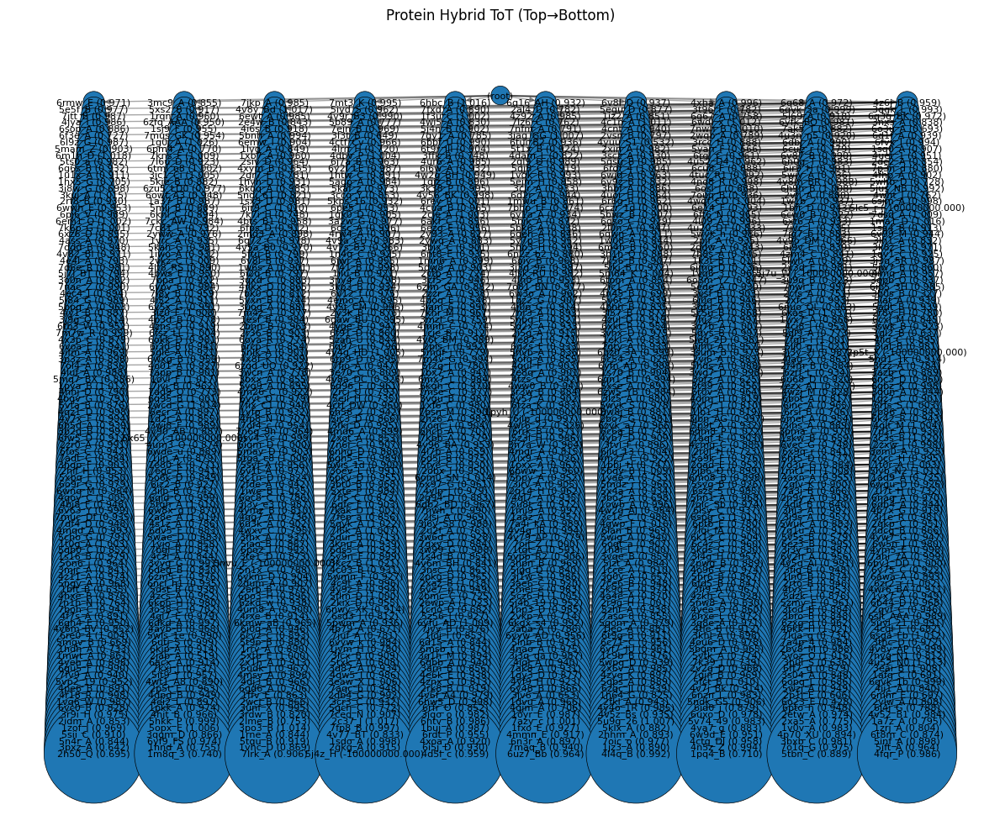


Using PDB IDs from chain IDs: receptor=101m_A, ligand=6kas_D
Aligning and rendering receptor + ligand in py3Dmol...
Fetching PDBs for alignment: receptor=101m, ligand=6kas
Receptor CA atoms (chain A): 154
Ligand   CA atoms (chain D): 146


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [7]:
# ============================================================
# Protein ToT search using cached ESM2 embeddings
#   - Loads ligand embeddings from a .pt file
#   - Computes ONE embedding for receptor if needed
#   - Search value = ESM cosine + heuristic binding only
#   - At the end, prints ESM MLM plausibility for best ligand
#   - Visualizes receptor + ligand using Kabsch alignment
# ============================================================

# pip install transformers accelerate torch tqdm networkx matplotlib py3Dmol requests

import os
import re
import math
import random
import gc
from dataclasses import dataclass
from typing import Dict, List, Tuple, Optional

import torch
from transformers import AutoTokenizer, AutoModel, AutoModelForMaskedLM
from tqdm.auto import tqdm
import networkx as nx
import matplotlib.pyplot as plt
import requests
import py3Dmol
import numpy as np

# ===========================
# CONFIG
# ===========================
PDB_SEQRES_PATH   = "pdb_seqres.txt"                        # your file
ESM_EMB_PATH      = "esm2_chain_embeddings_random3000.pt"   # precomputed file

# Example COVID receptor: SARS-CoV-2 spike RBD (6M0J, chain E)
# Change this if your pdb_seqres.txt has a different COVID chain.
# RECEPTOR_ID       = "6m0j_E"                                # receptor chain ID

RECEPTOR_ID       = "101m_A"                          # receptor chain ID

MAX_LIGANDS_TOT   = 2000                                     # cap number of ligands in pool

DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
DEFAULT_SEED = 13

# ===========================
# SEEDING
# ===========================
def set_seed(seed: Optional[int]):
    if seed is None:
        return
    random.seed(seed)
    torch.manual_seed(seed)
    if torch.cuda.is_available():
        torch.cuda.manual_seed_all(seed)

# ===========================
# LOAD CACHED EMBEDDINGS
# ===========================
if not os.path.isfile(ESM_EMB_PATH):
    raise FileNotFoundError(f"{ESM_EMB_PATH} not found. Run the precompute script first.")

print(f"Loading cached embeddings from {ESM_EMB_PATH}...")
embfile = torch.load(ESM_EMB_PATH, map_location="cpu")
CHAIN_EMB: Dict[str, torch.Tensor] = embfile["embeddings"]
ESM_MODEL_NAME: str = embfile.get("model_name", "facebook/esm2_t12_35M_UR50D")
print(f"Loaded {len(CHAIN_EMB)} chain embeddings from model {ESM_MODEL_NAME}")

# ===========================
# PARSE pdb_seqres.txt
# ===========================
def parse_pdb_seqres(path: str) -> Dict[str, dict]:
    """
    Parse pdb_seqres.txt-like file into:
      {chain_id: {"mol": mol_type, "len": length, "desc": desc, "seq": sequence}}
    """
    records: Dict[str, dict] = {}
    header_re = re.compile(r"^(\S+)\s+mol:(\S+)\s+length:(\d+)\s*(.*)$")

    cid: Optional[str] = None
    mol = ""
    ln = 0
    desc = ""
    seq_lines: List[str] = []

    with open(path, "r") as f:
        for line in f:
            line = line.strip()
            if not line:
                continue

            if line.startswith(">"):
                # flush previous
                if cid is not None and seq_lines:
                    records[cid] = {
                        "mol": mol.lower(),
                        "len": ln,
                        "desc": desc,
                        "seq": "".join(seq_lines),
                    }

                m = header_re.match(line[1:])
                if m:
                    cid, mol, ln_str, desc = m.groups()
                    ln = int(ln_str)
                    seq_lines = []
                else:
                    cid = line[1:].split()[0]
                    mol = "unknown"
                    ln = 0
                    desc = ""
                    seq_lines = []
            else:
                seq_lines.append(line)

    # flush last
    if cid is not None and seq_lines:
        records[cid] = {
            "mol": mol.lower(),
            "len": ln,
            "desc": desc,
            "seq": "".join(seq_lines),
        }

    return records

if not os.path.isfile(PDB_SEQRES_PATH):
    raise FileNotFoundError(f"{PDB_SEQRES_PATH} not found in current directory")

print(f"Parsing {PDB_SEQRES_PATH}...")
records = parse_pdb_seqres(PDB_SEQRES_PATH)
print(f"Found {len(records)} chains total.")

if RECEPTOR_ID not in records:
    raise ValueError(f"Receptor chain {RECEPTOR_ID} not found in pdb_seqres.txt")

# ===========================
# BASIC SEQUENCE UTILS
# ===========================
AA20      = set("ACDEFGHIKLMNPQRSTVWY")
HYDRO     = set("AVILMFYW")
POLAR     = set("STNQCH")
POSITIVE  = set("KRH")
NEGATIVE  = set("DE")

def clean_protein(seq: str) -> str:
    return "".join(c for c in seq.upper() if c in AA20)

def pair_score(a: str, b: str) -> float:
    a = a.upper()
    b = b.upper()
    if (a in POSITIVE and b in NEGATIVE) or (a in NEGATIVE and b in POSITIVE):
        return 2.0
    if a in HYDRO and b in HYDRO:
        return 1.0
    if a in POLAR and b in POLAR:
        return 0.5
    if (a in POSITIVE and b in POSITIVE) or (a in NEGATIVE and b in NEGATIVE):
        return -1.0
    return -0.2

def binding_score(rec_seq: str, lig_seq: str) -> float:
    """
    Sliding-window heuristic binding score.
    """
    R = clean_protein(rec_seq)
    L = clean_protein(lig_seq)
    if not R or not L:
        return -1e9

    if len(L) > len(R):
        R, L = L, R

    Lr, Ll = len(R), len(L)
    best = -1e9

    for shift in range(-Ll + 1, Lr):
        sr = max(0, shift)
        sl = max(0, -shift)
        overlap = min(Lr - sr, Ll - sl)
        if overlap <= 0:
            continue

        s = 0.0
        for k in range(overlap):
            s += pair_score(R[sr + k], L[sl + k])

        s_norm = s / overlap
        len_ratio = overlap / max(Lr, Ll)
        s_norm *= (0.5 + 0.5 * len_ratio)
        best = max(best, s_norm)

    return best

def cosine_sim(a: torch.Tensor, b: torch.Tensor) -> float:
    a = a / (a.norm(p=2) + 1e-8)
    b = b / (b.norm(p=2) + 1e-8)
    return float(torch.dot(a, b).item())

# ===========================
# LOAD ESM MODELS (for receptor embed + MLM at end)
# ===========================
gc.collect()
if torch.cuda.is_available():
    torch.cuda.empty_cache()

print(f"Loading ESM models ({ESM_MODEL_NAME}) on {DEVICE}...")
esm_tok = AutoTokenizer.from_pretrained(ESM_MODEL_NAME)
esm_mdl_enc = AutoModel.from_pretrained(ESM_MODEL_NAME).to(DEVICE).eval()
esm_mdl_mlm = AutoModelForMaskedLM.from_pretrained(ESM_MODEL_NAME).to(DEVICE).eval()

@torch.no_grad()
def esm_embed(seq: str, max_len: int = 1022) -> torch.Tensor:
    """
    Return a single embedding vector for an amino-acid sequence
    using ESM: average over residue embeddings.
    Used here ONLY if receptor is missing from cached embeddings.
    """
    seq = clean_protein(seq)
    seq = seq.strip()
    if len(seq) == 0:
        return torch.zeros(esm_mdl_enc.config.hidden_size, device=DEVICE)

    seq = seq[:max_len]
    enc = esm_tok(
        seq,
        return_tensors="pt",
        add_special_tokens=True,
        truncation=True,
        max_length=max_len + 2,
    )
    enc = {k: v.to(DEVICE) for k, v in enc.items()}
    out = esm_mdl_enc(**enc)
    reps = out.last_hidden_state  # [1, L, H]
    emb = reps.mean(dim=1)[0]     # [H]
    return emb

@torch.no_grad()
def mlm_plausibility(rec_seq: str, lig_seq: str, num_positions: int = 32) -> float:
    """
    Mask random ligand residues in rec+lig concat and compute
    average log-prob of true amino acid under ESM MLM.
    This is *only printed* for the best ligand, not used in the search.
    """
    rec = clean_protein(rec_seq)
    lig = clean_protein(lig_seq)
    if not rec or not lig:
        return -10.0

    combined = rec + lig
    Lr = len(rec)
    Ll = len(lig)

    lig_positions = list(range(Lr, Lr + Ll))
    random.shuffle(lig_positions)
    positions = lig_positions[: min(num_positions, len(lig_positions))]

    enc = esm_tok(combined, return_tensors="pt", add_special_tokens=True)
    ids = enc["input_ids"].to(DEVICE)
    attn = enc["attention_mask"].to(DEVICE)
    mask_id = esm_tok.mask_token_id

    logps = []
    for pos in positions:
        tid = 1 + pos
        if tid >= ids.shape[1] - 1:
            continue
        masked = ids.clone()
        true_id = masked[0, tid].item()
        masked[0, tid] = mask_id

        out = esm_mdl_mlm(input_ids=masked, attention_mask=attn)
        logits = out.logits[0, tid]
        probs = torch.softmax(logits, dim=-1)
        p_true = probs[true_id].clamp_min(1e-12)
        logps.append(float(torch.log(p_true).item()))

    if not logps:
        return -10.0
    return sum(logps) / len(logps)

# ===========================
# TREE BOOK FOR VISUALIZATION
# ===========================
class TreeBook:
    def __init__(self):
        self.G = nx.DiGraph()
        self.next_id = 0
        self.attrs: Dict[int, Dict[str, object]] = {}
        self.info: Dict[int, Tuple[str, ...]] = {}

    def add_node(self, depth: int, label: str, info: Tuple[str, ...]) -> int:
        nid = self.next_id
        self.next_id += 1
        self.G.add_node(nid)
        self.attrs[nid] = {"depth": depth, "label": label}
        self.info[nid] = info
        return nid

    def add_edge(self, u: int, v: int):
        self.G.add_edge(u, v)

def _layered_tb(G, attrs):
    levels: Dict[int, List[int]] = {}
    for n in G.nodes():
        d = attrs[n]["depth"]
        levels.setdefault(d, []).append(n)
    pos = {}
    y_gap = 1.8
    x_gap = 1.6
    for d in sorted(levels.keys()):
        row = sorted(levels[d])
        width = (len(row) - 1) * x_gap
        for i, nid in enumerate(row):
            pos[nid] = (-width / 2 + i * x_gap, -d * y_gap)
    return pos

def plot_tree(tb: TreeBook, title="Protein ToT (Top→Bottom)"):
    if tb.G.number_of_nodes() == 0:
        print("[viz] Empty tree.")
        return
    pos = _layered_tb(tb.G, tb.attrs)
    colors, sizes, labels = [], [], {}
    for nid in tb.G.nodes():
        colors.append("#1f77b4")
        d = tb.attrs[nid]["depth"]
        sizes.append(260 + 70 * d)
        lbl = tb.attrs[nid]["label"] or "(root)"
        labels[nid] = (lbl[:42] + "…") if len(lbl) > 43 else lbl
    plt.figure(figsize=(12, 10))
    nx.draw_networkx_edges(
        tb.G, pos, alpha=0.35, arrows=True,
        arrowstyle="-|>", min_target_margin=8
    )
    nx.draw_networkx_nodes(
        tb.G, pos, node_color=colors,
        node_size=sizes, linewidths=0.5, edgecolors="k"
    )
    nx.draw_networkx_labels(tb.G, pos, labels=labels, font_size=8)
    plt.title(title)
    plt.axis("off")
    plt.tight_layout()
    plt.show()

# ===========================
# ToT HYPERPARAMS
# ===========================
@dataclass
class P:
    max_depth: int = 5
    max_nodes: int = 1000       # total ligand evaluations
    branch: int = 10           # children per node
    alpha_esm: float = 1.0     # weight for ESM cosine sim
    beta_bind: float = 0.1     # weight for heuristic binding_score
    depth_penalty: float = 0.02

@dataclass
class Node:
    nid: int
    info: Tuple[str, ...]
    depth: int
    value: float
    parent: float

# ===========================
# PROTEIN ToT SEARCH
# ===========================
class ProteinToT:
    def __init__(
        self,
        receptor_id: str,
        records: Dict[str, dict],
        lig_ids: List[str],
        rec_emb: torch.Tensor,
        lig_embs: Dict[str, torch.Tensor],
        p: P,
    ):
        self.receptor_id = receptor_id
        self.records = records
        self.lig_ids = lig_ids
        self.rec_seq = records[receptor_id]["seq"]
        self.rec_emb = rec_emb
        self.lig_embs = lig_embs
        self.p = p

        self.tb = TreeBook()
        self.nodes_evaluated = 0
        self.visited_ligs = set()
        self.best_lig = None
        self.best_score = -1e9

    def _score_ligand(self, lig_id: str) -> float:
        seq = self.records[lig_id]["seq"]
        emb = self.lig_embs[lig_id]
        cos = cosine_sim(self.rec_emb, emb)
        bind = binding_score(self.rec_seq, seq)
        return self.p.alpha_esm * cos + self.p.beta_bind * bind

    def _value(self, score: float, depth: int) -> float:
        return score - self.p.depth_penalty * depth

    def _canon(self, infos: List[str]) -> Tuple[str, ...]:
        out, seen = [], set()
        for s in infos:
            t = s.strip()
            k = t.lower()
            if t and k not in seen:
                seen.add(k)
                out.append(t[:240])
        return tuple(sorted(out))

    def _expand(self, node: Node) -> List[Tuple[float, str, Tuple[str, ...], float]]:
        remaining = [cid for cid in self.lig_ids if cid not in self.visited_ligs]
        if not remaining:
            return []
        random.shuffle(remaining)
        kids = []
        for lig_id in remaining[: self.p.branch]:
            score = self._score_ligand(lig_id)
            val = self._value(score, node.depth + 1)
            info = self._canon(list(node.info) + [
                f"LIG={lig_id}",
                f"SCORE={score:.4f}",
            ])
            kids.append((val, lig_id, info, score))
        return kids

    def solve(self, seed: Optional[int] = DEFAULT_SEED):
        set_seed(seed)

        root_info = self._canon([f"RECEPTOR={self.receptor_id}"])
        root_nid = self.tb.add_node(depth=0, label="(root)", info=root_info)
        self.tb.attrs[root_nid]["value"] = 0.0
        root = Node(nid=root_nid, info=root_info, depth=0, value=0.0, parent=-1e9)

        stack = [root]

        print(
            f"Starting Protein ToT search over {len(self.lig_ids)} ligands "
            f"(max_nodes={self.p.max_nodes}, branch={self.p.branch})"
        )

        with tqdm(
            total=self.p.max_nodes,
            desc="Nodes",
            unit="node",
            bar_format="{l_bar}{bar}| {n_fmt}/{total_fmt} [{rate_fmt}]",
        ) as pbar:
            while stack and self.nodes_evaluated < self.p.max_nodes:
                node = stack.pop()

                if self.nodes_evaluated % 10 == 0:
                    print(
                        f"[d={node.depth}] V={node.value:.3f} "
                        f"facts={len(node.info)} "
                    )

                children = self._expand(node)
                if not children:
                    continue

                for val, lig_id, info, score in children:
                    if self.nodes_evaluated >= self.p.max_nodes:
                        break

                    self.visited_ligs.add(lig_id)
                    if score > self.best_score:
                        self.best_score = score
                        self.best_lig = lig_id

                    label = f"{lig_id} ({score:.3f})"
                    child_nid = self.tb.add_node(
                        depth=node.depth + 1,
                        label=label,
                        info=info,
                    )
                    self.tb.attrs[child_nid]["value"] = val
                    self.tb.add_edge(node.nid, child_nid)

                    child = Node(
                        nid=child_nid,
                        info=info,
                        depth=node.depth + 1,
                        value=val,
                        parent=node.value,
                    )
                    stack.append(child)

                    self.nodes_evaluated += 1
                    pbar.update(1)

        return {
            "best_ligand": self.best_lig,
            "best_score": self.best_score,
            "tree": self.tb,
            "nodes": self.nodes_evaluated,
        }

# ===========================
# PDB FETCH + ALIGNMENT VISUALIZATION
# ===========================
def fetch_pdb_text(pdb_id: str) -> str:
    pdb_id = pdb_id.upper()
    url = f"https://files.rcsb.org/download/{pdb_id}.pdb"
    resp = requests.get(url, timeout=30)
    if resp.status_code != 200 or not resp.text.strip():
        raise RuntimeError(
            f"Failed to download PDB {pdb_id} from RCSB (status {resp.status_code})"
        )
    return resp.text

def split_pdb_chain(id_str: str):
    """
    '6m0j_E' -> ('6m0j', 'E')
    '6m0j'   -> ('6m0j', None)
    """
    parts = id_str.split("_", 1)
    if len(parts) == 1:
        return parts[0], None
    return parts[0], parts[1]

def parse_pdb_atoms(pdb_txt: str, chain_id: str = None):
    """
    Parse ATOM/HETATM lines.
    If chain_id is given, only keep that chain.
    """
    atoms = []
    for line in pdb_txt.splitlines():
        if not (line.startswith("ATOM") or line.startswith("HETATM")):
            continue
        if chain_id is not None:
            ch = line[21].strip()
            if ch != chain_id:
                continue
        try:
            x = float(line[30:38])
            y = float(line[38:46])
            z = float(line[46:54])
        except ValueError:
            continue
        atoms.append({"line": line, "x": x, "y": y, "z": z})
    return atoms

def get_ca_coords(atoms):
    coords = []
    for a in atoms:
        line = a["line"]
        atom_name = line[12:16]
        if atom_name.strip() == "CA":
            coords.append([a["x"], a["y"], a["z"]])
    if not coords:
        return np.zeros((0, 3))
    return np.array(coords, dtype=np.float64)

def format_pdb_with_new_coords(atoms, R, t):
    out_lines = []
    for a in atoms:
        v = np.array([a["x"], a["y"], a["z"]], dtype=np.float64)
        v_new = R @ v + t
        line = a["line"]
        new_line = (
            line[:30]
            + f"{v_new[0]:8.3f}{v_new[1]:8.3f}{v_new[2]:8.3f}"
            + line[54:]
        )
        out_lines.append(new_line)
    return "\n".join(out_lines) + "\n"

def rebuild_pdb_with_coords(original_pdb: str, atoms_transformed_txt: str):
    transformed_lines = atoms_transformed_txt.splitlines()
    out = []
    for line in original_pdb.splitlines():
        if line.startswith("ATOM") or line.startswith("HETATM"):
            continue
        out.append(line)
    out.extend(transformed_lines)
    return "\n".join(out) + "\n"

def kabsch_align(P: np.ndarray, Q: np.ndarray):
    """
    Kabsch algorithm: find R, t that aligns Q -> P by minimizing RMSD.
    P, Q: Nx3 arrays
    """
    if P.shape[0] == 0 or Q.shape[0] == 0:
        raise ValueError("Empty coordinate sets for alignment.")

    n = min(P.shape[0], Q.shape[0])
    P = P[:n]
    Q = Q[:n]

    centroid_P = P.mean(axis=0)
    centroid_Q = Q.mean(axis=0)
    P_centered = P - centroid_P
    Q_centered = Q - centroid_Q

    H = Q_centered.T @ P_centered
    U, S, Vt = np.linalg.svd(H)
    R = Vt.T @ U.T

    if np.linalg.det(R) < 0:
        Vt[2, :] *= -1
        R = Vt.T @ U.T

    t = centroid_P - R @ centroid_Q
    return R, t

def align_and_show(receptor_id: str, ligand_id: str):
    """
    receptor_id, ligand_id like '6m0j_E', '1a01_B', etc.
    """
    rec_pdb, rec_chain = split_pdb_chain(receptor_id)
    lig_pdb, lig_chain = split_pdb_chain(ligand_id)

    print(f"Fetching PDBs for alignment: receptor={rec_pdb}, ligand={lig_pdb}")
    pdb_rec_txt = fetch_pdb_text(rec_pdb)
    pdb_lig_txt = fetch_pdb_text(lig_pdb)

    rec_atoms_align = parse_pdb_atoms(pdb_rec_txt, chain_id=rec_chain)
    lig_atoms_align = parse_pdb_atoms(pdb_lig_txt, chain_id=lig_chain)

    rec_ca = get_ca_coords(rec_atoms_align)
    lig_ca = get_ca_coords(lig_atoms_align)

    print(f"Receptor CA atoms (chain {rec_chain}): {rec_ca.shape[0]}")
    print(f"Ligand   CA atoms (chain {lig_chain}): {lig_ca.shape[0]}")

    R, t = kabsch_align(rec_ca, lig_ca)

    lig_atoms_all = parse_pdb_atoms(pdb_lig_txt, chain_id=None)
    lig_transformed_txt = format_pdb_with_new_coords(lig_atoms_all, R, t)
    lig_pdb_aligned = rebuild_pdb_with_coords(pdb_lig_txt, lig_transformed_txt)

    view = py3Dmol.view(width=800, height=600)

    # receptor
    view.addModel(pdb_rec_txt, "pdb")
    if rec_chain is not None:
        view.setStyle({"model": 0, "chain": rec_chain}, {"cartoon": {"color": "spectrum"}})
    else:
        view.setStyle({"model": 0}, {"cartoon": {"color": "spectrum"}})

    # aligned ligand
    view.addModel(lig_pdb_aligned, "pdb")
    if lig_chain is not None:
        view.setStyle({"model": 1, "chain": lig_chain}, {"cartoon": {"color": "cyan"}})
    else:
        view.setStyle({"model": 1}, {"cartoon": {"color": "cyan"}})

    view.zoomTo()
    view.spin(True)
    return view

# ===========================
# MAIN PIPELINE
# ===========================
if __name__ == "__main__":
    print(f"\nReceptor: {RECEPTOR_ID}")
    print("  mol   :", records[RECEPTOR_ID]["mol"])
    print("  len   :", records[RECEPTOR_ID]["len"])
    print("  desc  :", records[RECEPTOR_ID]["desc"])

    # Ligands = proteins that ALSO have cached embeddings
    ligands = [
        cid for cid, rec in records.items()
        if cid != RECEPTOR_ID and rec["mol"] == "protein" and cid in CHAIN_EMB
    ]
    if MAX_LIGANDS_TOT is not None:
        ligands = ligands[:MAX_LIGANDS_TOT]

    if not ligands:
        raise RuntimeError("No protein ligands with cached embeddings found to search over")

    print(f"\nLigand pool size (with embeddings): {len(ligands)}")

    # Receptor embedding: use cached if present, otherwise compute once
    if RECEPTOR_ID in CHAIN_EMB:
        print("Using cached embedding for receptor.")
        rec_emb = CHAIN_EMB[RECEPTOR_ID].to(DEVICE)
    else:
        print("Receptor embedding not cached. Computing once via ESM...")
        rec_seq_full = records[RECEPTOR_ID]["seq"]
        rec_emb = esm_embed(rec_seq_full).cpu().to(DEVICE)

    # Ligand embeddings from cache
    lig_embs: Dict[str, torch.Tensor] = {
        cid: CHAIN_EMB[cid].to(DEVICE) for cid in ligands
    }

    params = P(
        max_depth=5,
        max_nodes=1000,
        branch=10,
        alpha_esm=1.0,
        beta_bind=0.1,
        depth_penalty=0.02,
    )
    solver = ProteinToT(
        receptor_id=RECEPTOR_ID,
        records=records,
        lig_ids=ligands,
        rec_emb=rec_emb,
        lig_embs=lig_embs,
        p=params,
    )
    res = solver.solve(seed=DEFAULT_SEED)

    best_lig = res["best_ligand"]
    best_score = res["best_score"]
    tb = res["tree"]

    print("\n=== BEST LIGAND (ToT value function: ESM + heuristic) ===")
    print("Receptor chain :", RECEPTOR_ID)
    print("Ligand chain   :", best_lig)
    print("Score (ESM + heuristic) :", f"{best_score:.3f}")
    if best_lig is not None:
        lig_seq_clean = clean_protein(records[best_lig]["seq"])
        print("Ligand length  :", len(lig_seq_clean))
        print("Ligand desc    :", records[best_lig]["desc"])

        # ---- ESM MLM plausibility *only printed*, not used in search ----
        rec_seq_full = records[RECEPTOR_ID]["seq"]
        lig_seq_full = records[best_lig]["seq"]
        mlm_score = mlm_plausibility(rec_seq_full, lig_seq_full)
        print("ESM MLM plausibility (log-prob avg):", f"{mlm_score:.4f}")

    print("\nNodes evaluated:", res["nodes"])
    print("Tree depth (max):", max(tb.attrs[n]["depth"] for n in tb.G.nodes()))

    print("\nPlotting search tree...")
    plot_tree(tb, title="Protein Hybrid ToT (Top→Bottom)")

    if best_lig is not None:
        print(
            f"\nUsing PDB IDs from chain IDs: receptor={RECEPTOR_ID}, ligand={best_lig}"
        )
        print("Aligning and rendering receptor + ligand in py3Dmol...")
        view = align_and_show(RECEPTOR_ID, best_lig)
        view.show()


101m_full.pdb already exists, skipping download.
6kas_full.pdb already exists, skipping download.
Wrote chain A of 101m_full.pdb to 101m_A.pdb (atoms: 1414)
Wrote chain D of 6kas_full.pdb to 6kas_D.pdb (atoms: 1271)
Receptor CA shape: (154, 3)
Ligand CA shape  : (146, 3)
Baseline contact pose: score=285, contacts=625, clashes=34
Best random pose index: 71 score: 326


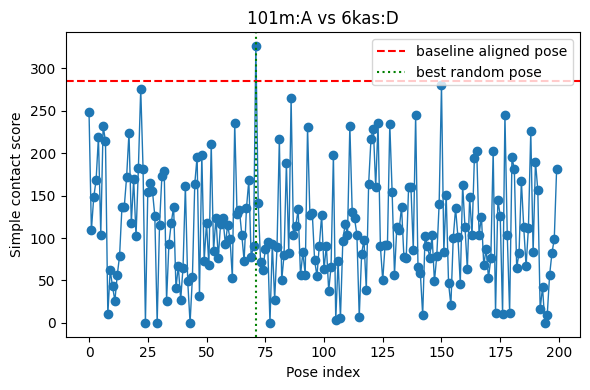

Wrote docked complex to 101m_6kas_docked_simple.pdb


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

{'scores': array([248, 109, 148, 168, 219, 104, 232, 214,  10,  62,  43,  26,  56,
         79, 136, 137, 172, 224, 118, 169, 102, 182, 276, 181,   0, 154,
        165, 155, 126,   0, 115, 173, 179,  26,  93, 118, 137,  41,  67,
         27,  65, 161,  49,   0,  54, 164, 196,  32, 198,  73, 118,  68,
        211,  85, 124,  77, 117, 123,  93, 115,  99,  53, 236, 128, 133,
        104,  73, 135, 168,  78,  90, 326, 141,  72,  62,  87,  95,   0,
         93,  27,  89, 217,  50,  80, 188,  82, 265, 103, 114, 134,  56,
         83,  57, 231, 127, 130,  74,  55,  91, 127,  63,  91,  38,  66,
        198,   3,  73,   6,  96, 117, 103, 232, 131, 123, 104,   7,  81,
         98,  39, 164, 217, 229, 160, 235,  90,  50,  92,  92, 234, 154,
         57, 113, 110, 137,  78,  77, 160, 160,  86, 245,  66,  59,   9,
        102,  91,  77, 103,  49,  79, 140, 280,  84, 151,  47,  21, 100,
        135, 101,  46, 163, 113,  63, 148, 104, 194, 202, 104, 125,  68,
         87,  53,  76, 203,  12, 145, 126

In [13]:
compare_structures_with_simple_docking(
    receptor_pdb_id="101m", receptor_chain="A",
    ligand_pdb_id="6kas", ligand_chain="D",
    n_poses=200,
)


# New Value function (not similarity in embedding space)

Loading cached embeddings from esm2_chain_embeddings_random3000.pt...
Loaded 3000 chain embeddings from model facebook/esm2_t12_35M_UR50D
Parsing pdb_seqres.txt...
Found 1060737 chains total.
Loading ESM models (facebook/esm2_t12_35M_UR50D) on cuda...


Some weights of EsmModel were not initialized from the model checkpoint at facebook/esm2_t12_35M_UR50D and are newly initialized: ['pooler.dense.bias', 'pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Starting Protein ToT search over 2000 ligands (max_nodes=1000, branch=10)


Nodes:   0%|          | 0/1000 [?node/s]


=== BEST LIGAND ===
Receptor: 101m_A
Ligand  : 6dkd_A
Score   : 3.168
Ligand CA atoms: 229
ipTM-like: 1.0000
ESM MLM plausibility: -2.5248

Nodes evaluated: 1000

Plotting search tree...


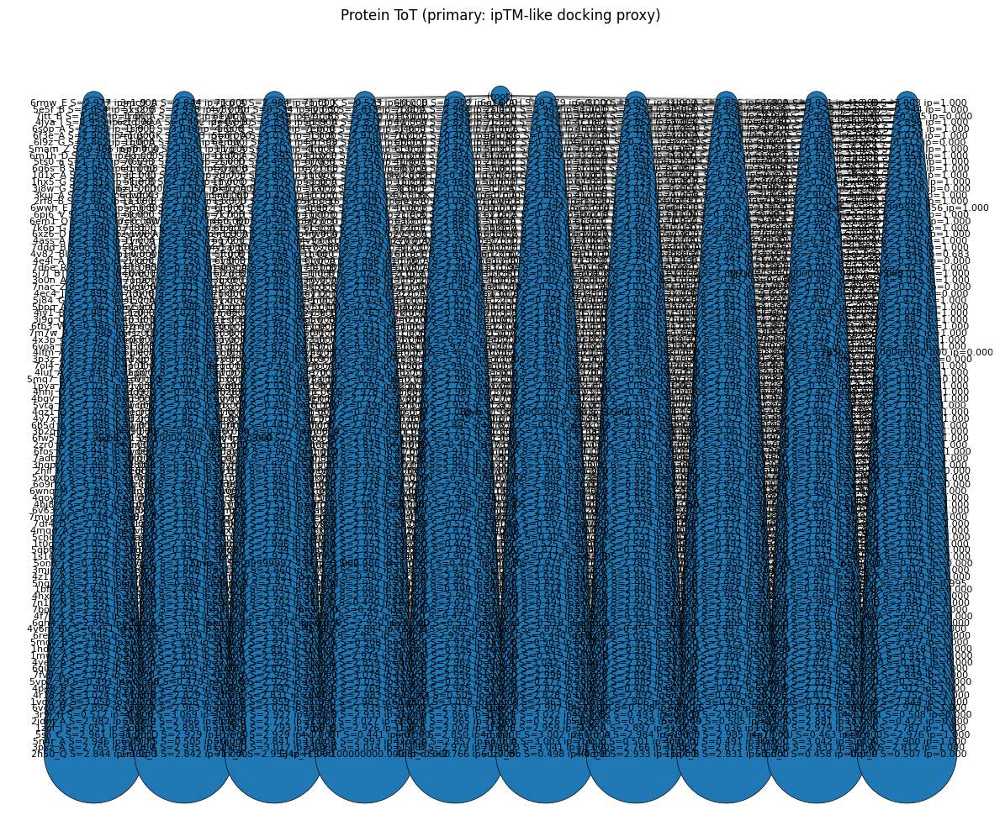

In [7]:
# ============================================================
# Protein ToT search using cached ESM2 embeddings + ipTM-like docking
#   - NO pre-filter loop over ligands (fast startup)
#   - Still guards against tiny/fragment chains inside scoring (returns 0.0)
#   - Value function: ipTM_like (primary) + ESM cosine + seq heuristic + docking
# ============================================================

# pip install transformers accelerate torch tqdm networkx matplotlib py3Dmol requests

import os, re, math, random, gc
from dataclasses import dataclass
from typing import Dict, List, Tuple, Optional

import torch
from transformers import AutoTokenizer, AutoModel, AutoModelForMaskedLM
from tqdm.auto import tqdm
import networkx as nx
import matplotlib.pyplot as plt
import requests
import py3Dmol
import numpy as np

# ===========================
# CONFIG
# ===========================
PDB_SEQRES_PATH   = "pdb_seqres.txt"
ESM_EMB_PATH      = "esm2_chain_embeddings_random3000.pt"

RECEPTOR_ID       = "101m_A"
MAX_LIGANDS_TOT   = 2000

DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
DEFAULT_SEED = 13

# keep guards (but do not pre-filter)
MIN_CA_LIG  = 40
MIN_CA_REC  = 40

PDB_TEXT_CACHE: Dict[str, str] = {}
CA_CACHE: Dict[str, np.ndarray] = {}
DOCK_CACHE: Dict[Tuple[str, str], Tuple[float, np.ndarray, np.ndarray]] = {}

# ===========================
# SEEDING
# ===========================
def set_seed(seed: Optional[int]):
    if seed is None:
        return
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    if torch.cuda.is_available():
        torch.cuda.manual_seed_all(seed)

# ===========================
# LOAD CACHED EMBEDDINGS
# ===========================
if not os.path.isfile(ESM_EMB_PATH):
    raise FileNotFoundError(f"{ESM_EMB_PATH} not found. Run the precompute script first.")

print(f"Loading cached embeddings from {ESM_EMB_PATH}...")
embfile = torch.load(ESM_EMB_PATH, map_location="cpu")
CHAIN_EMB: Dict[str, torch.Tensor] = embfile["embeddings"]
ESM_MODEL_NAME: str = embfile.get("model_name", "facebook/esm2_t12_35M_UR50D")
print(f"Loaded {len(CHAIN_EMB)} chain embeddings from model {ESM_MODEL_NAME}")

# ===========================
# PARSE pdb_seqres.txt
# ===========================
def parse_pdb_seqres(path: str) -> Dict[str, dict]:
    records: Dict[str, dict] = {}
    header_re = re.compile(r"^(\S+)\s+mol:(\S+)\s+length:(\d+)\s*(.*)$")

    cid: Optional[str] = None
    mol = ""
    ln = 0
    desc = ""
    seq_lines: List[str] = []

    with open(path, "r") as f:
        for line in f:
            line = line.strip()
            if not line:
                continue

            if line.startswith(">"):
                if cid is not None and seq_lines:
                    records[cid] = {"mol": mol.lower(), "len": ln, "desc": desc, "seq": "".join(seq_lines)}

                m = header_re.match(line[1:])
                if m:
                    cid, mol, ln_str, desc = m.groups()
                    ln = int(ln_str)
                    seq_lines = []
                else:
                    cid = line[1:].split()[0]
                    mol = "unknown"
                    ln = 0
                    desc = ""
                    seq_lines = []
            else:
                seq_lines.append(line)

    if cid is not None and seq_lines:
        records[cid] = {"mol": mol.lower(), "len": ln, "desc": desc, "seq": "".join(seq_lines)}
    return records

if not os.path.isfile(PDB_SEQRES_PATH):
    raise FileNotFoundError(f"{PDB_SEQRES_PATH} not found in current directory")

print(f"Parsing {PDB_SEQRES_PATH}...")
records = parse_pdb_seqres(PDB_SEQRES_PATH)
print(f"Found {len(records)} chains total.")

if RECEPTOR_ID not in records:
    raise ValueError(f"Receptor chain {RECEPTOR_ID} not found in pdb_seqres.txt")

# ===========================
# BASIC SEQUENCE UTILS
# ===========================
AA20      = set("ACDEFGHIKLMNPQRSTVWY")
HYDRO     = set("AVILMFYW")
POLAR     = set("STNQCH")
POSITIVE  = set("KRH")
NEGATIVE  = set("DE")

def clean_protein(seq: str) -> str:
    return "".join(c for c in seq.upper() if c in AA20)

def pair_score(a: str, b: str) -> float:
    a = a.upper(); b = b.upper()
    if (a in POSITIVE and b in NEGATIVE) or (a in NEGATIVE and b in POSITIVE): return 2.0
    if a in HYDRO and b in HYDRO: return 1.0
    if a in POLAR and b in POLAR: return 0.5
    if (a in POSITIVE and b in POSITIVE) or (a in NEGATIVE and b in NEGATIVE): return -1.0
    return -0.2

def binding_score(rec_seq: str, lig_seq: str) -> float:
    R = clean_protein(rec_seq)
    L = clean_protein(lig_seq)
    if not R or not L: return -1e9
    if len(L) > len(R): R, L = L, R

    Lr, Ll = len(R), len(L)
    best = -1e9
    for shift in range(-Ll + 1, Lr):
        sr = max(0, shift)
        sl = max(0, -shift)
        overlap = min(Lr - sr, Ll - sl)
        if overlap <= 0: continue
        s = 0.0
        for k in range(overlap):
            s += pair_score(R[sr + k], L[sl + k])
        s_norm = s / overlap
        len_ratio = overlap / max(Lr, Ll)
        s_norm *= (0.5 + 0.5 * len_ratio)
        best = max(best, s_norm)
    return best

def cosine_sim(a: torch.Tensor, b: torch.Tensor) -> float:
    a = a / (a.norm(p=2) + 1e-8)
    b = b / (b.norm(p=2) + 1e-8)
    return float(torch.dot(a, b).item())

# ===========================
# LOAD ESM MODELS
# ===========================
gc.collect()
if torch.cuda.is_available():
    torch.cuda.empty_cache()

print(f"Loading ESM models ({ESM_MODEL_NAME}) on {DEVICE}...")
esm_tok = AutoTokenizer.from_pretrained(ESM_MODEL_NAME)
esm_mdl_enc = AutoModel.from_pretrained(ESM_MODEL_NAME).to(DEVICE).eval()
esm_mdl_mlm = AutoModelForMaskedLM.from_pretrained(ESM_MODEL_NAME).to(DEVICE).eval()

@torch.no_grad()
def esm_embed(seq: str, max_len: int = 1022) -> torch.Tensor:
    seq = clean_protein(seq)
    if len(seq) == 0:
        return torch.zeros(esm_mdl_enc.config.hidden_size, device=DEVICE)
    seq = seq[:max_len]
    enc = esm_tok(seq, return_tensors="pt", add_special_tokens=True, truncation=True, max_length=max_len + 2)
    enc = {k: v.to(DEVICE) for k, v in enc.items()}
    out = esm_mdl_enc(**enc)
    return out.last_hidden_state.mean(dim=1)[0]

@torch.no_grad()
def mlm_plausibility(rec_seq: str, lig_seq: str, num_positions: int = 32) -> float:
    rec = clean_protein(rec_seq)
    lig = clean_protein(lig_seq)
    if not rec or not lig:
        return -10.0

    combined = rec + lig
    Lr = len(rec); Ll = len(lig)

    lig_positions = list(range(Lr, Lr + Ll))
    random.shuffle(lig_positions)
    positions = lig_positions[: min(num_positions, len(lig_positions))]

    enc = esm_tok(combined, return_tensors="pt", add_special_tokens=True)
    ids = enc["input_ids"].to(DEVICE)
    attn = enc["attention_mask"].to(DEVICE)
    mask_id = esm_tok.mask_token_id

    logps = []
    for pos in positions:
        tid = 1 + pos
        if tid >= ids.shape[1] - 1:
            continue
        masked = ids.clone()
        true_id = masked[0, tid].item()
        masked[0, tid] = mask_id
        out = esm_mdl_mlm(input_ids=masked, attention_mask=attn)
        logits = out.logits[0, tid]
        probs = torch.softmax(logits, dim=-1)
        p_true = probs[true_id].clamp_min(1e-12)
        logps.append(float(torch.log(p_true).item()))

    return (sum(logps) / len(logps)) if logps else -10.0

# ===========================
# TREE BOOK
# ===========================
class TreeBook:
    def __init__(self):
        self.G = nx.DiGraph()
        self.next_id = 0
        self.attrs: Dict[int, Dict[str, object]] = {}
        self.info: Dict[int, Tuple[str, ...]] = {}

    def add_node(self, depth: int, label: str, info: Tuple[str, ...]) -> int:
        nid = self.next_id
        self.next_id += 1
        self.G.add_node(nid)
        self.attrs[nid] = {"depth": depth, "label": label}
        self.info[nid] = info
        return nid

    def add_edge(self, u: int, v: int):
        self.G.add_edge(u, v)

def _layered_tb(G, attrs):
    levels: Dict[int, List[int]] = {}
    for n in G.nodes():
        d = attrs[n]["depth"]
        levels.setdefault(d, []).append(n)
    pos = {}
    y_gap = 1.8
    x_gap = 1.6
    for d in sorted(levels.keys()):
        row = sorted(levels[d])
        width = (len(row) - 1) * x_gap
        for i, nid in enumerate(row):
            pos[nid] = (-width / 2 + i * x_gap, -d * y_gap)
    return pos

def plot_tree(tb: TreeBook, title="Protein ToT (Top→Bottom)"):
    if tb.G.number_of_nodes() == 0:
        print("[viz] Empty tree.")
        return
    pos = _layered_tb(tb.G, tb.attrs)
    colors, sizes, labels = [], [], {}
    for nid in tb.G.nodes():
        colors.append("#1f77b4")
        d = tb.attrs[nid]["depth"]
        sizes.append(260 + 70 * d)
        lbl = tb.attrs[nid]["label"] or "(root)"
        labels[nid] = (lbl[:42] + "…") if len(lbl) > 43 else lbl
    plt.figure(figsize=(12, 10))
    nx.draw_networkx_edges(tb.G, pos, alpha=0.35, arrows=True, arrowstyle="-|>", min_target_margin=8)
    nx.draw_networkx_nodes(tb.G, pos, node_color=colors, node_size=sizes, linewidths=0.5, edgecolors="k")
    nx.draw_networkx_labels(tb.G, pos, labels=labels, font_size=8)
    plt.title(title)
    plt.axis("off")
    plt.tight_layout()
    plt.show()

# ===========================
# PARAMS + NODE
# ===========================
@dataclass
class P:
    max_depth: int = 5
    max_nodes: int = 1000
    branch: int = 10
    w_iptm: float = 2.0
    w_esm: float = 0.5
    w_bind: float = 0.1
    w_dock: float = 0.2
    depth_penalty: float = 0.02

@dataclass
class Node:
    nid: int
    info: Tuple[str, ...]
    depth: int
    value: float
    parent: float

# ===========================
# PDB / GEOMETRY
# ===========================
def fetch_pdb_text(pdb_id: str) -> str:
    pdb_id = pdb_id.upper()
    url = f"https://files.rcsb.org/download/{pdb_id}.pdb"
    resp = requests.get(url, timeout=30)
    if resp.status_code != 200 or not resp.text.strip():
        return ""
    return resp.text

def split_pdb_chain(id_str: str):
    parts = id_str.split("_", 1)
    pdb_id = parts[0]
    chain = parts[1].strip().upper() if len(parts) == 2 and parts[1] else None
    return pdb_id, chain

def parse_pdb_atoms(pdb_txt: str, chain_id: str = None):
    atoms = []
    if not pdb_txt:
        return atoms
    saw_model = False
    in_first_model = False
    chain_id_norm = chain_id.upper() if chain_id is not None else None

    for line in pdb_txt.splitlines():
        if line.startswith("MODEL"):
            if not saw_model:
                saw_model = True
                in_first_model = True
            else:
                break
            continue
        if line.startswith("ENDMDL") and in_first_model:
            break
        if not (line.startswith("ATOM") or line.startswith("HETATM")):
            continue
        if chain_id_norm is not None and line[21].upper().strip() != chain_id_norm:
            continue
        alt = line[16].strip()
        if alt not in ("", "A"):
            continue
        try:
            x = float(line[30:38]); y = float(line[38:46]); z = float(line[46:54])
        except ValueError:
            continue
        atoms.append({"line": line, "x": x, "y": y, "z": z})
    return atoms

def get_ca_coords(atoms):
    coords = []
    for a in atoms:
        if a["line"][12:16].strip() == "CA":
            coords.append([a["x"], a["y"], a["z"]])
    return np.array(coords, dtype=np.float64) if coords else np.zeros((0, 3))

def get_pdb_text_cached(pdb_id: str) -> str:
    pdb_id = pdb_id.upper()
    if pdb_id in PDB_TEXT_CACHE:
        return PDB_TEXT_CACHE[pdb_id]
    txt = fetch_pdb_text(pdb_id)
    PDB_TEXT_CACHE[pdb_id] = txt
    return txt

def get_ca_for_chain(chain_id: str) -> np.ndarray:
    if chain_id in CA_CACHE:
        return CA_CACHE[chain_id]
    pdb_id, ch = split_pdb_chain(chain_id)
    pdb_txt = get_pdb_text_cached(pdb_id)
    if not pdb_txt:
        CA_CACHE[chain_id] = np.zeros((0, 3))
        return CA_CACHE[chain_id]
    atoms = parse_pdb_atoms(pdb_txt, chain_id=ch)
    ca = get_ca_coords(atoms)
    CA_CACHE[chain_id] = ca
    return ca

# ===========================
# DOCKING + ipTM-like
# ===========================
def random_rotation_matrix() -> np.ndarray:
    u1, u2, u3 = np.random.rand(3)
    q1 = math.sqrt(1-u1) * math.sin(2*math.pi*u2)
    q2 = math.sqrt(1-u1) * math.cos(2*math.pi*u2)
    q3 = math.sqrt(u1)   * math.sin(2*math.pi*u3)
    q4 = math.sqrt(u1)   * math.cos(2*math.pi*u3)
    x, y, z, w = q1, q2, q3, q4
    return np.array([
        [1-2*(y*y+z*z),   2*(x*y - z*w),   2*(x*z + y*w)],
        [2*(x*y + z*w),   1-2*(x*x+z*z),   2*(y*z - x*w)],
        [2*(x*z - y*w),   2*(y*z + x*w),   1-2*(x*x+y*y)]
    ], dtype=float)

def interface_score(rec_ca: np.ndarray, lig_ca: np.ndarray, contact_cut: float = 6.0, clash_cut: float = 2.0):
    if rec_ca.size == 0 or lig_ca.size == 0:
        return -1e9
    diff = rec_ca[:, None, :] - lig_ca[None, :, :]
    dist2 = np.sum(diff * diff, axis=-1)
    contacts = dist2 < contact_cut**2
    clashes  = dist2 < clash_cut**2
    return float(contacts.sum() - 10 * clashes.sum())

def search_best_docking_pose(rec_ca: np.ndarray, lig_ca: np.ndarray, n_poses: int = 60, trans_std: float = 6.0):
    if rec_ca.size == 0 or lig_ca.size == 0:
        return -1e9, np.eye(3), np.zeros(3), lig_ca
    rec_center = rec_ca.mean(axis=0)
    lig_center0 = lig_ca.mean(axis=0)

    best = -1e9
    best_R = np.eye(3)
    best_t = np.zeros(3)
    best_lig = lig_ca

    for _ in range(n_poses):
        R = random_rotation_matrix()
        delta = np.random.normal(scale=trans_std, size=3)
        t = rec_center + delta - R @ lig_center0
        lig_try = (R @ lig_ca.T).T + t
        s = interface_score(rec_ca, lig_try)
        if s > best:
            best = s
            best_R = R
            best_t = t
            best_lig = lig_try
    return float(best), best_R, best_t, best_lig

def docking_score_cached(rec_chain_id: str, lig_chain_id: str, n_poses: int = 60, trans_std: float = 6.0) -> float:
    key = (rec_chain_id, lig_chain_id)
    if key in DOCK_CACHE:
        return DOCK_CACHE[key][0]

    rec_ca = get_ca_for_chain(rec_chain_id)
    lig_ca = get_ca_for_chain(lig_chain_id)

    if rec_ca.shape[0] < MIN_CA_REC or lig_ca.shape[0] < MIN_CA_LIG:
        DOCK_CACHE[key] = (0.0, np.eye(3), np.zeros(3))
        return 0.0

    raw, R_best, t_best, _ = search_best_docking_pose(rec_ca, lig_ca, n_poses=n_poses, trans_std=trans_std)
    denom = max(1.0, math.sqrt(len(rec_ca) * len(lig_ca)))
    norm = raw / denom
    DOCK_CACHE[key] = (float(norm), R_best, t_best)
    return float(norm)

def sigmoid(x: float) -> float:
    return 1.0 / (1.0 + math.exp(-x))

def iptm_like_score(rec_chain_id: str, lig_chain_id: str, contact_cut: float = 8.0, n_poses: int = 80, trans_std: float = 6.0) -> float:
    rec_ca = get_ca_for_chain(rec_chain_id)
    lig_ca = get_ca_for_chain(lig_chain_id)
    if rec_ca.shape[0] < MIN_CA_REC or lig_ca.shape[0] < MIN_CA_LIG:
        return 0.0

    _, _, _, lig_best = search_best_docking_pose(rec_ca, lig_ca, n_poses=n_poses, trans_std=trans_std)
    diff = rec_ca[:, None, :] - lig_best[None, :, :]
    dist = np.sqrt(np.sum(diff * diff, axis=-1) + 1e-12)
    mask = dist < contact_cut
    if not np.any(mask):
        return 0.0
    dists = dist[mask]
    w = np.clip((contact_cut - dists) / (contact_cut - 2.0 + 1e-8), 0.0, 1.0)
    contact_strength = float(w.sum())
    size_norm = math.sqrt(len(rec_ca) * len(lig_ca))
    s = contact_strength / max(1.0, size_norm)
    return float(sigmoid(10.0 * (s - 0.05)))

# ===========================
# ToT
# ===========================
class ProteinToT:
    def __init__(self, receptor_id: str, records: Dict[str, dict], lig_ids: List[str],
                 rec_emb: torch.Tensor, lig_embs: Dict[str, torch.Tensor], p: P):
        self.receptor_id = receptor_id
        self.records = records
        self.lig_ids = lig_ids
        self.rec_seq = records[receptor_id]["seq"]
        self.rec_emb = rec_emb
        self.lig_embs = lig_embs
        self.p = p

        self.tb = TreeBook()
        self.nodes_evaluated = 0
        self.visited_ligs = set()
        self.best_lig = None
        self.best_score = -1e9

    def _canon(self, infos: List[str]) -> Tuple[str, ...]:
        out, seen = [], set()
        for s in infos:
            t = s.strip()
            k = t.lower()
            if t and k not in seen:
                seen.add(k)
                out.append(t[:240])
        return tuple(sorted(out))

    def _score_ligand(self, lig_id: str) -> Tuple[float, Dict[str, float]]:
        seq = self.records[lig_id]["seq"]
        emb = self.lig_embs[lig_id]

        ip = iptm_like_score(self.receptor_id, lig_id)
        cos = cosine_sim(self.rec_emb, emb)
        bind = binding_score(self.rec_seq, seq)
        dock = docking_score_cached(self.receptor_id, lig_id)

        score = (self.p.w_iptm * ip +
                 self.p.w_esm  * cos +
                 self.p.w_bind * bind +
                 self.p.w_dock * dock)
        return score, {"ipTM_like": ip, "esm_cos": cos, "bind": bind, "dock": dock}

    def _value(self, score: float, depth: int) -> float:
        return score - self.p.depth_penalty * depth

    def _expand(self, node: Node):
        remaining = [cid for cid in self.lig_ids if cid not in self.visited_ligs]
        if not remaining:
            return []
        random.shuffle(remaining)
        kids = []
        for lig_id in remaining[: self.p.branch]:
            score, parts = self._score_ligand(lig_id)
            val = self._value(score, node.depth + 1)
            info = self._canon(list(node.info) + [
                f"LIG={lig_id}",
                f"SCORE={score:.4f}",
                f"ipTM_like={parts['ipTM_like']:.4f}",
            ])
            kids.append((val, lig_id, info, score, parts))
        return kids

    def solve(self, seed: Optional[int] = DEFAULT_SEED):
        set_seed(seed)

        root_info = self._canon([f"RECEPTOR={self.receptor_id}"])
        root_nid = self.tb.add_node(depth=0, label="(root)", info=root_info)
        self.tb.attrs[root_nid]["value"] = 0.0
        root = Node(nid=root_nid, info=root_info, depth=0, value=0.0, parent=-1e9)

        stack = [root]

        print(f"Starting Protein ToT search over {len(self.lig_ids)} ligands (max_nodes={self.p.max_nodes}, branch={self.p.branch})")
        with tqdm(total=self.p.max_nodes, desc="Nodes", unit="node",
                  bar_format="{l_bar}{bar}| {n_fmt}/{total_fmt} [{rate_fmt}]") as pbar:
            while stack and self.nodes_evaluated < self.p.max_nodes:
                node = stack.pop()

                children = self._expand(node)
                if not children:
                    continue

                for val, lig_id, info, score, parts in children:
                    if self.nodes_evaluated >= self.p.max_nodes:
                        break

                    self.visited_ligs.add(lig_id)
                    if score > self.best_score:
                        self.best_score = score
                        self.best_lig = lig_id

                    label = f"{lig_id} S={score:.3f} ip={parts['ipTM_like']:.3f}"
                    child_nid = self.tb.add_node(depth=node.depth + 1, label=label, info=info)
                    self.tb.attrs[child_nid]["value"] = val
                    self.tb.add_edge(node.nid, child_nid)

                    stack.append(Node(nid=child_nid, info=info, depth=node.depth + 1, value=val, parent=node.value))

                    self.nodes_evaluated += 1
                    pbar.update(1)

        return {"best_ligand": self.best_lig, "best_score": self.best_score, "tree": self.tb, "nodes": self.nodes_evaluated}

# ===========================
# MAIN
# ===========================
if __name__ == "__main__":
    ligands = [cid for cid, rec in records.items()
               if cid != RECEPTOR_ID and rec["mol"] == "protein" and cid in CHAIN_EMB]
    ligands = ligands[:MAX_LIGANDS_TOT]

    if not ligands:
        raise RuntimeError("No protein ligands with cached embeddings found to search over")

    if RECEPTOR_ID in CHAIN_EMB:
        rec_emb = CHAIN_EMB[RECEPTOR_ID].to(DEVICE)
    else:
        rec_emb = esm_embed(records[RECEPTOR_ID]["seq"]).to(DEVICE)

    lig_embs = {cid: CHAIN_EMB[cid].to(DEVICE) for cid in ligands}

    params = P(max_depth=5, max_nodes=1000, branch=10, w_iptm=2.0, w_esm=0.5, w_bind=0.1, w_dock=0.2, depth_penalty=0.02)

    solver = ProteinToT(RECEPTOR_ID, records, ligands, rec_emb, lig_embs, params)
    res = solver.solve(seed=DEFAULT_SEED)

    best_lig = res["best_ligand"]
    print("\n=== BEST LIGAND ===")
    print("Receptor:", RECEPTOR_ID)
    print("Ligand  :", best_lig)
    print("Score   :", f"{res['best_score']:.3f}")

    if best_lig is not None:
        ip = iptm_like_score(RECEPTOR_ID, best_lig)
        ca_l = get_ca_for_chain(best_lig).shape[0]
        print("Ligand CA atoms:", ca_l)
        print("ipTM-like:", f"{ip:.4f}")
        mlm = mlm_plausibility(records[RECEPTOR_ID]["seq"], records[best_lig]["seq"])
        print("ESM MLM plausibility:", f"{mlm:.4f}")

    print("\nNodes evaluated:", res["nodes"])
    print("\nPlotting search tree...")
    plot_tree(res["tree"], title="Protein ToT (primary: ipTM-like docking proxy)")


Loading cached embeddings from esm2_chain_embeddings_random3000.pt...
Loaded 3000 chain embeddings from model facebook/esm2_t12_35M_UR50D
Parsing pdb_seqres.txt...
Found 1060737 chains total.
Loading ESM models (facebook/esm2_t12_35M_UR50D) on cuda...


Some weights of EsmModel were not initialized from the model checkpoint at facebook/esm2_t12_35M_UR50D and are newly initialized: ['pooler.dense.bias', 'pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.



Receptor: 101m_A
  mol   : protein
  len   : 154
  desc  : MYOGLOBIN
Receptor embedding not cached. Computing via ESM (GPU) then moving to CPU...

[INFO] No co-crystallized protein/peptide partners found for 101m_A.
       Using ESM-based preselection from global protein pool...


ESM preselect:   0%|          | 0/2000 [00:00<?, ?lig/s]


[INFO] ESM preselection picked 400 ligands (from 2000 candidates). Top pre_score=1.037
Ligand pool size (after selection): 400
Starting Protein ToT search over 400 ligands (max_nodes=1000, branch=10)


Nodes:   0%|          | 0/1000 [?node/s]

[d=0] V=0.000 facts=1 
[WARN] Failed to download PDB 6BY1 from RCSB (status 404). Docking will be disabled for this PDB.
[WARN] Missing CA coordinates for docking pair 101m_A / 6by1_DD. Docking score set to 0.0.
[WARN] Failed to download PDB 3JAG from RCSB (status 404). Docking will be disabled for this PDB.
[WARN] Missing CA coordinates for docking pair 101m_A / 3jag_GG. Docking score set to 0.0.
[d=1] V=1.497 facts=3 
[WARN] Failed to download PDB 4WQF from RCSB (status 404). Docking will be disabled for this PDB.
[WARN] Missing CA coordinates for docking pair 101m_A / 4wqf_CO. Docking score set to 0.0.
[WARN] Failed to download PDB 6FEC from RCSB (status 404). Docking will be disabled for this PDB.
[WARN] Missing CA coordinates for docking pair 101m_A / 6fec_X. Docking score set to 0.0.
[WARN] Failed to download PDB 7NWH from RCSB (status 404). Docking will be disabled for this PDB.
[WARN] Missing CA coordinates for docking pair 101m_A / 7nwh_B. Docking score set to 0.0.
[d=2] V=0.9

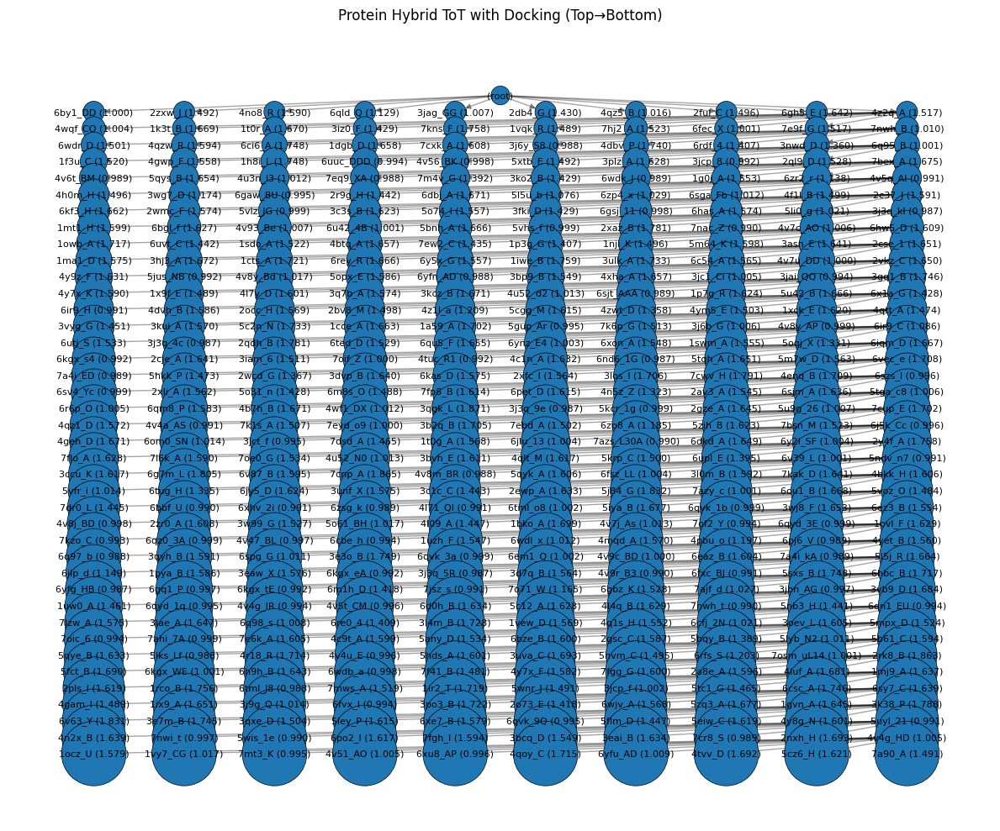


Using PDB IDs from chain IDs: receptor=101m_A, ligand=3qgk_L
Docking and rendering receptor + ligand in py3Dmol...
Fetching PDBs for docking view: receptor=101m, ligand=3qgk
Receptor CA atoms (chain A): 154
Ligand   CA atoms (chain L): 564
Using cached docking score=4.390


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [21]:
# @title
# ============================================================
# Protein ToT search using cached ESM2 embeddings + simple docking
#   - Loads ligand embeddings from a .pt file
#   - Computes ONE embedding for receptor if needed
#   - Stage 1: ESM2-based preselection of ligands (cosine + sequence heuristic)
#   - Stage 2: Tree-of-Thought search using ESM + binding + docking
#   - Uses ONLY first MODEL and primary ALTLOC from PDBs
#   - Chain IDs are matched case-insensitively (normalize to uppercase)
#   - At the end, prints ESM MLM plausibility for best ligand
#   - Visualizes receptor + ligand in a docked pose (py3Dmol)
# ============================================================

# pip install transformers accelerate torch tqdm networkx matplotlib py3Dmol requests

import os
import re
import math
import random
import gc
from dataclasses import dataclass
from typing import Dict, List, Tuple, Optional

import torch
from transformers import AutoTokenizer, AutoModel, AutoModelForMaskedLM
from tqdm.auto import tqdm
import networkx as nx
import matplotlib.pyplot as plt
import requests
import py3Dmol
import numpy as np

# ===========================
# CONFIG
# ===========================
PDB_SEQRES_PATH   = "pdb_seqres.txt"                        # your file
ESM_EMB_PATH      = "esm2_chain_embeddings_random3000.pt"   # precomputed file

RECEPTOR_ID       = "101m_A"                                # receptor chain ID
MAX_LIGANDS_TOT   = 400                                     # final ligand pool size for ToT

DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
DEFAULT_SEED = 13

# docking caches
PDB_TEXT_CACHE: Dict[str, str] = {}
CA_CACHE: Dict[str, np.ndarray] = {}
DOCK_CACHE: Dict[Tuple[str, str], Tuple[float, np.ndarray, np.ndarray]] = {}

# ===========================
# SEEDING
# ===========================
def set_seed(seed: Optional[int]):
    if seed is None:
        return
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    if torch.cuda.is_available():
        torch.cuda.manual_seed_all(seed)

# ===========================
# LOAD CACHED EMBEDDINGS
# ===========================
if not os.path.isfile(ESM_EMB_PATH):
    raise FileNotFoundError(f"{ESM_EMB_PATH} not found. Run the precompute script first.")

print(f"Loading cached embeddings from {ESM_EMB_PATH}...")
embfile = torch.load(ESM_EMB_PATH, map_location="cpu")
CHAIN_EMB: Dict[str, torch.Tensor] = embfile["embeddings"]
ESM_MODEL_NAME: str = embfile.get("model_name", "facebook/esm2_t12_35M_UR50D")
print(f"Loaded {len(CHAIN_EMB)} chain embeddings from model {ESM_MODEL_NAME}")

# ===========================
# PARSE pdb_seqres.txt
# ===========================
def parse_pdb_seqres(path: str) -> Dict[str, dict]:
    records: Dict[str, dict] = {}
    header_re = re.compile(r"^(\S+)\s+mol:(\S+)\s+length:(\d+)\s*(.*)$")

    cid: Optional[str] = None
    mol = ""
    ln = 0
    desc = ""
    seq_lines: List[str] = []

    with open(path, "r") as f:
        for line in f:
            line = line.strip()
            if not line:
                continue

            if line.startswith(">"):
                if cid is not None and seq_lines:
                    records[cid] = {
                        "mol": mol.lower(),
                        "len": ln,
                        "desc": desc,
                        "seq": "".join(seq_lines),
                    }

                m = header_re.match(line[1:])
                if m:
                    cid, mol, ln_str, desc = m.groups()
                    ln = int(ln_str)
                    seq_lines = []
                else:
                    cid = line[1:].split()[0]
                    mol = "unknown"
                    ln = 0
                    desc = ""
                    seq_lines = []
            else:
                seq_lines.append(line)

    if cid is not None and seq_lines:
        records[cid] = {
            "mol": mol.lower(),
            "len": ln,
            "desc": desc,
            "seq": "".join(seq_lines),
        }

    return records

if not os.path.isfile(PDB_SEQRES_PATH):
    raise FileNotFoundError(f"{PDB_SEQRES_PATH} not found in current directory")

print(f"Parsing {PDB_SEQRES_PATH}...")
records = parse_pdb_seqres(PDB_SEQRES_PATH)
print(f"Found {len(records)} chains total.")

if RECEPTOR_ID not in records:
    raise ValueError(f"Receptor chain {RECEPTOR_ID} not found in pdb_seqres.txt")

# ===========================
# BASIC SEQUENCE UTILS
# ===========================
AA20      = set("ACDEFGHIKLMNPQRSTVWY")
HYDRO     = set("AVILMFYW")
POLAR     = set("STNQCH")
POSITIVE  = set("KRH")
NEGATIVE  = set("DE")

def clean_protein(seq: str) -> str:
    return "".join(c for c in seq.upper() if c in AA20)

def pair_score(a: str, b: str) -> float:
    a = a.upper()
    b = b.upper()
    if (a in POSITIVE and b in NEGATIVE) or (a in NEGATIVE and b in POSITIVE):
        return 2.0
    if a in HYDRO and b in HYDRO:
        return 1.0
    if a in POLAR and b in POLAR:
        return 0.5
    if (a in POSITIVE and b in POSITIVE) or (a in NEGATIVE and b in NEGATIVE):
        return -1.0
    return -0.2

def binding_score(rec_seq: str, lig_seq: str) -> float:
    R = clean_protein(rec_seq)
    L = clean_protein(lig_seq)
    if not R or not L:
        return -1e9
    if len(L) > len(R):
        R, L = L, R

    Lr, Ll = len(R), len(L)
    best = -1e9

    for shift in range(-Ll + 1, Lr):
        sr = max(0, shift)
        sl = max(0, -shift)
        overlap = min(Lr - sr, Ll - sl)
        if overlap <= 0:
            continue

        s = 0.0
        for k in range(overlap):
            s += pair_score(R[sr + k], L[sl + k])

        s_norm = s / overlap
        len_ratio = overlap / max(Lr, Ll)
        s_norm *= (0.5 + 0.5 * len_ratio)
        best = max(best, s_norm)

    return best

def cosine_sim(a: torch.Tensor, b: torch.Tensor) -> float:
    a = a / (a.norm(p=2) + 1e-8)
    b = b / (b.norm(p=2) + 1e-8)
    return float(torch.dot(a, b).item())

# ===========================
# LOAD ESM MODELS (for receptor embed + MLM at end)
# ===========================
gc.collect()
if torch.cuda.is_available():
    torch.cuda.empty_cache()

print(f"Loading ESM models ({ESM_MODEL_NAME}) on {DEVICE}...")
esm_tok = AutoTokenizer.from_pretrained(ESM_MODEL_NAME)
esm_mdl_enc = AutoModel.from_pretrained(ESM_MODEL_NAME).to(DEVICE).eval()
esm_mdl_mlm = AutoModelForMaskedLM.from_pretrained(ESM_MODEL_NAME).to(DEVICE).eval()

@torch.no_grad()
def esm_embed(seq: str, max_len: int = 1022) -> torch.Tensor:
    seq = clean_protein(seq)
    seq = seq.strip()
    if len(seq) == 0:
        return torch.zeros(esm_mdl_enc.config.hidden_size, device=DEVICE)
    seq = seq[:max_len]
    enc = esm_tok(
        seq,
        return_tensors="pt",
        add_special_tokens=True,
        truncation=True,
        max_length=max_len + 2,
    )
    enc = {k: v.to(DEVICE) for k, v in enc.items()}
    out = esm_mdl_enc(**enc)
    reps = out.last_hidden_state
    emb = reps.mean(dim=1)[0]
    return emb

@torch.no_grad()
def mlm_plausibility(rec_seq: str, lig_seq: str, num_positions: int = 32) -> float:
    rec = clean_protein(rec_seq)
    lig = clean_protein(lig_seq)
    if not rec or not lig:
        return -10.0

    combined = rec + lig
    Lr = len(rec)
    Ll = len(lig)

    lig_positions = list(range(Lr, Lr + Ll))
    random.shuffle(lig_positions)
    positions = lig_positions[: min(num_positions, len(lig_positions))]

    enc = esm_tok(combined, return_tensors="pt", add_special_tokens=True)
    ids = enc["input_ids"].to(DEVICE)
    attn = enc["attention_mask"].to(DEVICE)
    mask_id = esm_tok.mask_token_id

    logps = []
    for pos in positions:
        tid = 1 + pos
        if tid >= ids.shape[1] - 1:
            continue
        masked = ids.clone()
        true_id = masked[0, tid].item()
        masked[0, tid] = mask_id

        out = esm_mdl_mlm(input_ids=masked, attention_mask=attn)
        logits = out.logits[0, tid]
        probs = torch.softmax(logits, dim=-1)
        p_true = probs[true_id].clamp_min(1e-12)
        logps.append(float(torch.log(p_true).item()))

    if not logps:
        return -10.0
    return sum(logps) / len(logps)

# ===========================
# TREE BOOK FOR VISUALIZATION
# ===========================
class TreeBook:
    def __init__(self):
        self.G = nx.DiGraph()
        self.next_id = 0
        self.attrs: Dict[int, Dict[str, object]] = {}
        self.info: Dict[int, Tuple[str, ...]] = {}

    def add_node(self, depth: int, label: str, info: Tuple[str, ...]) -> int:
        nid = self.next_id
        self.next_id += 1
        self.G.add_node(nid)
        self.attrs[nid] = {"depth": depth, "label": label}
        self.info[nid] = info
        return nid

    def add_edge(self, u: int, v: int):
        self.G.add_edge(u, v)

def _layered_tb(G, attrs):
    levels: Dict[int, List[int]] = {}
    for n in G.nodes():
        d = attrs[n]["depth"]
        levels.setdefault(d, []).append(n)
    pos = {}
    y_gap = 1.8
    x_gap = 1.6
    for d in sorted(levels.keys()):
        row = sorted(levels[d])
        width = (len(row) - 1) * x_gap
        for i, nid in enumerate(row):
            pos[nid] = (-width / 2 + i * x_gap, -d * y_gap)
    return pos

def plot_tree(tb: TreeBook, title="Protein ToT (Top→Bottom)"):
    if tb.G.number_of_nodes() == 0:
        print("[viz] Empty tree.")
        return
    pos = _layered_tb(tb.G, tb.attrs)
    colors, sizes, labels = [], [], {}
    for nid in tb.G.nodes():
        colors.append("#1f77b4")
        d = tb.attrs[nid]["depth"]
        sizes.append(260 + 70 * d)
        lbl = tb.attrs[nid]["label"] or "(root)"
        labels[nid] = (lbl[:42] + "…") if len(lbl) > 43 else lbl
    plt.figure(figsize=(12, 10))
    nx.draw_networkx_edges(
        tb.G, pos, alpha=0.35, arrows=True,
        arrowstyle="-|>", min_target_margin=8
    )
    nx.draw_networkx_nodes(
        tb.G, pos, node_color=colors,
        node_size=sizes, linewidths=0.5, edgecolors="k"
    )
    nx.draw_networkx_labels(tb.G, pos, labels=labels, font_size=8)
    plt.title(title)
    plt.axis("off")
    plt.tight_layout()
    plt.show()

# ===========================
# PARAMS + NODE
# ===========================
@dataclass
class P:
    max_depth: int = 5
    max_nodes: int = 1000
    branch: int = 10
    alpha_esm: float = 1.0    # ESM cosine
    beta_bind: float = 0.1    # sequence heuristic
    gamma_dock: float = 0.2   # docking score
    depth_penalty: float = 0.02

@dataclass
class Node:
    nid: int
    info: Tuple[str, ...]
    depth: int
    value: float
    parent: float

# ===========================
# PDB / GEOMETRY HELPERS
# ===========================
def fetch_pdb_text(pdb_id: str) -> str:
    """
    Robust PDB fetch: if 404 or empty, return "" instead of raising.
    This prevents crashes when some PDB IDs no longer exist.
    """
    pdb_id = pdb_id.upper()
    url = f"https://files.rcsb.org/download/{pdb_id}.pdb"
    resp = requests.get(url, timeout=30)
    if resp.status_code != 200 or not resp.text.strip():
        print(f"[WARN] Failed to download PDB {pdb_id} from RCSB (status {resp.status_code}). "
              f"Docking will be disabled for this PDB.")
        return ""
    return resp.text

def split_pdb_chain(id_str: str):
    """
    Split '4ya7_G' or '4ya7_g' into ('4ya7', 'G').
    Chain IDs in PDB files are uppercase, so we normalize to upper here.
    """
    parts = id_str.split("_", 1)
    pdb_id = parts[0]
    chain = None
    if len(parts) == 2 and parts[1]:
        chain = parts[1].strip().upper()
    return pdb_id, chain

def parse_pdb_atoms(pdb_txt: str, chain_id: str = None):
    """
    Parse ATOM/HETATM lines from the *first* MODEL only, using primary ALTLOC.
    Chain IDs are matched case-insensitively by normalizing to uppercase.
    """
    atoms = []
    if not pdb_txt:
        return atoms

    in_first_model = False
    saw_model = False
    chain_id_norm = chain_id.upper() if chain_id is not None else None

    for line in pdb_txt.splitlines():
        # MODEL handling: keep only first model
        if line.startswith("MODEL"):
            if not saw_model:
                saw_model = True
                in_first_model = True
            else:
                # Second MODEL encountered: stop reading
                break
            continue

        if line.startswith("ENDMDL") and in_first_model:
            # End of first model block
            break

        if not (line.startswith("ATOM") or line.startswith("HETATM")):
            continue

        if saw_model and not in_first_model:
            # Should not happen, but be explicit: ignore outside first model
            continue

        # Filter by chain ID (case-insensitive via uppercase)
        if chain_id_norm is not None:
            ch = line[21].upper().strip()
            if ch != chain_id_norm:
                continue

        # Filter ALTLOC: keep blank or 'A' only
        alt = line[16].strip()
        if alt not in ("", "A"):
            continue

        try:
            x = float(line[30:38])
            y = float(line[38:46])
            z = float(line[46:54])
        except ValueError:
            continue

        atoms.append({"line": line, "x": x, "y": y, "z": z})

    return atoms

def get_ca_coords(atoms):
    coords = []
    for a in atoms:
        line = a["line"]
        atom_name = line[12:16]
        if atom_name.strip() == "CA":
            coords.append([a["x"], a["y"], a["z"]])
    if not coords:
        return np.zeros((0, 3))
    return np.array(coords, dtype=np.float64)

def rebuild_pdb_with_coords(original_pdb: str, atoms_transformed_txt: str):
    transformed_lines = atoms_transformed_txt.splitlines()
    out = []
    for line in original_pdb.splitlines():
        if line.startswith("ATOM") or line.startswith("HETATM"):
            continue
        out.append(line)
    out.extend(transformed_lines)
    return "\n".join(out) + "\n"

# ===========================
# SIMPLE RIGID-BODY DOCKING
# ===========================
def get_pdb_text_cached(pdb_id: str) -> str:
    pdb_id = pdb_id.upper()
    if pdb_id in PDB_TEXT_CACHE:
        return PDB_TEXT_CACHE[pdb_id]
    txt = fetch_pdb_text(pdb_id)
    PDB_TEXT_CACHE[pdb_id] = txt
    return txt

def _sanity_check_ca(chain_id: str, ca: np.ndarray):
    if chain_id in records:
        seq_len = len(clean_protein(records[chain_id]["seq"]))
        if seq_len > 0 and ca.shape[0] > 2 * seq_len:
            print(
                f"[WARN] CA count {ca.shape[0]} for {chain_id} is > 2x seqres length {seq_len}. "
                f"Check for unusual PDB formatting (multiple models/altlocs)."
            )

def get_ca_for_chain(chain_id: str) -> np.ndarray:
    if chain_id in CA_CACHE:
        return CA_CACHE[chain_id]
    pdb_id, ch = split_pdb_chain(chain_id)
    pdb_txt = get_pdb_text_cached(pdb_id)
    if not pdb_txt:
        CA_CACHE[chain_id] = np.zeros((0, 3))
        return CA_CACHE[chain_id]
    atoms = parse_pdb_atoms(pdb_txt, chain_id=ch)
    ca = get_ca_coords(atoms)
    _sanity_check_ca(chain_id, ca)
    CA_CACHE[chain_id] = ca
    return ca

def random_rotation_matrix() -> np.ndarray:
    u1, u2, u3 = np.random.rand(3)
    q1 = math.sqrt(1-u1) * math.sin(2*math.pi*u2)
    q2 = math.sqrt(1-u1) * math.cos(2*math.pi*u2)
    q3 = math.sqrt(u1)   * math.sin(2*math.pi*u3)
    q4 = math.sqrt(u1)   * math.cos(2*math.pi*u3)
    x, y, z, w = q1, q2, q3, q4
    R = np.array([
        [1-2*(y*y+z*z),   2*(x*y - z*w),   2*(x*z + y*w)],
        [2*(x*y + z*w),   1-2*(x*x+z*z),   2*(y*z - x*w)],
        [2*(x*z - y*w),   2*(y*z + x*w),   1-2*(x*x+y*y)]
    ], dtype=float)
    return R

def interface_score(rec_ca: np.ndarray,
                    lig_ca: np.ndarray,
                    contact_cut: float = 6.0,
                    clash_cut: float = 2.0) -> Tuple[float, int, int]:
    if rec_ca.size == 0 or lig_ca.size == 0:
        return -1e9, 0, 0
    diff = rec_ca[:, None, :] - lig_ca[None, :, :]
    dist2 = np.sum(diff * diff, axis=-1)
    contacts = dist2 < contact_cut**2
    clashes  = dist2 < clash_cut**2
    n_contacts = int(contacts.sum())
    n_clashes  = int(clashes.sum())
    score = n_contacts - 10 * n_clashes
    return float(score), n_contacts, n_clashes

def search_best_docking_pose(rec_ca: np.ndarray,
                             lig_ca: np.ndarray,
                             n_poses: int = 50,
                             trans_std: float = 6.0) -> Tuple[float, np.ndarray, np.ndarray]:
    if rec_ca.size == 0 or lig_ca.size == 0:
        return -1e9, np.eye(3), np.zeros(3)

    rec_center = rec_ca.mean(axis=0)
    lig_center0 = lig_ca.mean(axis=0)

    best_score = -1e9
    best_R = np.eye(3)
    best_t = np.zeros(3)

    for _ in range(n_poses):
        R = random_rotation_matrix()
        delta = np.random.normal(scale=trans_std, size=3)
        t = rec_center + delta - R @ lig_center0
        lig_try = (R @ lig_ca.T).T + t
        score, _, _ = interface_score(rec_ca, lig_try)
        if score > best_score:
            best_score = score
            best_R = R
            best_t = t

    return float(best_score), best_R, best_t

def docking_score_cached(rec_chain_id: str,
                         lig_chain_id: str,
                         n_poses: int = 40,
                         trans_std: float = 6.0) -> float:
    key = (rec_chain_id, lig_chain_id)
    if key in DOCK_CACHE:
        return DOCK_CACHE[key][0]

    rec_ca = get_ca_for_chain(rec_chain_id)
    lig_ca = get_ca_for_chain(lig_chain_id)

    # If either CA set is empty, disable docking and return neutral score
    if rec_ca.size == 0 or lig_ca.size == 0:
        print(f"[WARN] Missing CA coordinates for docking pair {rec_chain_id} / {lig_chain_id}. "
              f"Docking score set to 0.0.")
        DOCK_CACHE[key] = (0.0, np.eye(3), np.zeros(3))
        return 0.0

    raw_score, R_best, t_best = search_best_docking_pose(
        rec_ca, lig_ca, n_poses=n_poses, trans_std=trans_std
    )
    denom = max(1.0, min(len(rec_ca), len(lig_ca)))
    norm_score = raw_score / denom
    DOCK_CACHE[key] = (norm_score, R_best, t_best)
    return norm_score

# ===========================
# ESM-BASED LIGAND PRESELECTION
# ===========================
def preselect_ligands_esmbased(
    receptor_id: str,
    rec_emb_cpu: torch.Tensor,
    records: Dict[str, dict],
    chain_emb: Dict[str, torch.Tensor],
    max_candidates: int = 2000,
    top_k: int = 400,
) -> List[str]:
    """
    Use ESM2 embedding cosine + binding_score to pick a ligand subset:
      pre_score = cos(rec, lig) + 0.1 * binding_score(rec_seq, lig_seq)
    Returns top_k ligand IDs.
    """
    rec_seq = records[receptor_id]["seq"]
    rec_emb_cpu = rec_emb_cpu.detach()

    # Initial candidate list: all protein chains with embeddings (except receptor)
    candidates = [
        cid for cid, rec in records.items()
        if cid != receptor_id and rec["mol"] == "protein" and cid in chain_emb
    ]
    if max_candidates is not None:
        candidates = candidates[:max_candidates]

    scores = []
    for cid in tqdm(candidates, desc="ESM preselect", unit="lig"):
        lig_seq = records[cid]["seq"]
        lig_emb_cpu = chain_emb[cid].detach()
        cos = cosine_sim(rec_emb_cpu, lig_emb_cpu)
        bind = binding_score(rec_seq, lig_seq)
        pre_score = cos + 0.1 * bind
        scores.append((pre_score, cid))

    scores.sort(reverse=True, key=lambda x: x[0])
    top_k_eff = min(top_k, len(scores))
    top = scores[:top_k_eff]

    print(f"\n[INFO] ESM preselection picked {top_k_eff} ligands "
          f"(from {len(candidates)} candidates). Top pre_score={top[0][0]:.3f}")
    return [cid for _, cid in top]

# ===========================
# PROTEIN ToT SEARCH
# ===========================
class ProteinToT:
    def __init__(
        self,
        receptor_id: str,
        records: Dict[str, dict],
        lig_ids: List[str],
        rec_emb: torch.Tensor,
        lig_embs: Dict[str, torch.Tensor],
        p: P,
    ):
        self.receptor_id = receptor_id
        self.records = records
        self.lig_ids = lig_ids
        self.rec_seq = records[receptor_id]["seq"]
        self.rec_emb = rec_emb
        self.lig_embs = lig_embs
        self.p = p

        self.tb = TreeBook()
        self.nodes_evaluated = 0
        self.visited_ligs = set()
        self.best_lig = None
        self.best_score = -1e9

    def _score_ligand(self, lig_id: str) -> float:
        seq = self.records[lig_id]["seq"]
        emb = self.lig_embs[lig_id]
        cos = cosine_sim(self.rec_emb, emb)
        bind = binding_score(self.rec_seq, seq)
        dock = docking_score_cached(self.receptor_id, lig_id)
        return (
            self.p.alpha_esm * cos
            + self.p.beta_bind * bind
            + self.p.gamma_dock * dock
        )

    def _value(self, score: float, depth: int) -> float:
        return score - self.p.depth_penalty * depth

    def _canon(self, infos: List[str]) -> Tuple[str, ...]:
        out, seen = [], set()
        for s in infos:
            t = s.strip()
            k = t.lower()
            if t and k not in seen:
                seen.add(k)
                out.append(t[:240])
        return tuple(sorted(out))

    def _expand(self, node: Node) -> List[Tuple[float, str, Tuple[str, ...], float]]:
        remaining = [cid for cid in self.lig_ids if cid not in self.visited_ligs]
        if not remaining:
            return []
        random.shuffle(remaining)
        kids = []
        for lig_id in remaining[: self.p.branch]:
            score = self._score_ligand(lig_id)
            val = self._value(score, node.depth + 1)
            info = self._canon(list(node.info) + [
                f"LIG={lig_id}",
                f"SCORE={score:.4f}",
            ])
            kids.append((val, lig_id, info, score))
        return kids

    def solve(self, seed: Optional[int] = DEFAULT_SEED):
        set_seed(seed)

        root_info = self._canon([f"RECEPTOR={self.receptor_id}"])
        root_nid = self.tb.add_node(depth=0, label="(root)", info=root_info)
        self.tb.attrs[root_nid]["value"] = 0.0
        root = Node(nid=root_nid, info=root_info, depth=0, value=0.0, parent=-1e9)

        stack = [root]

        print(
            f"Starting Protein ToT search over {len(self.lig_ids)} ligands "
            f"(max_nodes={self.p.max_nodes}, branch={self.p.branch})"
        )

        with tqdm(
            total=self.p.max_nodes,
            desc="Nodes",
            unit="node",
            bar_format="{l_bar}{bar}| {n_fmt}/{total_fmt} [{rate_fmt}]",
        ) as pbar:
            while stack and self.nodes_evaluated < self.p.max_nodes:
                node = stack.pop()

                if self.nodes_evaluated % 10 == 0:
                    print(
                        f"[d={node.depth}] V={node.value:.3f} "
                        f"facts={len(node.info)} "
                    )

                children = self._expand(node)
                if not children:
                    continue

                for val, lig_id, info, score in children:
                    if self.nodes_evaluated >= self.p.max_nodes:
                        break

                    self.visited_ligs.add(lig_id)
                    if score > self.best_score:
                        self.best_score = score
                        self.best_lig = lig_id

                    label = f"{lig_id} ({score:.3f})"
                    child_nid = self.tb.add_node(
                        depth=node.depth + 1,
                        label=label,
                        info=info,
                    )
                    self.tb.attrs[child_nid]["value"] = val
                    self.tb.add_edge(node.nid, child_nid)

                    child = Node(
                        nid=child_nid,
                        info=info,
                        depth=node.depth + 1,
                        value=val,
                        parent=node.value,
                    )
                    stack.append(child)

                    self.nodes_evaluated += 1
                    pbar.update(1)

        return {
            "best_ligand": self.best_lig,
            "best_score": self.best_score,
            "tree": self.tb,
            "nodes": self.nodes_evaluated,
        }

# ===========================
# DOCKING VISUALIZATION
# ===========================
def dock_and_show(receptor_id: str, ligand_id: str):
    rec_pdb, rec_chain = split_pdb_chain(receptor_id)
    lig_pdb, lig_chain = split_pdb_chain(ligand_id)

    print(f"Fetching PDBs for docking view: receptor={rec_pdb}, ligand={lig_pdb}")
    pdb_rec_txt = fetch_pdb_text(rec_pdb)
    pdb_lig_txt = fetch_pdb_text(lig_pdb)

    if not pdb_rec_txt or not pdb_lig_txt:
        print("[WARN] Missing PDB text for docking visualization. Skipping py3Dmol view.")
        return None

    rec_ca = get_ca_for_chain(receptor_id)
    lig_ca = get_ca_for_chain(ligand_id)
    print(f"Receptor CA atoms (chain {rec_chain}): {rec_ca.shape[0]}")
    print(f"Ligand   CA atoms (chain {lig_chain}): {lig_ca.shape[0]}")

    key = (receptor_id, ligand_id)
    if key in DOCK_CACHE:
        dock_score, R_best, t_best = DOCK_CACHE[key]
        print(f"Using cached docking score={dock_score:.3f}")
    else:
        raw_score, R_best, t_best = search_best_docking_pose(
            rec_ca, lig_ca, n_poses=200, trans_std=6.0
        )
        denom = max(1.0, min(len(rec_ca), len(lig_ca)))
        dock_score = raw_score / denom
        DOCK_CACHE[key] = (dock_score, R_best, t_best)
        print(f"Computed docking score={dock_score:.3f}")

    lig_atoms_all = parse_pdb_atoms(pdb_lig_txt, chain_id=lig_chain)
    transformed_lines = []
    for a in lig_atoms_all:
        v = np.array([a["x"], a["y"], a["z"]], dtype=np.float64)
        v_new = R_best @ v + t_best
        line = a["line"]
        new_line = (
            line[:30]
            + f"{v_new[0]:8.3f}{v_new[1]:8.3f}{v_new[2]:8.3f}"
            + line[54:]
        )
        transformed_lines.append(new_line)
    lig_pdb_docked = rebuild_pdb_with_coords(pdb_lig_txt, "\n".join(transformed_lines) + "\n")

    view = py3Dmol.view(width=800, height=600)

    view.addModel(pdb_rec_txt, "pdb")
    if rec_chain is not None:
        view.setStyle({"model": 0, "chain": rec_chain}, {"cartoon": {"color": "spectrum"}})
    else:
        view.setStyle({"model": 0}, {"cartoon": {"color": "spectrum"}})

    view.addModel(lig_pdb_docked, "pdb")
    if lig_chain is not None:
        view.setStyle({"model": 1, "chain": lig_chain}, {"cartoon": {"color": "cyan"}})
    else:
        view.setStyle({"model": 1}, {"cartoon": {"color": "cyan"}})

    view.zoomTo()
    return view

# ===========================
# MAIN PIPELINE
# ===========================
if __name__ == "__main__":
    print(f"\nReceptor: {RECEPTOR_ID}")
    print("  mol   :", records[RECEPTOR_ID]["mol"])
    print("  len   :", records[RECEPTOR_ID]["len"])
    print("  desc  :", records[RECEPTOR_ID]["desc"])

    # Receptor embedding on CPU for preselection
    if RECEPTOR_ID in CHAIN_EMB:
        print("Using cached embedding for receptor (CPU).")
        rec_emb_cpu = CHAIN_EMB[RECEPTOR_ID].detach()
    else:
        print("Receptor embedding not cached. Computing via ESM (GPU) then moving to CPU...")
        rec_seq_full = records[RECEPTOR_ID]["seq"]
        rec_emb_cpu = esm_embed(rec_seq_full).detach().cpu()

    # Try co-crystallized partners from same PDB first
    rec_pdb_id, _ = split_pdb_chain(RECEPTOR_ID)
    rec_pdb_id_upper = rec_pdb_id.upper()

    ligands_same_pdb = [
        cid for cid, rec in records.items()
        if cid != RECEPTOR_ID
        and rec["mol"] == "protein"
        and cid in CHAIN_EMB
        and split_pdb_chain(cid)[0].upper() == rec_pdb_id_upper
    ]

    if ligands_same_pdb:
        ligands = ligands_same_pdb
        print(f"\nLigand pool restricted to chains from same PDB ({rec_pdb_id_upper}): {len(ligands)}")
    else:
        print(f"\n[INFO] No co-crystallized protein/peptide partners found for {RECEPTOR_ID}.")
        print("       Using ESM-based preselection from global protein pool...")
        top_k = MAX_LIGANDS_TOT if MAX_LIGANDS_TOT is not None else 400
        ligands = preselect_ligands_esmbased(
            receptor_id=RECEPTOR_ID,
            rec_emb_cpu=rec_emb_cpu,
            records=records,
            chain_emb=CHAIN_EMB,
            max_candidates=2000,
            top_k=top_k,
        )

    if MAX_LIGANDS_TOT is not None and len(ligands) > MAX_LIGANDS_TOT:
        ligands = ligands[:MAX_LIGANDS_TOT]

    if not ligands:
        raise RuntimeError("No protein ligands selected for search (check preselection logic).")

    print(f"Ligand pool size (after selection): {len(ligands)}")

    # Final receptor embedding on DEVICE for ToT scoring
    rec_emb = rec_emb_cpu.to(DEVICE)

    lig_embs: Dict[str, torch.Tensor] = {
        cid: CHAIN_EMB[cid].to(DEVICE) for cid in ligands
    }

    params = P(
        max_depth=5,
        max_nodes=1000,
        branch=10,
        alpha_esm=1.0,
        beta_bind=0.1,
        gamma_dock=0.2,
        depth_penalty=0.02,
    )
    solver = ProteinToT(
        receptor_id=RECEPTOR_ID,
        records=records,
        lig_ids=ligands,
        rec_emb=rec_emb,
        lig_embs=lig_embs,
        p=params,
    )
    res = solver.solve(seed=DEFAULT_SEED)

    best_lig = res["best_ligand"]
    best_score = res["best_score"]
    tb = res["tree"]

    print("\n=== BEST LIGAND (ToT value function: ESM + binding + docking) ===")
    print("Receptor chain :", RECEPTOR_ID)
    print("Ligand chain   :", best_lig)
    print("Score (combined) :", f"{best_score:.3f}")
    if best_lig is not None:
        lig_seq_clean = clean_protein(records[best_lig]["seq"])
        print("Ligand length  :", len(lig_seq_clean))
        print("Ligand desc    :", records[best_lig]["desc"])

        rec_seq_full = records[RECEPTOR_ID]["seq"]
        lig_seq_full = records[best_lig]["seq"]
        mlm_score = mlm_plausibility(rec_seq_full, lig_seq_full)
        print("ESM MLM plausibility (log-prob avg):", f"{mlm_score:.4f}")

    print("\nNodes evaluated:", res["nodes"])
    print("Tree depth (max):", max(tb.attrs[n]["depth"] for n in tb.G.nodes()))

    print("\nPlotting search tree...")
    plot_tree(tb, title="Protein Hybrid ToT with Docking (Top→Bottom)")

    if best_lig is not None:
        print(
            f"\nUsing PDB IDs from chain IDs: receptor={RECEPTOR_ID}, ligand={best_lig}"
        )
        print("Docking and rendering receptor + ligand in py3Dmol...")
        view = dock_and_show(RECEPTOR_ID, best_lig)
        if view is not None:
            view.show()


# Visualization and Docking tools

In [6]:
import requests
import numpy as np
import py3Dmol

# ----------------- Helpers to parse ID -----------------
def split_pdb_chain(id_str: str):
    """
    '101m_A' -> ('101m', 'A')
    '101m'   -> ('101m', None)
    """
    parts = id_str.split("_", 1)
    if len(parts) == 1:
        return parts[0], None
    return parts[0], parts[1]

# ----------------- Fetch PDB text -----------------
def fetch_pdb_text(pdb_id: str) -> str:
    pdb_id = pdb_id.upper()
    url = f"https://files.rcsb.org/download/{pdb_id}.pdb"
    resp = requests.get(url, timeout=30)
    if resp.status_code != 200 or not resp.text.strip():
        raise RuntimeError(
            f"Failed to download PDB {pdb_id} from RCSB (status {resp.status_code})"
        )
    return resp.text

# ----------------- PDB parsing helpers -----------------
def parse_pdb_atoms(pdb_txt: str, chain_id: str = None):
    """
    Parse ATOM/HETATM lines.
    If chain_id is given, only keep that chain.
    Returns list of dicts with original line and coords.
    """
    atoms = []
    for line in pdb_txt.splitlines():
        if not (line.startswith("ATOM") or line.startswith("HETATM")):
            continue
        if chain_id is not None:
            ch = line[21].strip()
            if ch != chain_id:
                continue
        try:
            x = float(line[30:38])
            y = float(line[38:46])
            z = float(line[46:54])
        except ValueError:
            continue
        atoms.append({
            "line": line,
            "x": x,
            "y": y,
            "z": z,
        })
    return atoms

def get_ca_coords(atoms):
    """
    Extract Cα coordinates (as Nx3 array) from parsed atoms.
    """
    coords = []
    for a in atoms:
        line = a["line"]
        atom_name = line[12:16]
        if atom_name.strip() == "CA":
            coords.append([a["x"], a["y"], a["z"]])
    if not coords:
        return np.zeros((0, 3))
    return np.array(coords, dtype=np.float64)

def format_pdb_with_new_coords(atoms, R, t):
    """
    Apply rigid transform x -> R x + t to all atoms, return new PDB text.
    Only modifies ATOM/HETATM coordinates.
    """
    out_lines = []
    for a in atoms:
        v = np.array([a["x"], a["y"], a["z"]], dtype=np.float64)
        v_new = R @ v + t  # (3,) = (3x3) @ (3,) + (3,)

        line = a["line"]
        new_line = (
            line[:30]
            + f"{v_new[0]:8.3f}{v_new[1]:8.3f}{v_new[2]:8.3f}"
            + line[54:]
        )
        out_lines.append(new_line)
    return "\n".join(out_lines) + "\n"

def rebuild_pdb_with_coords(original_pdb: str, atoms_transformed_txt: str):
    """
    Replace ATOM/HETATM lines of original_pdb with transformed ones.
    """
    transformed_lines = atoms_transformed_txt.splitlines()
    out = []
    for line in original_pdb.splitlines():
        if line.startswith("ATOM") or line.startswith("HETATM"):
            continue
        out.append(line)
    out.extend(transformed_lines)
    return "\n".join(out) + "\n"

# ----------------- Kabsch alignment -----------------
def kabsch_align(P: np.ndarray, Q: np.ndarray):
    """
    Kabsch algorithm: find R, t that aligns Q -> P by minimizing RMSD.
    P, Q: Nx3 arrays (P = receptor coords, Q = ligand coords)
    """
    if P.shape[0] == 0 or Q.shape[0] == 0:
        raise ValueError("Empty coordinate sets for alignment.")

    n = min(P.shape[0], Q.shape[0])
    P = P[:n]
    Q = Q[:n]

    centroid_P = P.mean(axis=0)
    centroid_Q = Q.mean(axis=0)
    P_centered = P - centroid_P
    Q_centered = Q - centroid_Q

    H = Q_centered.T @ P_centered
    U, S, Vt = np.linalg.svd(H)
    R = Vt.T @ U.T

    if np.linalg.det(R) < 0:
        Vt[2, :] *= -1
        R = Vt.T @ U.T

    t = centroid_P - R @ centroid_Q
    return R, t

# ----------------- Main alignment + visualization -----------------
def align_and_show(receptor_id: str, ligand_id: str):
    """
    receptor_id, ligand_id can be:
      '101m' or '101m_A'
      '1a30' or '1a30_C'
    """
    rec_pdb, rec_chain = split_pdb_chain(receptor_id)
    lig_pdb, lig_chain = split_pdb_chain(ligand_id)

    print(f"Fetching PDBs: receptor={rec_pdb}, ligand={lig_pdb}")
    pdb_rec_txt = fetch_pdb_text(rec_pdb)
    pdb_lig_txt = fetch_pdb_text(lig_pdb)

    # atoms for alignment (chain-filtered)
    rec_atoms_align = parse_pdb_atoms(pdb_rec_txt, chain_id=rec_chain)
    lig_atoms_align = parse_pdb_atoms(pdb_lig_txt, chain_id=lig_chain)

    rec_ca = get_ca_coords(rec_atoms_align)
    lig_ca = get_ca_coords(lig_atoms_align)

    print(f"Receptor CA atoms (chain {rec_chain}): {rec_ca.shape[0]}")
    print(f"Ligand   CA atoms (chain {lig_chain}): {lig_ca.shape[0]}")

    R, t = kabsch_align(rec_ca, lig_ca)

    # For transformation, we apply R,t to ALL atoms in ligand PDB (all chains)
    lig_atoms_all = parse_pdb_atoms(pdb_lig_txt, chain_id=None)
    lig_transformed_txt = format_pdb_with_new_coords(lig_atoms_all, R, t)
    lig_pdb_aligned = rebuild_pdb_with_coords(pdb_lig_txt, lig_transformed_txt)

    # ----------------- Visualize with py3Dmol -----------------
    view = py3Dmol.view(width=800, height=600)

    # receptor
    view.addModel(pdb_rec_txt, "pdb")
    if rec_chain is not None:
        view.setStyle({"model": 0, "chain": rec_chain}, {"cartoon": {"color": "spectrum"}})
    else:
        view.setStyle({"model": 0}, {"cartoon": {"color": "spectrum"}})

    # ligand (aligned)
    view.addModel(lig_pdb_aligned, "pdb")
    if lig_chain is not None:
        view.setStyle({"model": 1, "chain": lig_chain}, {"cartoon": {"color": "cyan"}})
    else:
        view.setStyle({"model": 1}, {"cartoon": {"color": "cyan"}})

    view.zoomTo()
    view.spin(True)
    return view


In [19]:
view = align_and_show("101m_A", "1swm_A")
view.show()


Fetching PDBs for alignment: receptor=101m, ligand=1swm
Receptor CA atoms (chain A): 154
Ligand   CA atoms (chain A): 153


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [11]:
view = align_and_show("101m_A", "6kas_D")
view.show()


Fetching PDBs for alignment: receptor=101m, ligand=6kas
Receptor CA atoms (chain A): 154
Ligand   CA atoms (chain D): 146


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

# Contact score

6m0j_complex.pdb already exists, skipping download.
Wrote chain A to 6m0j_ACE2_chainA.pdb (atoms: 5007)
Wrote chain E to 6m0j_RBD_chainE.pdb (atoms: 1566)
Receptor CA shape: (598, 3)
Ligand CA shape  : (195, 3)
Native complex: score=6, contacts=6, clashes=0
Best random pose index: 79 score: 274


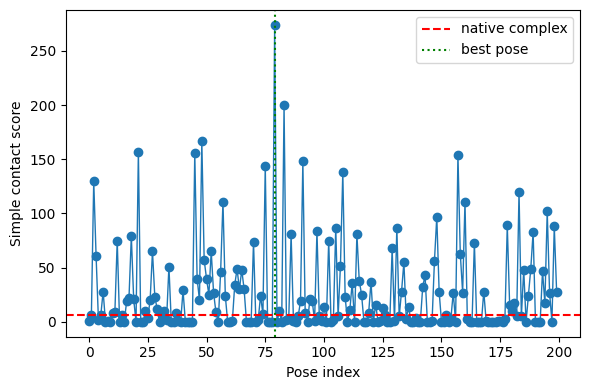

Wrote docked complex to 6m0j_ACE2_RBD_docked_simple.pdb


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [2]:
# @title
import os
import math
import requests
import numpy as np
import matplotlib.pyplot as plt

PDB_ID = "6m0j"
PDB_URL = f"https://files.rcsb.org/download/{PDB_ID.upper()}.pdb"

RECEPTOR_CHAIN = "A"   # ACE2
LIGAND_CHAIN   = "E"   # RBD

PDB_COMPLEX     = "6m0j_complex.pdb"
PDB_RECEPTOR    = "6m0j_ACE2_chainA.pdb"
PDB_LIGAND      = "6m0j_RBD_chainE.pdb"
PDB_DOCKED_OUT  = "6m0j_ACE2_RBD_docked_simple.pdb"


# ------------------------------------------------------------
# Basic PDB helpers
# ------------------------------------------------------------
def fetch_pdb(pdb_id: str, out_file: str):
    url = f"https://files.rcsb.org/download/{pdb_id.upper()}.pdb"
    print("Downloading", pdb_id, "from", url)
    r = requests.get(url, timeout=30)
    r.raise_for_status()
    with open(out_file, "w") as f:
        f.write(r.text)
    print("Saved PDB to", out_file)


def split_chain(pdb_in: str, chain_id: str, pdb_out: str):
    chain_id = chain_id.upper()
    out_lines = []
    with open(pdb_in) as f:
        for line in f:
            if line.startswith(("ATOM", "HETATM")) and len(line) > 21 and line[21] == chain_id:
                out_lines.append(line)
            elif line.startswith("TER") and len(line) > 21 and line[21] == chain_id:
                out_lines.append(line)
    out_lines.append("END\n")
    with open(pdb_out, "w") as f:
        f.writelines(out_lines)
    print(f"Wrote chain {chain_id} to {pdb_out} (atoms: {len(out_lines)-1})")


def parse_coords_all_atoms(pdb_in: str):
    coords = []
    lines = []
    with open(pdb_in) as f:
        for line in f:
            if line.startswith(("ATOM", "HETATM")):
                try:
                    x = float(line[30:38])
                    y = float(line[38:46])
                    z = float(line[46:54])
                except ValueError:
                    continue
                coords.append([x, y, z])
                lines.append(line)
    return np.array(coords, dtype=float), lines


def parse_ca_coords(pdb_in: str):
    coords = []
    with open(pdb_in) as f:
        for line in f:
            if line.startswith("ATOM") and line[12:16] == " CA ":
                try:
                    x = float(line[30:38])
                    y = float(line[38:46])
                    z = float(line[46:54])
                except ValueError:
                    continue
                coords.append([x, y, z])
    return np.array(coords, dtype=float)


# ------------------------------------------------------------
# Random rigid-body transforms
# ------------------------------------------------------------
def random_rotation_matrix():
    # random unit quaternion → 3x3 rotation
    u1, u2, u3 = np.random.rand(3)
    q1 = math.sqrt(1-u1) * math.sin(2*math.pi*u2)
    q2 = math.sqrt(1-u1) * math.cos(2*math.pi*u2)
    q3 = math.sqrt(u1)   * math.sin(2*math.pi*u3)
    q4 = math.sqrt(u1)   * math.cos(2*math.pi*u3)
    x, y, z, w = q1, q2, q3, q4
    R = np.array([
        [1-2*(y*y+z*z),   2*(x*y - z*w),   2*(x*z + y*w)],
        [2*(x*y + z*w),   1-2*(x*x+z*z),   2*(y*z - x*w)],
        [2*(x*z - y*w),   2*(y*z + x*w),   1-2*(x*x+y*y)]
    ], dtype=float)
    return R


def apply_transform(coords: np.ndarray, R: np.ndarray, t: np.ndarray):
    return coords @ R.T + t


# ------------------------------------------------------------
# Simple geometric “binding score”
# ------------------------------------------------------------
def simple_interface_score(receptor_ca: np.ndarray, ligand_ca: np.ndarray,
                           contact_cutoff: float = 6.0, clash_cutoff: float = 2.0):
    """
    Score = (#contacts within 6 Å) - 10 * (#clashes < 2 Å)
    Contacts/clashes are counted between Cα atoms.
    """
    diff = receptor_ca[:, None, :] - ligand_ca[None, :, :]
    dist2 = np.sum(diff*diff, axis=-1)

    contacts = dist2 < contact_cutoff**2
    clashes  = dist2 < clash_cutoff**2

    n_contacts = int(contacts.sum())
    n_clashes  = int(clashes.sum())
    score = n_contacts - 10 * n_clashes
    return score, n_contacts, n_clashes


def simple_random_docking(receptor_ca, ligand_ca, n_poses=200, trans_std=6.0):
    """
    Random rigid-body search over ligand poses.
    Returns scores for all poses and the best transform.
    """
    lig_center = ligand_ca.mean(axis=0, keepdims=True)
    lig_rel = ligand_ca - lig_center

    scores = []
    poses = []

    for k in range(n_poses):
        R = random_rotation_matrix()
        t = np.random.normal(scale=trans_std, size=(1,3))
        lig_try = lig_rel @ R.T + t + lig_center
        sc, nc, nl = simple_interface_score(receptor_ca, lig_try)
        scores.append(sc)
        poses.append((R, t))

    scores = np.array(scores)
    best_idx = int(np.argmax(scores))
    best_R, best_t = poses[best_idx]
    return scores, best_idx, best_R, best_t


# ------------------------------------------------------------
# Write a combined PDB for best pose
# ------------------------------------------------------------
def write_combined_pdb(receptor_lines, ligand_lines, ligand_coords_new, pdb_out):
    with open(pdb_out, "w") as f:
        # receptor as-is
        for line in receptor_lines:
            if line.startswith(("ATOM", "HETATM", "TER")):
                f.write(line)
        f.write("TER\n")

        # ligand with updated coordinates
        i = 0
        for line in ligand_lines:
            if not line.startswith(("ATOM", "HETATM")):
                continue
            x, y, z = ligand_coords_new[i]
            new_line = (
                line[:30] +
                f"{x:8.3f}{y:8.3f}{z:8.3f}" +
                line[54:]
            )
            f.write(new_line)
            i += 1
        f.write("END\n")
    print("Wrote docked complex to", pdb_out)


# ------------------------------------------------------------
# Main
# ------------------------------------------------------------
def main():
    # 1) Get PDB and split chains
    if not os.path.exists(PDB_COMPLEX):
        fetch_pdb(PDB_ID, PDB_COMPLEX)
    else:
        print(PDB_COMPLEX, "already exists, skipping download.")

    split_chain(PDB_COMPLEX, RECEPTOR_CHAIN, PDB_RECEPTOR)
    split_chain(PDB_COMPLEX, LIGAND_CHAIN, PDB_LIGAND)

    # 2) Parse Cα coordinates
    receptor_ca = parse_ca_coords(PDB_RECEPTOR)
    ligand_ca   = parse_ca_coords(PDB_LIGAND)
    print("Receptor CA shape:", receptor_ca.shape)
    print("Ligand CA shape  :", ligand_ca.shape)

    # 3) Score the native complex
    base_score, base_contacts, base_clashes = simple_interface_score(receptor_ca, ligand_ca)
    print(f"Native complex: score={base_score}, contacts={base_contacts}, clashes={base_clashes}")

    # 4) Random docking search
    scores, best_idx, best_R, best_t = simple_random_docking(
        receptor_ca, ligand_ca,
        n_poses=200,
        trans_std=6.0
    )
    print("Best random pose index:", best_idx, "score:", scores[best_idx])

    # 5) Plot scores
    plt.figure(figsize=(6,4))
    plt.plot(scores, marker="o", linestyle="-", linewidth=1)
    plt.axhline(base_score, color="red", linestyle="--", label="native complex")
    plt.axvline(best_idx, color="green", linestyle=":", label="best pose")
    plt.xlabel("Pose index")
    plt.ylabel("Simple contact score")
    plt.legend()
    plt.tight_layout()
    plt.show()

    # 6) Apply best transform to all ligand atoms and write combined PDB
    receptor_all, receptor_lines = parse_coords_all_atoms(PDB_RECEPTOR)
    ligand_all, ligand_lines     = parse_coords_all_atoms(PDB_LIGAND)

    lig_center_all = ligand_all.mean(axis=0, keepdims=True)
    lig_rel_all    = ligand_all - lig_center_all
    ligand_all_new = lig_rel_all @ best_R.T + best_t + lig_center_all

    write_combined_pdb(receptor_lines, ligand_lines, ligand_all_new, PDB_DOCKED_OUT)

    # 7) Optional: 3D view with py3Dmol (if available)
    try:
        import py3Dmol
        view = py3Dmol.view(width=900, height=600)
        view.addModel(open(PDB_DOCKED_OUT).read(), "pdb")
        view.setStyle({"chain": "A"}, {"cartoon": {"color": "spectrum"}})
        view.setStyle({"chain": "E"}, {"cartoon": {"color": "cyan"}})
        view.zoomTo()
        view.show()
    except Exception as e:
        print("3D visualization skipped (py3Dmol not available or failed):", e)


if __name__ == "__main__":
    main()


Saved PDB to 101m_full.pdb
Saved PDB to 1swm_full.pdb
Wrote chain A of 101m_full.pdb to 101m_A.pdb (atoms: 1414)
Wrote chain A of 1swm_full.pdb to 1swm_A.pdb (atoms: 1392)
Receptor CA shape: (154, 3)
Ligand CA shape  : (153, 3)
Baseline contact pose: score=284, contacts=544, clashes=26
Best random pose index: 63 score: 331


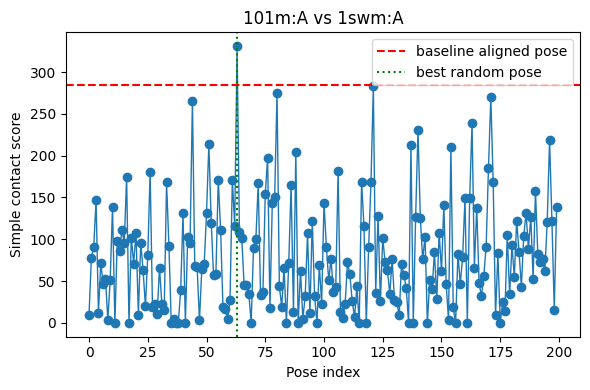

Wrote docked complex to 101m_1swm_docked_simple.pdb


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

Result summary: {'scores': array([ 10,  78,  91, 147,  12,  72,  47,  53,   4,  51, 139,   0,  98,
        86, 111,  96, 175,   0, 102,  71, 108,  10,  96,  63,  20,  81,
       181,  19,  22,  11,  66,  22,  15, 168,  92,   0,   5,   0,   0,
        39, 131,   0, 103,  95, 266,  68,  67,   3,  65,  70, 131, 214,
       120,  57,  59, 171, 111,  19,  17,   5,  27, 171, 116, 331, 109,
       102,  45,  45,  35,   0,  90, 100, 167,  33,  37, 154, 197,  18,
       144, 150, 275,  44,  19,  66,   0,  72, 165,  13, 204,   0,  62,
         5,  32, 107,  12, 122,  32,   0,  69,  23, 144,  91,  51,  76,
        37,  43, 182,  13,   6,  23,  73,  58,  26,   7,  44,   0, 169,
       116,   0,  91, 169, 283,  36, 128,  26, 101,  73,  63,  35,  76,
        27,  25,   9,  71,  57,  42,   0, 213,   0, 127, 231, 125,  76,
       103,   0,  51,  40,  85,  29, 108,  62, 141,  46,   3, 210,  19,
         0,  82,  47,  79, 149,   0, 149, 239,  66, 138,  48,  32,  56,
        91, 185, 270, 168,   9,  83, 

In [3]:
# @title
import os
import math
import requests
import numpy as np
import matplotlib.pyplot as plt

# ------------------------------------------------------------
# Basic PDB helpers
# ------------------------------------------------------------
def fetch_pdb(pdb_id: str, out_file: str):
    url = f"https://files.rcsb.org/download/{pdb_id.upper()}.pdb"
    print("Downloading", pdb_id, "from", url)
    r = requests.get(url, timeout=30)
    r.raise_for_status()
    with open(out_file, "w") as f:
        f.write(r.text)
    print("Saved PDB to", out_file)


def extract_chain(pdb_in: str, chain_id: str, pdb_out: str):
    chain_id = chain_id.upper()
    out_lines = []
    with open(pdb_in) as f:
        for line in f:
            if line.startswith(("ATOM", "HETATM")) and len(line) > 21 and line[21] == chain_id:
                out_lines.append(line)
            elif line.startswith("TER") and len(line) > 21 and line[21] == chain_id:
                out_lines.append(line)
    out_lines.append("END\n")
    with open(pdb_out, "w") as f:
        f.writelines(out_lines)
    print(f"Wrote chain {chain_id} of {os.path.basename(pdb_in)} to {pdb_out} (atoms: {len(out_lines)-1})")


def parse_ca_coords(pdb_in: str):
    coords = []
    with open(pdb_in) as f:
        for line in f:
            if line.startswith("ATOM") and line[12:16] == " CA ":
                try:
                    x = float(line[30:38])
                    y = float(line[38:46])
                    z = float(line[46:54])
                except ValueError:
                    continue
                coords.append([x, y, z])
    return np.array(coords, dtype=float)


def parse_all_atom_coords_and_lines(pdb_in: str):
    coords = []
    lines = []
    with open(pdb_in) as f:
        for line in f:
            if line.startswith(("ATOM", "HETATM")):
                try:
                    x = float(line[30:38])
                    y = float(line[38:46])
                    z = float(line[46:54])
                except ValueError:
                    continue
                coords.append([x, y, z])
                lines.append(line)
    return np.array(coords, dtype=float), lines


# ------------------------------------------------------------
# Random rigid-body transforms
# ------------------------------------------------------------
def random_rotation_matrix():
    u1, u2, u3 = np.random.rand(3)
    q1 = math.sqrt(1-u1) * math.sin(2*math.pi*u2)
    q2 = math.sqrt(1-u1) * math.cos(2*math.pi*u2)
    q3 = math.sqrt(u1)   * math.sin(2*math.pi*u3)
    q4 = math.sqrt(u1)   * math.cos(2*math.pi*u3)
    x, y, z, w = q1, q2, q3, q4
    R = np.array([
        [1-2*(y*y+z*z),   2*(x*y - z*w),   2*(x*z + y*w)],
        [2*(x*y + z*w),   1-2*(x*x+z*z),   2*(y*z - x*w)],
        [2*(x*z - y*w),   2*(y*z + x*w),   1-2*(x*x+y*y)]
    ], dtype=float)
    return R


def apply_transform(coords: np.ndarray, R: np.ndarray, t: np.ndarray):
    return coords @ R.T + t


# ------------------------------------------------------------
# Simple geometric “binding score”
# ------------------------------------------------------------
def simple_interface_score(receptor_ca: np.ndarray, ligand_ca: np.ndarray,
                           contact_cutoff: float = 6.0, clash_cutoff: float = 2.0):
    """
    Score = (#contacts within contact_cutoff) - 10 * (#clashes < clash_cutoff)
    using CA–CA distances.
    """
    diff = receptor_ca[:, None, :] - ligand_ca[None, :, :]
    dist2 = np.sum(diff*diff, axis=-1)

    contacts = dist2 < contact_cutoff**2
    clashes  = dist2 < clash_cutoff**2

    n_contacts = int(contacts.sum())
    n_clashes  = int(clashes.sum())
    score = n_contacts - 10 * n_clashes
    return score, n_contacts, n_clashes


def simple_random_docking(receptor_ca, ligand_ca, n_poses=200, trans_std=6.0):
    """
    Random rigid-body search over ligand poses.
    Returns scores for all poses and the best transform.
    """
    lig_center = ligand_ca.mean(axis=0, keepdims=True)
    lig_rel = ligand_ca - lig_center

    scores = []
    poses = []

    for k in range(n_poses):
        R = random_rotation_matrix()
        t = np.random.normal(scale=trans_std, size=(1,3))
        lig_try = lig_rel @ R.T + t + lig_center
        sc, _, _ = simple_interface_score(receptor_ca, lig_try)
        scores.append(sc)
        poses.append((R, t))

    scores = np.array(scores)
    best_idx = int(np.argmax(scores))
    best_R, best_t = poses[best_idx]
    return scores, best_idx, best_R, best_t


# ------------------------------------------------------------
# Write combined PDB
# ------------------------------------------------------------
def write_combined_pdb(receptor_lines, ligand_lines, ligand_coords_new, pdb_out):
    with open(pdb_out, "w") as f:
        # receptor as-is
        for line in receptor_lines:
            if line.startswith(("ATOM", "HETATM", "TER")):
                f.write(line)
        f.write("TER\n")
        # ligand with updated coordinates
        i = 0
        for line in ligand_lines:
            if not line.startswith(("ATOM", "HETATM")):
                continue
            x, y, z = ligand_coords_new[i]
            new_line = (
                line[:30] +
                f"{x:8.3f}{y:8.3f}{z:8.3f}" +
                line[54:]
            )
            f.write(new_line)
            i += 1
        f.write("END\n")
    print("Wrote docked complex to", pdb_out)


# ------------------------------------------------------------
# Main comparison function
# ------------------------------------------------------------
def compare_structures_with_simple_docking(
    receptor_pdb_id: str,
    ligand_pdb_id: str,
    receptor_chain: str = "A",
    ligand_chain: str = "A",
    n_poses: int = 200,
    trans_std: float = 6.0,
):
    """
    Download two PDBs (receptor_pdb_id, ligand_pdb_id),
    extract given chains, run simple random docking, and plot scores.
    """
    receptor_pdb = f"{receptor_pdb_id}_full.pdb"
    ligand_pdb   = f"{ligand_pdb_id}_full.pdb"
    receptor_chain_pdb = f"{receptor_pdb_id}_{receptor_chain}.pdb"
    ligand_chain_pdb   = f"{ligand_pdb_id}_{ligand_chain}.pdb"
    combined_out = f"{receptor_pdb_id}_{ligand_pdb_id}_docked_simple.pdb"

    # 1) Download (if needed)
    if not os.path.exists(receptor_pdb):
        fetch_pdb(receptor_pdb_id, receptor_pdb)
    else:
        print(receptor_pdb, "already exists, skipping download.")
    if not os.path.exists(ligand_pdb):
        fetch_pdb(ligand_pdb_id, ligand_pdb)
    else:
        print(ligand_pdb, "already exists, skipping download.")

    # 2) Extract chains
    extract_chain(receptor_pdb, receptor_chain, receptor_chain_pdb)
    extract_chain(ligand_pdb, ligand_chain, ligand_chain_pdb)

    # 3) Parse Cα coords
    receptor_ca = parse_ca_coords(receptor_chain_pdb)
    ligand_ca   = parse_ca_coords(ligand_chain_pdb)
    print("Receptor CA shape:", receptor_ca.shape)
    print("Ligand CA shape  :", ligand_ca.shape)

    # 4) Define a "baseline" pose:
    #    place ligand center on receptor center, no rotation
    rec_center = receptor_ca.mean(axis=0, keepdims=True)
    lig_center = ligand_ca.mean(axis=0, keepdims=True)
    ligand_aligned = ligand_ca - lig_center + rec_center
    base_score, base_contacts, base_clashes = simple_interface_score(receptor_ca, ligand_aligned)
    print(f"Baseline contact pose: score={base_score}, contacts={base_contacts}, clashes={base_clashes}")

    # 5) Random docking
    scores, best_idx, best_R, best_t = simple_random_docking(
        receptor_ca, ligand_ca,
        n_poses=n_poses,
        trans_std=trans_std
    )
    print("Best random pose index:", best_idx, "score:", scores[best_idx])

    # 6) Plot scores
    plt.figure(figsize=(6,4))
    plt.plot(scores, marker="o", linestyle="-", linewidth=1)
    plt.axhline(base_score, color="red", linestyle="--", label="baseline aligned pose")
    plt.axvline(best_idx, color="green", linestyle=":", label="best random pose")
    plt.xlabel("Pose index")
    plt.ylabel("Simple contact score")
    plt.title(f"{receptor_pdb_id}:{receptor_chain} vs {ligand_pdb_id}:{ligand_chain}")
    plt.legend()
    plt.tight_layout()
    plt.show()

    # 7) Build combined PDB for best pose
    rec_all, rec_lines = parse_all_atom_coords_and_lines(receptor_chain_pdb)
    lig_all, lig_lines = parse_all_atom_coords_and_lines(ligand_chain_pdb)

    lig_center_all = lig_all.mean(axis=0, keepdims=True)
    lig_rel_all    = lig_all - lig_center_all
    lig_all_new    = lig_rel_all @ best_R.T + best_t + lig_center_all

    write_combined_pdb(rec_lines, lig_lines, lig_all_new, combined_out)

    # 8) Optional 3D view
    try:
        import py3Dmol
        v = py3Dmol.view(width=900, height=600)
        v.addModel(open(combined_out).read(), "pdb")
        v.setStyle({"chain": receptor_chain}, {"cartoon": {"color": "spectrum"}})
        v.setStyle({"chain": ligand_chain},   {"cartoon": {"color": "cyan"}})
        v.zoomTo()
        v.show()
    except Exception as e:
        print("3D visualization skipped (py3Dmol not available or failed):", e)

    return {
        "scores": scores,
        "best_index": best_idx,
        "best_score": scores[best_idx],
        "baseline_score": base_score,
        "combined_pdb": combined_out,
    }


# ------------------------------------------------------------
# Example usage:
# ------------------------------------------------------------
if __name__ == "__main__":
    # Example with your suggestion: "101m" and "1swm", chain A for both.
    result = compare_structures_with_simple_docking(
        receptor_pdb_id="101m",
        ligand_pdb_id="1swm",
        receptor_chain="A",
        ligand_chain="A",
        n_poses=200,
        trans_std=6.0,
    )
    print("Result summary:", result)


In [2]:
pip install meeko vina py3Dmol requests

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 294.0/294.0 kB 11.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.9/6.9 MB 111.6 MB/s eta 0:00:00


In [2]:
pip install py3Dmol

In [3]:
pip install biopython

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.2/3.2 MB 64.0 MB/s eta 0:00:00


In [4]:
pip install backoff

In [52]:
pip install lightdock

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 48.8/48.8 MB 8.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 270.1/270.1 kB 18.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 37.5/37.5 MB 14.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 103.1/103.1 kB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.2/3.2 MB 66.4 MB/s eta 0:00:00
  Created wheel for lightdock: filename=lightdock-0.9.4-cp312-cp312-linux_x86_64.whl size=51771375 sha256=c7bc204e6fffba2d6d0d49da613b56f0c7530da4a065987363f3a65d672bb46d
  Stored in directory: /root/.cache/pip/wheels/67/46/0e/31c6049ed350b877466a81b8896ce5ff44fa2af22b005d708c
  Created wheel for freesasa: filename=freesasa-2.2.1-cp312-cp312-linux_x86_64.whl size=951905 sha256=54e40a5e86f9ad7f23ed4048f49de8967a5e692506a96679907ab6822ce467c2
  Stored in directory: /root/.cache/pip/wheels/d5/ba/ad/c7be874883ac321912d0

In [6]:
pip install vina

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.9/6.9 MB 13.0 MB/s eta 0:00:00
